In [1]:
#import PyHeston # The PyHeston package must be installed.
import numpy
import itertools

#from BlackScholes import *
from random import Random
from numpy import *
from scipy import *
from time import *
from datetime import *
import numpy as np
import sys
import csv
import math

from sklearn import gaussian_process
from sklearn.gaussian_process.kernels import Matern, WhiteKernel, ConstantKernel, RBF
from numpy.core.umath_tests import matrix_multiply

import matplotlib.pyplot as plt
plt.style.use('ggplot')
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import scipy as sp


from random import Random
from numpy import *
from time import *
from datetime import *
#from BlackScholes import *
import math
import scipy as sp

import matplotlib.pyplot as plt
from sklearn import gaussian_process
from sklearn.gaussian_process.kernels import Matern, WhiteKernel, ConstantKernel, RBF

%matplotlib inline
%load_ext autoreload
%autoreload 2

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.


# Load modules and external files

You need to import four python scripts for implied volatility calibration :
- *newton.py*
- *BSImplVol.py*
- *BS.py*
- *Bisect.py*

In [2]:
import pandas as pd
import numpy as np
import scipy.integrate as integrate
from scipy import interpolate
import math
import matplotlib.pyplot as plt

import tensorflow as tf
from io import StringIO

plt.style.use('ggplot')
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
import sklearn as skl
from sklearn import preprocessing
import importlib
import scipy.stats as st
import numpy as np
import math
import scipy.stats as st
import matplotlib.ticker as mtick
import time
from scipy import interpolate

In [3]:
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [385]:
#Load python files to google colaborative environment
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

ModuleNotFoundError: No module named 'google.colab'

In [4]:
from BS import bsformula
from Bisect import bisect
from newton import newton
from BSImplVol import bsimpvol

# Load data with google colab 

#### From excel file :

You will find in github repository six days of data.
For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.

In [15]:
#Load csv files to get data
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  

ModuleNotFoundError: No module named 'google.colab'

In [6]:
workingFolder = "./09082001/"

In [7]:
#Read csv files as dataFrames
zeroCouponCurve = pd.read_csv(workingFolder + "discount.csv",decimal=".").apply(pd.to_numeric)
dividendCurve = pd.read_csv(workingFolder + "dividend.csv",decimal=".").apply(pd.to_numeric)
trainingData = pd.read_csv(workingFolder + "dataTrain.csv",decimal=".").apply(pd.to_numeric)
testingData = pd.read_csv(workingFolder + "dataTest.csv",decimal=".").apply(pd.to_numeric)
underlyingNative = pd.read_csv(workingFolder + "underlying.csv",decimal=".").apply(pd.to_numeric)
localVolatilityNative = pd.read_csv(workingFolder + "locvol.csv",decimal=".").apply(pd.to_numeric)


In [8]:
def parseDatFile(fileName):
  s = open(fileName).read()
  
  defPos=s.find("[option]")
  finPos=s.find("[dividend]")
  df = pd.read_csv(StringIO(s[defPos:finPos].replace("\n\n",";").replace("\n",",").replace(";",";\n")),decimal=".", sep=",", header=None)
  
  matC = pd.to_numeric(df[1].str.split(pat="= ", expand=True)[1]).round(3)
  strikeC = pd.to_numeric(df[3].str.split(pat="= ", expand=True)[1]).round()
  priceC = pd.to_numeric(df[4].str.replace(";","").str.split(pat="= ", expand=True)[1])
  typeC = pd.to_numeric(df[2].str.split(pat="= ", expand=True)[1])
  formattedDat = pd.DataFrame([matC, strikeC, priceC, typeC], index = ["Maturity", "Strike", "Price", "Type"]).transpose().astype({"Type":"int32"})
  
  filteredDat = formattedDat[formattedDat["Type"]==2]
  return filteredDat
filteredDat = parseDatFile(workingFolder + "9_8_2001__filterdax.dat")

#### From Dat files

In [6]:
def parseModelParamDatFile(fileName):
    s = open(fileName).read()
    
    parts = s.split("\n\n")
    number1 = parts[0]
    repo = parts[1]
    dates = parts[2]
    interestRates = parts[3]
    dividendRates = parts[4]
    
    number2 = parts[5]
    number3 = parts[6]
    
    n = parts[7]
    sigmaRef = parts[8]
    h = parts[9]
    sigmaMax = parts[10]
    sigmaMin = parts[11]
    
    number4 = parts[12]
    underlying = parts[13]
    
    def splitRow(row):
        return np.array(row.split("\t")).astype(np.float)
    
    tree = ("\n".join(parts[14:])).split("\n")
    tree.remove("")
    formattedTree = np.reshape(np.array(list(map(splitRow, tree))), (-1,3))
    
    
    return pd.DataFrame(formattedTree, columns = ["date", "stock(%)", "vol"])
    

In [7]:
def parseImpliedVolDatFile(fileName):
    s = open(fileName).read()
    
    parts = s.split("\n\n")
    
    def splitRow(row):
        return np.array(row.split("\t")).astype(np.float)
    
    testGrid = ("\n".join(parts)).split("\n")
    testGrid.remove("")
    formattedTestGrid = np.reshape(np.array(list(map(splitRow, testGrid))), (-1,4))
    
    return pd.DataFrame(formattedTestGrid, columns=["Strike","Maturity","Implied vol.","Option price"])

In [16]:
def parseCalibrOutDatFile(fileName):
    s = open(fileName).read()
    
    parts = s.split("\n")
    
    def splitRow(row):
        return np.array(row.split("\t"))
    def filterRow(row):
        return len(row)==10
    def formatRow(row):
        return row.astype(np.float)
    
    #tree = ("\n".join(parts)).split("\n")
    #tree.remove("")
    filteredTrainingData = list(filter(filterRow , 
                                       list(map(splitRow, parts))))
    formattedTrainingData = np.array(list(map(formatRow, filteredTrainingData)))
    
    colNames = ["Active", "Option\ntype", "Maturity", "Strike", "Moneyness", 
                "Option\nprice", "Implied\nvol.", "Calibrated\nvol.","Market vol. -\nCalibrated vol.","MarketPrice"]
    dfTrainingData = pd.DataFrame(formattedTrainingData, columns = colNames)
    dfTrainingData["Active"] = dfTrainingData["Active"].astype(np.int) 
    dfTrainingData["Option\ntype"] = dfTrainingData["Option\ntype"].astype(np.int) 
    return dfTrainingData

In [9]:
def parseDatFiles(fileName):
    s = open(fileName).read()
    
    posUnderlying = s.find("[underlying]")
    posZeroCoupon = s.find("[zero_coupon]")
    posOption = s.find("[option]")
    posDividend = s.find("[dividend]")
    
    underlyingString = s[posUnderlying:posZeroCoupon]
    zeroCouponString = s[posZeroCoupon:posOption]
    optionString = s[posOption:posDividend]
    dividendString = s[posDividend:-2] 
    
    def extractData(subStr, tag):
        parts = subStr.replace(tag + "\n", "").split("\n\n")
        try :
            parts.remove("")
        except ValueError:
            #Not found, we continue
            pass
        
        def parseRow(row):
            return (int(row.split(" = ")[1]) if (row.split(" = ")[0] == "type") else float(row.split(" = ")[1]))
        
        def splitRow(row):
            table = np.array(row.split("\n"))
            parseTable = np.array(list(map(parseRow, table)))
            return np.reshape(parseTable, (-1))
        
        return np.array(list(map(splitRow, parts)))
    
    
    underlying = pd.DataFrame(extractData(underlyingString, "[underlying]"), 
                              columns=["S","Repo"])
    zeroCoupon = pd.DataFrame(extractData(zeroCouponString, "[zero_coupon] "), 
                              columns=["Maturity","Price"])
    option = pd.DataFrame(extractData(optionString, "[option] "), 
                          columns=["Maturity","Type", "Price", "Strike"])
    option["Type"] = option["Type"].astype(np.int) 
    dividend = pd.DataFrame(extractData(dividendString, "[dividend] "), 
                            columns=["Maturity","Amount"])
    return underlying, zeroCoupon, dividend, option

In [10]:
localVolatilityNative = parseModelParamDatFile(workingFolder + "8_8_2001__filterdax.dat.modelparam.dat")
#localVolatilityNative = parseModelParamDatFile("./esx/30_11_1999__filteresx.dat.modelparam.dat")

In [11]:
testingData = parseImpliedVolDatFile(workingFolder + "8_8_2001__filterdax.dat.impliedvol.dat")
#testingData = parseImpliedVolDatFile("./esx/30_11_1999__filteresx.dat.impliedvol.dat")

In [48]:
trainingData = parseCalibrOutDatFile(workingFolder + "8_8_2001__filterdax.dat.calibr.out.dat")
#trainingData = parseCalibrOutDatFile("./esx/30_11_1999__filteresx.dat.calibr.out.dat")

In [13]:
underlyingNative, zeroCouponCurve, dividendCurve, filteredDat = parseDatFiles(workingFolder + "8_8_2001__filterdax.dat")
#underlyingNative, zeroCouponCurve, dividendCurve, filteredDat = parseDatFiles("./esx/30_11_1999__filteresx.dat")

In [ ]:
#trainingData8 = parseCalibrOutDatFile("./esx/8_8_2001__filterdax.dat.calibr.out.dat")
#trainingData9 = parseCalibrOutDatFile("./esx/9_8_2001__filterdax.dat.calibr.out.dat")
#trainingData7 = parseCalibrOutDatFile("./esx/7_8_2001__filterdax.dat.calibr.out.dat")
#trainingData = parseCalibrOutDatFile("./esx/30_11_1999__filteresx.dat.calibr.out.dat")

In [22]:
def rmse(a,b):
    return np.sqrt(np.mean(np.square(a-b)))

In [49]:
#f08082001 = trainingData8[trainingData8["Option\ntype"]==2][trainingData8["Active"]==1]
#rmse(f08082001["Option\nprice"], f08082001["MarketPrice"])

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


2.6675900640840657

In [50]:
#f09082001 = trainingData9[trainingData9["Option\ntype"]==2][trainingData9["Active"]==1]
#rmse(trainingData9["Option\nprice"], trainingData9["MarketPrice"])

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


2.4207935408017573

In [52]:
#f07082001 = trainingData7[trainingData7["Option\ntype"]==2][trainingData7["Active"]==1]
#rmse(trainingData7["Option\nprice"], trainingData7["MarketPrice"])

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


2.4549281750072556

#### Cleaning datasets

In [9]:
#Format dividend curve as a Pandas series
dividendDf = dividendCurve.set_index('Maturity').sort_index()
dividendDf.loc[1.0] = 0.0
dividendDf.sort_index(inplace=True)
dividendDf.tail()

,Amount
Maturity,
0.194521,-0.477582
0.367237,1.409825
0.597374,3.197064
0.865753,-6.673053
1.000000,0.000000


In [10]:
#Format zero coupon curve as a Pandas series
rateCurveDf = zeroCouponCurve.set_index('Maturity').sort_index()
# keep only rates expriring before 1 year
rateCurveDf = rateCurveDf.loc[rateCurveDf.index <= 1.01]
rateCurveDf.head()

,Price
Maturity,
0.083333,0.996229
0.166667,0.992529
0.250000,0.988958
0.333333,0.985649
0.416667,0.982210


In [11]:
localVolatilityNative.head()

,date,stock(%),vol
0,0.0000,1.000000,0.342450
1,NaN,NaN,NaN
2,0.0075,0.937646,0.300538
3,0.0075,1.000284,0.328570
4,0.0075,1.067106,0.239878


In [12]:
#Format local volatility
localVolatility = localVolatilityNative.dropna()
localVolatility["Strike"] = localVolatility["stock(%)"] * underlyingNative["S"].values
localVolatility["date"] = localVolatility["date"].round(decimals=3)
renameDict = {"date": "Maturity", 
              "vol" : "LocalVolatility", 
              "stock(%)" : "StrikePercentage"}
localVolatility = localVolatility.rename(columns=renameDict).set_index(["Strike", "Maturity"])
localVolatility.head()

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,,StrikePercentage,LocalVolatility
Strike,Maturity,,
5512.280000,0.000,1.000000,0.342450
5168.567293,0.008,0.937646,0.300538
5513.845488,0.008,1.000284,0.328570
5882.187062,0.008,1.067106,0.239878
4846.286330,0.015,0.879180,0.296626


In [13]:
localVolatility.head()

,,StrikePercentage,LocalVolatility
Strike,Maturity,,
5512.280000,0.000,1.000000,0.342450
5168.567293,0.008,0.937646,0.300538
5513.845488,0.008,1.000284,0.328570
5882.187062,0.008,1.067106,0.239878
4846.286330,0.015,0.879180,0.296626


In [14]:
underlyingNative.head()

,S,Repo
0,5512.28,0


In [15]:
testingData.head()

,Strike,Maturity,Implied vol.,Option price,Implied delta,Implied gamma,Implied theta,Local delta,Local gamma
0,3858.60,0.2,0.339063,1687.99,0.993180,0.000022,44.8686,0.990149,0.000035
1,4032.67,0.2,0.326563,1516.93,0.988121,0.000037,74.4164,0.983204,0.000059
2,4206.74,0.2,0.317188,1347.45,0.978842,0.000064,123.4740,0.970013,0.000101
3,4380.81,0.2,0.307031,1179.82,0.964094,0.000103,192.9930,0.950657,0.000157
4,4554.88,0.2,0.291797,1013.92,0.944110,0.000156,276.3720,0.925519,0.000225


In [16]:
#Treatment for training data
filteredTestingData = testingData[(testingData["Implied vol."] > 0) * (testingData["Option price"] > 0)]
filteredTestingData["Maturity"] = filteredTestingData["Maturity"].round(decimals=3)
renameDict = {"Implied vol.": "ImpliedVol", 
              "Option price" : "Price", 
              "Implied delta" : "ImpliedDelta", 
              "Implied gamma" : "ImpliedGamma",
              "Implied theta" : "ImpliedTheta",
              "Local delta" : "LocalDelta",
              "Local gamma" : "LocalGamma"}
formattedTestingData = filteredTestingData.rename(columns=renameDict).set_index(["Strike", "Maturity"])["ImpliedVol"]
formattedTestingData.head()

/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


Strike   Maturity
3858.60  0.2         0.339063
4032.67  0.2         0.326563
4206.74  0.2         0.317188
4380.81  0.2         0.307031
4554.88  0.2         0.291797
Name: ImpliedVol, dtype: float64

In [17]:
trainingData.head()

,Active,Option type,Maturity,Strike,Moneyness,Option price,Implied vol.,Calibrated vol.,Market vol. - Calibrated vol.
0,1,1,0.118,3800,0.689,1730.528,0.425,-1.000,1.425
1,1,2,0.118,3800,0.689,0.410,0.398,0.388,0.011
2,1,1,0.118,3900,0.708,1631.349,0.402,0.381,0.020
3,1,2,0.118,3900,0.708,0.702,0.388,0.381,0.006
4,1,1,0.118,4000,0.726,1532.171,0.388,0.369,0.019


In [18]:
#Treatment for testing data
filteredTrainingData = trainingData[(trainingData["Calibrated\nvol."] > 0) * (trainingData["Option\nprice"] > 0) * (trainingData["Option\ntype"] == 2)]
filteredTrainingData["Maturity"] = filteredTrainingData["Maturity"].round(decimals=3)
renameDict = {"Option\ntype" : "OptionType", 
              "Option\nprice" : "Price", 
              "Calibrated\nvol." : "ImpliedVol",#"LocalImpliedVol", 
              "Implied\nvol." : "LocalImpliedVol"}#"ImpliedVol"}
formattedTrainingData = filteredTrainingData.drop(["Active", "Market vol. -\nCalibrated vol."],axis=1).rename(columns=renameDict).set_index(["Strike","Maturity"])
formattedTrainingData.head()

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,,OptionType,Moneyness,Price,LocalImpliedVol,ImpliedVol
Strike,Maturity,,,,,
3800,0.118,2,0.689,0.410,0.398,0.388
3900,0.118,2,0.708,0.702,0.388,0.381
4000,0.118,2,0.726,0.993,0.375,0.369
4100,0.118,2,0.744,1.626,0.363,0.366
4200,0.118,2,0.762,2.288,0.350,0.355


In [19]:
formattedTrainingData.shape

(189, 5)

In [20]:
[1,2,3,4,5,6,7][4:]

[5, 6, 7]

# Formatting data

### Boostsrapping Rate Curve


- For bootstrapping short rate $r$ and dividend rate $q$, we assume piecewise constant short rate for risk free rate and dividend i.e. 
$\exp{(-\int_{0}^{T} r_t d_t)} = \exp{(-\sum_{i} r_i h)}$ and $\exp{(\int_{0}^{T} q_t d_t)} = \exp{(\sum_{i} q_i h)}$.
- $\forall i \in \{0,..,N\}$ with $ t_0 = 0$ and $t_N = T$, we have that $\frac{\log{B(0,t_{i+1})} - \log{B(0,t_i)}}{h} = r_i$ with $B(0,T_i)$ the price of a bond expiring at time $t_i$. 
- For dividend, we just to substitute $B(0,T_i)$ with with spot action price plus dividend cash flow received until time $T_i$ i.e. $S_{t_0} + \sum\limits_i Div_{t_i}$.
- Then we linearly interpolate $r$ and $q$.
-  Linear interpolation is also used for integrals $\int_{0}^{T} q_t d_t$ and $\int_{0}^{T} r_t d_t$ in order to obtain discount factor or dividend factor. 

In [21]:
#Compute the integral and return the linear interpolation function 
def interpIntegral(curve):
    #curve is piece-wise constant
    timeDelta = curve.index.to_series().diff().fillna(0)
    timeStep = np.linspace(0,0.99,100)
    integralStepWise = (curve * timeDelta).cumsum()
    integralStepWise.loc[0] = 0.0
    integralStepWise.sort_index(inplace=True)
    integralSpline = interpolate.interp1d(integralStepWise.index,
                                          integralStepWise, 
                                          fill_value= 'extrapolate', 
                                          kind ='linear')
    return pd.Series(integralSpline(timeStep),index=timeStep), integralSpline

def bootstrapZeroCoupon(curvePrice, name):
    #Bootstrap short rate curve
    def computeShortRate(curve) :
      shortRateList = [] 
      for i in range(curve.size):
        if i == 0 :
          shortRateList.append(-(np.log(curve.iloc[i]))/(curve.index[i]))
        else : 
          shortRateList.append(-(np.log(curve.iloc[i])-np.log(curve.iloc[i-1]))/(curve.index[i]-curve.index[i-1]))
      return pd.Series(shortRateList,index = curve.index)
    #For t=0 we take the first available point to ensure right continuity
    riskFreeCurve = computeShortRate(curvePrice)
    riskFreeCurve.loc[0.00] = riskFreeCurve.iloc[0]
    riskFreeCurve = riskFreeCurve.sort_index()

    #Bootstrap yield curve
    def zeroYield(x):
      if(float(x.name) < 1):
        return (1/x - 1)/float(x.name)
      else:
        return (x**(-1/float(x.name)) - 1)
    yieldCurve = curvePrice.apply(zeroYield, axis = 1)
    yieldCurve.loc[0.00] = yieldCurve.iloc[0]
    yieldCurve = yieldCurve.sort_index()

    plt.plot(riskFreeCurve, label = "Short rate")

    #Interpolate short rate curve and yield curve
    timeStep = np.linspace(0,0.99,100)
    riskCurvespline = interpolate.interp1d(riskFreeCurve.index,
                                           riskFreeCurve,#riskFreeCurve[name],
                                           fill_value= 'extrapolate',
                                           kind ='next')
    interpolatedCurve = pd.Series(riskCurvespline(timeStep),index=timeStep)
    plt.plot(interpolatedCurve, label="Interpolated short rate")
    plt.legend()
    plt.show()

    plt.plot(yieldCurve, label = "Yield curve")
    yieldCurvespline = interpolate.interp1d(yieldCurve.index,
                                            yieldCurve['Price'],
                                            fill_value= 'extrapolate',
                                            kind ='next')
    interpolatedCurve = pd.Series(yieldCurvespline(timeStep),index=timeStep)
    plt.plot(interpolatedCurve, label = "Interpolated Yield curve")
    plt.legend()
    plt.show()
    
    #Integrate short rate
    interpolatedIntegral, riskFreeIntegral = interpIntegral(riskFreeCurve)
    plt.plot(interpolatedIntegral)
    plt.show()

    return riskFreeCurve, riskCurvespline, yieldCurve, yieldCurvespline, interpolatedIntegral, riskFreeIntegral


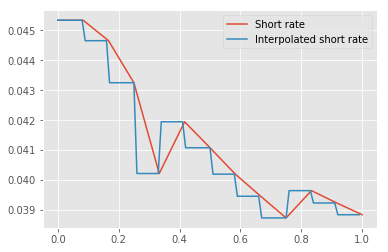

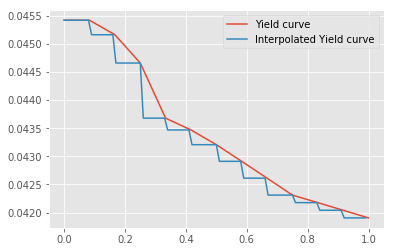

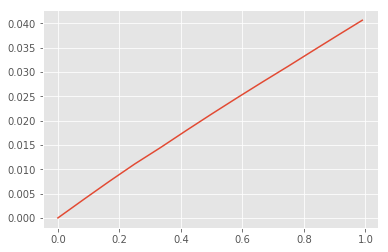

In [22]:
riskFreeCurve, riskCurvespline, yieldCurve, yieldCurvespline, interpolatedIntegral, riskFreeIntegral = bootstrapZeroCoupon(rateCurveDf, "Short rate")

In [23]:
riskFreeCurve

Maturity
0.000000    Price    0.045335
Name: 0.08333333333330001, d...
0.083333    Price    0.045335
Name: 0.08333333333330001, d...
0.166667                     Price    0.044652
dtype: float64
0.250000                     Price    0.043249
dtype: float64
0.333333                      Price    0.04022
dtype: float64
0.416667                     Price    0.041947
dtype: float64
0.500000                      Price    0.04108
dtype: float64
0.583333                     Price    0.040198
dtype: float64
0.666667                     Price    0.039461
dtype: float64
0.750000                     Price    0.038738
dtype: float64
0.833333                     Price    0.039648
dtype: float64
0.916667                     Price    0.039236
dtype: float64
1.000000                     Price    0.038844
dtype: float64
dtype: object

In [24]:
interpolatedIntegral

0.00    0.000000
0.01    0.000453
0.02    0.000907
0.03    0.001360
0.04    0.001813
0.05    0.002267
0.06    0.002720
0.07    0.003173
0.08    0.003627
0.09    0.004076
0.10    0.004522
0.11    0.004969
0.12    0.005415
0.13    0.005862
0.14    0.006308
0.15    0.006755
0.16    0.007201
0.17    0.007643
0.18    0.008076
0.19    0.008508
0.20    0.008941
0.21    0.009373
0.22    0.009806
0.23    0.010238
0.24    0.010671
0.25    0.011103
0.26    0.011505
0.27    0.011907
0.28    0.012310
0.29    0.012712
          ...   
0.70    0.029303
0.71    0.029690
0.72    0.030078
0.73    0.030465
0.74    0.030853
0.75    0.031240
0.76    0.031636
0.77    0.032033
0.78    0.032429
0.79    0.032826
0.80    0.033222
0.81    0.033619
0.82    0.034015
0.83    0.034412
0.84    0.034806
0.85    0.035198
0.86    0.035590
0.87    0.035983
0.88    0.036375
0.89    0.036767
0.90    0.037160
0.91    0.037552
0.92    0.037943
0.93    0.038332
0.94    0.038720
0.95    0.039109
0.96    0.039497
0.97    0.0398

### Boostraping dividend curve

In [25]:
def bootstrapDividend(curvePrice, underlying, name):
    #Compute cumulative sum of dividend plus spot price
    priceEvolution = underlying['S'].iloc[0] - curvePrice['Amount'].cumsum()
    priceEvolution.loc[0] = underlying['S'].iloc[0]
    priceEvolution.sort_index(inplace=True)

    #Bootstrap short rate for dividend
    def computeShortRate(curve) :
      shortRateList = [] 
      for i in range(curve.size):
        if i == 0 :
          shortRateList.append(-(np.log(curve.iloc[i+1])-np.log(curve.iloc[i]))/(curve.index[i+1]-curve.index[i]))
        else : 
          shortRateList.append(-(np.log(curve.iloc[i])-np.log(curve.iloc[i-1]))/(curve.index[i]-curve.index[i-1]))
      return pd.Series(shortRateList,index = curve.index).dropna()
    logReturnDividendDf = computeShortRate(priceEvolution)

    #Dividend yield curve
    def divYield(x):
      return ((priceEvolution[x]/priceEvolution.iloc[0])**(1/float(x)) - 1) #np.log(priceEvolution[x]/priceEvolution.iloc[0])/x
    dividendYield = logReturnDividendDf.index.to_series().tail(-1).apply(divYield)
    dividendYield.loc[0.00] = dividendYield.iloc[0]
    dividendYield = dividendYield.sort_index()

    plt.plot(logReturnDividendDf, label = "Short rate")

    #Interpolate short rate curve and yield curve
    timeStep = np.linspace(0,0.99,100)
    logReturnDividendSpline = interpolate.interp1d(logReturnDividendDf.index,
                                                   logReturnDividendDf,#logReturnDividendDf[name],
                                                   fill_value= 'extrapolate',
                                                   kind ='next')
    interpolatedCurve = pd.Series(logReturnDividendSpline(timeStep),index=timeStep)
    plt.plot(interpolatedCurve, label="Interpolated short rate")
    plt.legend()
    plt.show()

    plt.plot(dividendYield, label = "Yield curve")
    yieldCurvespline = interpolate.interp1d(dividendYield.index,
                                            dividendYield.values,
                                            fill_value= 'extrapolate',
                                            kind ='next')
    interpolatedCurve = pd.Series(yieldCurvespline(timeStep),index=timeStep)
    plt.plot(interpolatedCurve, label = "Interpolated Yield curve")
    plt.legend()
    plt.show()
    
    #Integrate short rate
    interpolatedIntegral, logReturnDividendIntegral = interpIntegral(logReturnDividendDf)#logReturnDividendDf[name])
    plt.plot(interpolatedIntegral)
    plt.show()

    return logReturnDividendDf, logReturnDividendSpline, dividendYield, yieldCurvespline, interpolatedIntegral, logReturnDividendIntegral

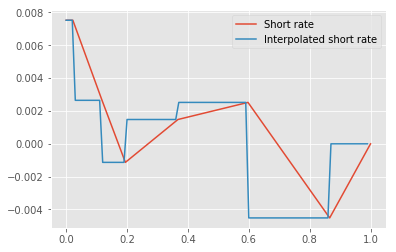

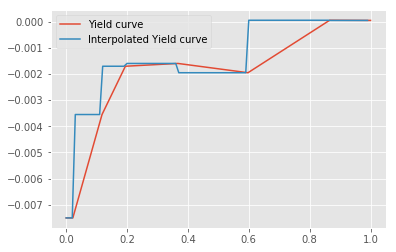

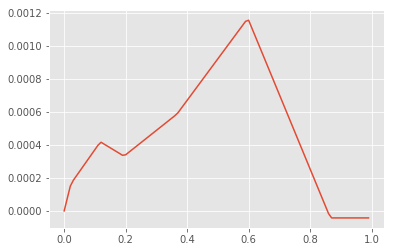

In [26]:
spreadDividend, divSpline, yieldDividend, divYieldSpline, interpolatedIntegral, divSpreadIntegral  = bootstrapDividend(dividendDf, underlyingNative, "Spread")

In [27]:
spreadDividend

Maturity
0.000000    0.007527
0.021918    0.007527
0.117808    0.002650
0.194521   -0.001130
0.367237    0.001481
0.597374    0.002522
0.865753   -0.004513
1.000000   -0.000000
dtype: float64

In [28]:
interpolatedIntegral

0.00    0.000000
0.01    0.000075
0.02    0.000151
0.03    0.000186
0.04    0.000213
0.05    0.000239
0.06    0.000266
0.07    0.000292
0.08    0.000319
0.09    0.000345
0.10    0.000372
0.11    0.000398
0.12    0.000417
0.13    0.000405
0.14    0.000394
0.15    0.000383
0.16    0.000371
0.17    0.000360
0.18    0.000349
0.19    0.000337
0.20    0.000341
0.21    0.000355
0.22    0.000370
0.23    0.000385
0.24    0.000400
0.25    0.000415
0.26    0.000429
0.27    0.000444
0.28    0.000459
0.29    0.000474
          ...   
0.70    0.000706
0.71    0.000660
0.72    0.000615
0.73    0.000570
0.74    0.000525
0.75    0.000480
0.76    0.000435
0.77    0.000390
0.78    0.000345
0.79    0.000299
0.80    0.000254
0.81    0.000209
0.82    0.000164
0.83    0.000119
0.84    0.000074
0.85    0.000029
0.86   -0.000017
0.87   -0.000042
0.88   -0.000042
0.89   -0.000042
0.90   -0.000042
0.91   -0.000042
0.92   -0.000042
0.93   -0.000042
0.94   -0.000042
0.95   -0.000042
0.96   -0.000042
0.97   -0.0000

**riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
**riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons

**divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
**divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

Training dataset is built on market prices observed on the dax.
Testing dataset is list of prices drawn from an excel provided by Stephane Crépey.
Prices come from the calibrated local volatility with tikhonov regularisation (see Crépey 2002 paper).
Implied volatitilities in both dataset are obtained from local volatility.

These curve satisfy together the call put parity.

Spot level is contained in underlying.csv

### Pricing black-scholes price

#### Change of variable

- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.

- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we should obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.


In [29]:
#Linear interpolation combined with Nearest neighbor extrapolation
def customInterpolator(interpolatedData, newStrike, newMaturity):
  strikeRef = np.ravel(interpolatedData.index.get_level_values("Strike").values)
  maturityRef = np.ravel(interpolatedData.index.get_level_values("Maturity").values)
  xym = np.vstack((strikeRef, maturityRef)).T

  fInterpolation = interpolate.griddata(xym,
                                        interpolatedData.values.flatten(),
                                        (newStrike, newMaturity),
                                        method = 'linear',
                                        rescale=True)

  fExtrapolation =  interpolate.griddata(xym,
                                         interpolatedData.values.flatten(),
                                         (newStrike, newMaturity),
                                         method = 'nearest',
                                         rescale=True)
    
  return np.where(np.isnan(fInterpolation), fExtrapolation, fInterpolation)

In [30]:
import scipy.stats as st
#Density derivative
def dpdf(x):
    v = 1
    return -x*np.exp(-x**2/(2.0*v**2))/(v**3*np.sqrt(2.0*np.pi))
    

def generalizedGreeks(cp, s, k, rf, t, v, div, rfInt, divInt):
        """ Price an option using the Black-Scholes model.
        cp: +1/-1 for call/put
        s: initial stock price
        k: strike price
        t: expiration time
        v: volatility
        rf: risk-free rate at time t
        div: dividend at time t
        rfInt: deterministic risk-free rate integrated between 0 and t
        divInt: deterministic dividend integrated between 0 and t
        """

        d1 = (np.log(s/k)+(rfInt-divInt+0.5*v*v*t))/(v*np.sqrt(t))
        d2 = d1 - v*np.sqrt(t)
        
        Nd1 = st.norm.cdf(cp*d1)
        Nd2 = st.norm.cdf(cp*d2)

        discountFactor = np.exp(-rfInt)
        forwardFactor = np.exp(-divInt)
        avgDiv = divInt/t
        avgRf = rfInt/t

        optprice = (cp*s*forwardFactor*Nd1) - (cp*k*discountFactor*Nd2)

        delta = cp*Nd1
        vega  = s*np.sqrt(t)*st.norm.pdf(d1)
        delta_k = -s*forwardFactor*Nd1/(v*np.sqrt(t)*k) - cp*discountFactor*Nd2 + k*discountFactor*Nd2/(v*np.sqrt(t)*k)
        
        gamma_k = s*forwardFactor/((v*np.sqrt(t)*k)**2)*(Nd1*v*np.sqrt(t) + cp*dpdf(cp*d1)) - k*discountFactor/((v*np.sqrt(t)*k)**2)*(Nd2*v*np.sqrt(t) + cp*dpdf(cp*d2)) +  2.0*discountFactor*Nd2/(v*np.sqrt(t)*k)  

        dd1_dt = (avgRf-avgDiv+0.5*v*v)/(v*np.sqrt(t)) - 0.5*(np.log(s/k)+(rfInt-divInt+0.5*v*v*t))/(v*v*t**(3/2))
        dd2_dt = dd1_dt - 0.5*v/np.sqrt(t)
        delta_T = avgRf*cp*k*discountFactor*Nd2 - avgDiv*cp*s*forwardFactor*Nd1 + s*forwardFactor*Nd1*dd1_dt- k*discountFactor*Nd2*dd2_dt
        
        return optprice, delta, vega, delta_k, gamma_k, delta_T

In [31]:
S0 = underlyingNative["S"].values
#Change of variable for deterministic discount curve and dividend curve
def changeOfVariable(s,t):
  def qInterp(m):
    return divSpreadIntegral(m).astype(np.float32)
  q = qInterp(t)
  
  def rInterp(m):
    return riskFreeIntegral(m).astype(np.float32)
  r = rInterp(t)

  factorPrice = np.exp( - q )

  divSpread = q-r

  factorStrike = np.exp( divSpread )
  adjustedStrike = np.multiply(s, factorStrike)
  return adjustedStrike, factorPrice

#Change of variable for constant discount and dividend short rate 
def changeOfVariable_BS(s,t):
  
  factorPrice = np.exp( - q*t )

  divSpread = (q-r)*t

  factorStrike = np.exp( divSpread )
  adjustedStrike = np.multiply(s, factorStrike)
  return adjustedStrike, factorPrice

In [32]:
filteredDat.head(30)

,Maturity,Strike,Price,Type
1,0.022,4400.0,0.2,2
3,0.022,4600.0,0.5,2
5,0.022,4900.0,1.8,2
7,0.022,5000.0,2.6,2
9,0.022,5100.0,4.9,2
11,0.022,5200.0,8.2,2
13,0.022,5300.0,18.0,2
15,0.022,5350.0,25.0,2
17,0.022,5400.0,34.3,2
19,0.022,5450.0,49.6,2


In [33]:
#Generate a proper dataset from implied volatility
def generateData(impliedVol,
                 S0,
                 rIntegralSpline,
                 qIntegralSpline,
                 rSpline,
                 qSpline,
                 priceDf = None,
                 spotValue = True):
  #Get grid coordinates
  if priceDf is None :
    x_train = impliedVol.index.to_frame()
    #Get implied vol by interpolating another grid
    x_train["ImpliedVol"] = impliedVol
  else :
    x_train = pd.MultiIndex.from_arrays([priceDf["Strike"], priceDf["Maturity"]], 
                                        names=('Strike', 'Maturity')).to_frame()
    #Get implied vol by interpolating another grid
    x_train["ImpliedVol"] = customInterpolator(impliedVol, 
                                               x_train["Strike"], 
                                               x_train["Maturity"])
  #Get sensitivities and prices
  isPut = True
  cp = -1 if isPut else 1
  impliedPriceFunction = lambda x : generalizedGreeks(cp, 
                                                      S0, 
                                                      x["Strike"] , 
                                                      rSpline(x["Maturity"]), 
                                                      x["Maturity"], 
                                                      x["ImpliedVol"], 
                                                      qSpline(x["Maturity"]), 
                                                      rIntegralSpline(x["Maturity"]), 
                                                      qIntegralSpline(x["Maturity"]))
  
  res = np.reshape(np.array(list(zip(x_train.apply(impliedPriceFunction,axis=1).values))),
                   (x_train.shape[0], 6))  # put greeks
  prices = res[:,0] if priceDf is None else priceDf["Price"].values
  deltas = res[:,1]
  vegas = res[:,2]
  delta_ks = res[:,3]
  gamma_ks = res[:,4]
  delta_Ts = res[:,5]
  
  #Vega for optional loss weighting
  sigmaRef = 0.25
  impliedPriceFunction = lambda x : generalizedGreeks(cp, 
                                                      S0, 
                                                      x["Strike"] , 
                                                      rSpline(x["Maturity"]), 
                                                      x["Maturity"], 
                                                      sigmaRef, 
                                                      qSpline(x["Maturity"]), 
                                                      rIntegralSpline(x["Maturity"]), 
                                                      qIntegralSpline(x["Maturity"]))
  
  res1 = np.reshape(np.array(list(zip(x_train.apply(impliedPriceFunction,axis=1).values))),
                    (x_train.shape[0], 6))  # put greeks
  
  #Get adjusted strike for the change of variables
  changedVar = changeOfVariable(x_train["Strike"],x_train["Maturity"])
  
  multiIndex = x_train["ImpliedVol"].index

  #Gather all data as a Dataframe 
  cols = ["Price", "Delta", "Vega", "Delta Strike", "Gamma Strike", 
          "Theta", "ChangedStrike", "DividendFactor", "Strike", "Maturity", "ImpliedVol", "VegaRef"]

  dfData = np.vstack((prices, deltas, vegas, delta_ks, gamma_ks, delta_Ts) + 
                     changedVar + (x_train["Strike"], x_train["Maturity"], x_train["ImpliedVol"], res1[:,2]))
  
  df = pd.DataFrame(dfData.T , columns=cols, index = multiIndex)

  #Add pricing with spot delivery
  if spotValue : 
    KAvailable = multiIndex.get_level_values("Strike").unique()
    TSpot = np.zeros_like(KAvailable)
    priceSpot = np.maximum(KAvailable- S0[0],0)
    deltaSpot = -np.sign(np.maximum(KAvailable- S0[0],0))
    gammaSpot = np.zeros_like(deltaSpot)
    vegasSpot = gammaSpot
    deltaKSpot = np.sign(np.maximum(KAvailable- S0[0],0))
    thetaSpot = 1000000 * deltaKSpot

    #Ignore implied vol for T=0
    impliedSpot = np.zeros_like(thetaSpot)

    changedVarSpot = changeOfVariable(KAvailable,TSpot)
    
    dfDataSpot = np.vstack((priceSpot, deltaSpot, vegasSpot, deltaKSpot, gammaSpot, thetaSpot) +
                          changedVarSpot + (KAvailable, TSpot, impliedSpot, vegasSpot))
    indexSpot = pd.MultiIndex.from_arrays([np.array(KAvailable), TSpot], names=('Strike', 'Maturity'))
    dfSpot = pd.DataFrame(dfDataSpot.T , columns=cols, index = indexSpot)
    df = df.append(dfSpot).sort_index()

  #Add forward logmoneyness if we want to calibrate local volatility from implied volatilities
  df["logMoneyness"] = np.log(df["ChangedStrike"] / S0[0]) 
  df["impliedTotalVariance"] = np.square(df["ImpliedVol"]) #*  df["Maturity"]

  return df.sort_index()

In [34]:
S0[0]

5512.28

In [35]:
formattedTrainingData.sort_index()

OptionType  Moneyness     Price  LocalImpliedVol  ImpliedVol
Strike Maturity                                                              
3600   0.118              2      0.653     0.127            0.434       0.388
       0.367              2      0.653     4.598            0.342       0.334
       0.597              2      0.653    15.777            0.329       0.324
       0.866              2      0.653    31.692            0.323       0.316
3800   0.118              2      0.689     0.410            0.398       0.388
       0.367              2      0.689     8.303            0.331       0.325
       0.597              2      0.689    24.567            0.317       0.317
       0.866              2      0.689    45.450            0.321       0.309
3900   0.118              2      0.708     0.702            0.388       0.381
4000   0.118              2      0.726     0.993            0.375       0.369
       0.367              2      0.726    14.297            0.317       0.316
       0.597              2      0.726    36.536            0.306       0.308
       0.866              2      0.726    62.215            0.299       0.301
4100   0.118              2      0.744     1.626            0.363       0.366
       0.367              2      0.744    18.228            0.310       0.311
4200   0.118              2      0.762     2.288            0.350       0.355
       0.367              2      0.762    23.018            0.303       0.306
       0.597              2      0.762    51.960            0.295       0.299
       0.866              2      0.762    82.352            0.292       0.292
4300   0.118              2      0.780     3.143            0.341       0.342
       0.367              2      0.780    27.809            0.298       0.298
4400   0.118              2      0.798     4.602            0.327       0.333
       0.367              2      0.798    35.040            0.292       0.293
       0.597              2      0.798    71.084            0.285       0.288
       0.866              2      0.798   106.051            0.280       0.282
4500   0.118              2      0.816     6.062            0.316       0.319
       0.367              2      0.816    42.819            0.284       0.287
4600   0.118              2      0.835     8.389            0.304       0.308
       0.367              2      0.835    50.598            0.279       0.278
       0.597              2      0.835    95.624            0.274       0.276
...                     ...        ...       ...              ...         ...
6800   0.597              2      1.234  1166.271            0.184       0.184
       0.866              2      1.234  1144.649            0.194       0.194
6900   0.195              2      1.252  1330.868            0.202       0.197
       0.367              2      1.252  1290.896            0.185       0.186
       0.597              2      1.252  1254.534            0.182       0.181
7000   0.195              2      1.270  1429.712            0.209       0.202
       0.367              2      1.270  1387.548            0.187       0.189
       0.597              2      1.270  1347.084            0.178       0.183
       0.866              2      1.270  1306.660            0.190       0.189
7100   0.367              2      1.288  1484.201            0.188       0.190
       0.597              2      1.288  1439.635            0.176       0.182
7200   0.367              2      1.306  1580.853            0.189       0.188
       0.597              2      1.306  1532.185            0.173       0.180
       0.866              2      1.306  1480.996            0.187       0.188
7300   0.367              2      1.324  1678.272            0.191       0.188
       0.597              2      1.324  1624.736            0.170       0.173
7400   0.367              2      1.342  1776.300            0.194       0.191
       0.597              2      1.342  1720.983            0.170       0.177
       0.866              2      1.342 

In [36]:
testingData.tail()

,Strike,Maturity,Implied vol.,Option price,Implied delta,Implied gamma,Implied theta,Local delta,Local gamma
356,6295.60,0.957895,0.216992,265.4890,0.369328,0.000322,2035.83,0.284007,0.000255
357,6469.68,0.957895,0.211035,208.6810,0.315251,0.000312,1917.20,0.237920,0.000232
358,6643.75,0.957895,0.208984,167.0930,0.268431,0.000292,1778.66,0.199579,0.000208
359,6817.82,0.957895,0.205859,130.6080,0.224107,0.000269,1614.41,0.163836,0.000182
360,6991.89,0.957895,0.201172,98.1277,0.181739,0.000243,1424.22,0.131082,0.000157


In [37]:
testingDataSet = generateData(formattedTestingData,
                              S0,
                              riskFreeIntegral,
                              divSpreadIntegral,
                              riskCurvespline,
                              divSpline)
testingDataSet.tail()

Price     Delta         Vega  Delta Strike  \
Strike  Maturity                                                     
6991.89 0.789     1308.685633 -0.875217  1006.703146      2.002557   
        0.832     1303.404474 -0.864425  1094.852860      1.954997   
        0.874     1298.893871 -0.854073  1179.601561      1.911802   
        0.916     1306.096167 -0.831847  1325.696565      1.829377   
        0.958     1307.324911 -0.818247  1424.349467      1.781691   

                  Gamma Strike        Theta  ChangedStrike  DividendFactor  \
Strike  Maturity                                                             
6991.89 0.789         0.001208 -5169.444734    6768.425788        0.999696   
        0.832         0.001149 -4659.210710    6755.584914        0.999890   
        0.874         0.001096 -4227.204655    6743.430426        1.000042   
        0.916         0.000982 -3519.799467    6732.326979        1.000042   
        0.958         0.000922 -3131.614113    6721.350641        1.000042   

                   Strike  Maturity  ImpliedVol      VegaRef  logMoneyness  \
Strike  Maturity                                                             
6991.89 0.789     6991.89     0.789    0.187207  1403.136495      0.205290   
        0.832     6991.89     0.832    0.187988  1482.166338      0.203391   
        0.874     6991.89     0.874    0.188770  1556.890334      0.201590   
        0.916     6991.89     0.916    0.197803  1628.796155      0.199943   
        0.958     6991.89     0.958    0.201172  1698.671541      0.198311   

                  impliedTotalVariance  
Strike  Maturity                        
6991.89 0.789                 0.035046  
        0.832                 0.035339  
        0.874                 0.035634  
        0.916                 0.039126  
        0.958                 0.040470

In [38]:
#Checking call put parity
maturity = testingData.iloc[-4]["Maturity"]
strike = testingData.iloc[-4]["Strike"]
(S0 * np.exp(-divSpreadIntegral(maturity))  - np.exp(-riskFreeIntegral(maturity)) * strike) 

array([-707.12200515])

In [39]:
#Put call parity
testingData.iloc[-4]["Option price"] - testingDataSet.loc[(testingData.iloc[-4]["Strike"],round(testingData.iloc[-4]["Maturity"],3))]["Price"]

-707.0885268476918

In [40]:
(formattedTrainingData["Price"]).dropna()

Strike  Maturity
3800    0.118          0.410
3900    0.118          0.702
4000    0.118          0.993
4100    0.118          1.626
4200    0.118          2.288
4300    0.118          3.143
4400    0.118          4.602
4500    0.118          6.062
4600    0.118          8.389
4700    0.118         12.102
4800    0.118         15.815
4900    0.118         21.859
5000    0.118         32.463
5100    0.118         43.068
5200    0.118         55.312
5250    0.118         69.991
5300    0.118         84.670
5350    0.118         99.349
5400    0.118        114.027
5450    0.118        128.706
5500    0.118        143.385
5550    0.118        162.310
5600    0.118        194.748
5650    0.118        227.187
5700    0.118        259.625
5750    0.118        292.064
5800    0.118        324.503
5850    0.118        356.941
3600    0.118          0.127
5950    0.118        433.660
                      ...   
8600    0.866       2787.803
8800    0.866       2979.926
4000    0.866         62.2

In [41]:
trainingDataSet = generateData(formattedTrainingData["ImpliedVol"],
                               S0,
                               riskFreeIntegral,
                               divSpreadIntegral,
                               riskCurvespline,
                               divSpline,
                               priceDf = filteredDat)
trainingDataSet.tail()

Price     Delta      Vega  Delta Strike  Gamma Strike  \
Strike  Maturity                                                            
9400.0  0.367     3743.40 -0.999993  0.102487      4.372352      0.001421   
9600.0  0.000     4087.72 -1.000000  0.000000      1.000000      0.000000   
        0.367     3940.20 -0.999997  0.046246      4.476244      0.001381   
10000.0 0.000     4487.72 -1.000000  0.000000      1.000000      0.000000   
        0.367     4334.00 -0.999999  0.009021      4.671557      0.001306   

                           Theta  ChangedStrike  DividendFactor   Strike  \
Strike  Maturity                                                           
9400.0  0.367     -115246.799193    9257.469440        0.999412   9400.0   
9600.0  0.000     1000000.000000    9600.000000        1.000000   9600.0   
        0.367     -126298.605422    9454.436874        0.999412   9600.0   
10000.0 0.000     1000000.000000   10000.000000        1.000000  10000.0   
        0.367     -149555.409480    9848.371744        0.999412  10000.0   

                  Maturity  ImpliedVol   VegaRef  logMoneyness  \
Strike  Maturity                                                 
9400.0  0.367        0.367       0.194  4.912151      0.518452   
9600.0  0.000        0.000       0.000  0.000000      0.554785   
        0.367        0.367       0.194  3.054788      0.539506   
10000.0 0.000        0.000       0.000  0.000000      0.595607   
        0.367        0.367       0.194  1.151003      0.580328   

                  impliedTotalVariance  
Strike  Maturity                        
9400.0  0.367                 0.037636  
9600.0  0.000                 0.000000  
        0.367                 0.037636  
10000.0 0.000                 0.000000  
        0.367                 0.037636

In [42]:
trainingDataSet = generateData(formattedTrainingData["ImpliedVol"], 
                               S0, 
                               riskFreeIntegral, 
                               divSpreadIntegral, 
                               riskCurvespline, 
                               divSpline,
                               priceDf = formattedTrainingData.reset_index())
trainingDataSet.tail()

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                               
8400   0.866     2595.744 -0.987576  165.117972      2.822543      0.001138   
8600   0.000     3087.720 -1.000000    0.000000      1.000000      0.000000   
       0.866     2787.803 -0.990448  131.353460      2.883467      0.001089   
8800   0.000     3287.720 -1.000000    0.000000      1.000000      0.000000   
       0.866     2979.926 -0.992877  101.505041      2.948993      0.001048   

                          Theta  ChangedStrike  DividendFactor  Strike  \
Strike Maturity                                                          
8400   0.866      -19351.839086    8104.046130        1.000042  8400.0   
8600   0.000     1000000.000000    8600.000000        1.000000  8600.0   
       0.866      -21335.082549    8296.999609        1.000042  8600.0   
8800   0.000     1000000.000000    8800.000000        1.000000  8800.0   
       0.866      -23579.959496    8489.953089        1.000042  8800.0   

                 Maturity  ImpliedVol     VegaRef  logMoneyness  \
Strike Maturity                                                   
8400   0.866        0.866       0.178  625.006420      0.385385   
8600   0.000        0.000       0.000    0.000000      0.444784   
       0.866        0.866       0.181  532.119765      0.408916   
8800   0.000        0.000       0.000    0.000000      0.467773   
       0.866        0.866       0.183  450.246235      0.431905   

                 impliedTotalVariance  
Strike Maturity                        
8400   0.866                 0.031684  
8600   0.000                 0.000000  
       0.866                 0.032761  
8800   0.000                 0.000000  
       0.866                 0.033489

In [43]:
((trainingDataSet["Price"] - formattedTrainingData["Price"])/formattedTrainingData["Price"]).min()

0.0

In [44]:
((trainingDataSet["Price"] - formattedTrainingData["Price"])/formattedTrainingData["Price"]).dropna()

Strike  Maturity
3600    0.118       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
3800    0.118       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
3900    0.118       0.0
4000    0.118       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
4100    0.118       0.0
        0.367       0.0
4200    0.118       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
4300    0.118       0.0
        0.367       0.0
4400    0.118       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
4500    0.118       0.0
        0.367       0.0
4600    0.118       0.0
        0.367       0.0
        0.597       0.0
                   ... 
6800    0.597       0.0
        0.866       0.0
6900    0.195       0.0
        0.367       0.0
        0.597       0.0
7000    0.195       0.0
        0.367       0.0
        0.597       0.0
        0.866       0.0
7100    0.367       0.0

In [45]:
filteredTrainingData.tail()

,Active,Option type,Maturity,Strike,Moneyness,Option price,Implied vol.,Calibrated vol.,Market vol. - Calibrated vol.
403,1,2,0.866,6800,1.234,1144.649,0.194,0.194,0.000
405,1,2,0.866,7000,1.270,1306.660,0.190,0.189,0.001
407,1,2,0.866,7200,1.306,1480.996,0.187,0.188,-0.001
409,1,2,0.866,7400,1.342,1656.023,0.183,0.182,0.001
411,1,2,0.866,7600,1.379,1841.341,0.183,0.184,-0.001


In [46]:
filteredTrainingData[filteredTrainingData["Strike"]==5900]

,Active,Option type,Maturity,Strike,Moneyness,Option price,Implied vol.,Calibrated vol.,Market vol. - Calibrated vol.
93,1,2,0.118,5900,1.07,389.380,0.201,0.185,0.015
150,1,2,0.195,5900,1.07,410.736,0.203,0.197,0.006
230,1,2,0.367,5900,1.07,459.609,0.210,0.209,0.001
328,1,2,0.597,5900,1.07,514.617,0.215,0.217,-0.002
389,1,2,0.866,5900,1.07,554.404,0.220,0.221,-0.001


In [47]:
trainingDataSet[trainingDataSet["Strike"]==5900]

Price     Delta         Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                               
5900   0.000     387.720 -1.000000     0.000000      1.000000      0.000000   
       0.118     389.380 -0.831631   476.207173      1.880719      0.003692   
       0.195     410.736 -0.739375   790.533063      1.560246      0.002236   
       0.367     459.609 -0.637912  1251.797020      1.287871      0.001230   
       0.597     514.617 -0.570588  1672.470155      1.137247      0.000794   
       0.866     554.404 -0.521246  2043.543331      1.037818      0.000573   

                          Theta  ChangedStrike  DividendFactor  Strike  \
Strike Maturity                                                          
5900   0.000     1000000.000000    5900.000000        1.000000  5900.0   
       0.118       -7792.872032    5871.119666        0.999581  5900.0   
       0.195       -2916.370226    5850.699043        0.999667  5900.0   
       0.367        -766.699222    5810.539329        0.999412  5900.0   
       0.597        -182.391183    5759.539115        0.998833  5900.0   
       0.866          10.445359    5692.127639        1.000042  5900.0   

                 Maturity  ImpliedVol      VegaRef  logMoneyness  \
Strike Maturity                                                    
5900   0.000        0.000       0.000     0.000000      0.067974   
       0.118        0.118       0.185   594.793173      0.063067   
       0.195        0.195       0.197   863.539430      0.059583   
       0.367        0.367       0.209  1283.761459      0.052695   
       0.597        0.597       0.217  1684.713494      0.043879   
       0.866        0.866       0.221  2045.965184      0.032106   

                 impliedTotalVariance  
Strike Maturity                        
5900   0.000                 0.000000  
       0.118                 0.034225  
       0.195                 0.038809  
       0.367                 0.043681  
       0.597                 0.047089  
       0.866                 0.048841

In [48]:
filteredTrainingData[filteredTrainingData["Strike"]==4000]

,Active,Option type,Maturity,Strike,Moneyness,Option price,Implied vol.,Calibrated vol.,Market vol. - Calibrated vol.
5,1,2,0.118,4000,0.726,0.993,0.375,0.369,0.006
180,1,2,0.367,4000,0.726,14.297,0.317,0.316,0.000
287,1,2,0.597,4000,0.726,36.536,0.306,0.308,-0.003
356,1,2,0.866,4000,0.726,62.215,0.299,0.301,-0.002


In [49]:
trainingDataSet[trainingDataSet["Strike"]==4000]

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                             
4000   0.000      0.000 -0.000000    0.000000      0.000000      0.000000   
       0.118      0.993 -0.004244   23.652621      0.007975     -0.000010   
       0.367     14.297 -0.032107  240.342523      0.066304     -0.000009   
       0.597     36.536 -0.058467  497.166026      0.127429      0.000010   
       0.866     62.215 -0.078833  754.176392      0.179333      0.000027   

                      Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                                
4000   0.000       0.000000    4000.000000        1.000000  4000.0     0.000   
       0.118      40.183552    3980.420113        0.999581  4000.0     0.118   
       0.367     148.318077    3939.348698        0.999412  4000.0     0.367   
       0.597     197.424542    3904.772282        0.998833  4000.0     0.597   
       0.866     208.266508    3859.069586        1.000042  4000.0     0.866   

                 ImpliedVol     VegaRef  logMoneyness  impliedTotalVariance  
Strike Maturity                                                              
4000   0.000          0.000    0.000000     -0.320684              0.000000  
       0.118          0.369    0.485032     -0.325591              0.136161  
       0.367          0.316   95.903678     -0.335963              0.099856  
       0.597          0.308  289.423654     -0.344779              0.094864  
       0.866          0.301  525.532398     -0.356552              0.090601

In [50]:
localVolatility.head()

,,StrikePercentage,LocalVolatility
Strike,Maturity,,
5512.280000,0.000,1.000000,0.342450
5168.567293,0.008,0.937646,0.300538
5513.845488,0.008,1.000284,0.328570
5882.187062,0.008,1.067106,0.239878
4846.286330,0.015,0.879180,0.296626


In [51]:
testingData.tail()

,Strike,Maturity,Implied vol.,Option price,Implied delta,Implied gamma,Implied theta,Local delta,Local gamma
356,6295.60,0.957895,0.216992,265.4890,0.369328,0.000322,2035.83,0.284007,0.000255
357,6469.68,0.957895,0.211035,208.6810,0.315251,0.000312,1917.20,0.237920,0.000232
358,6643.75,0.957895,0.208984,167.0930,0.268431,0.000292,1778.66,0.199579,0.000208
359,6817.82,0.957895,0.205859,130.6080,0.224107,0.000269,1614.41,0.163836,0.000182
360,6991.89,0.957895,0.201172,98.1277,0.181739,0.000243,1424.22,0.131082,0.000157


In [52]:
#Get local volatility from Crépey (2002) by nearest neighbour interpolation
def interpolatedLocalVolatility(localVol, priceGrid):
    
    strikePrice = priceGrid.index.get_level_values("Strike").values.flatten()
    maturityPrice = priceGrid.index.get_level_values("Maturity").values.flatten()
    coordinates = customInterpolator(localVol["LocalVolatility"], strikePrice, maturityPrice)
 

    return pd.Series(coordinates, index = priceGrid.index)

trainingDataSet["locvol"] = interpolatedLocalVolatility(localVolatility, trainingDataSet["Price"])
testingDataSet["locvol"] = interpolatedLocalVolatility(localVolatility, testingDataSet["Price"])

In [53]:
localVolatility[localVolatility.index.get_level_values("Maturity") <= 0.01]

,,StrikePercentage,LocalVolatility
Strike,Maturity,,
5512.280000,0.000,1.000000,0.342450
5168.567293,0.008,0.937646,0.300538
5513.845488,0.008,1.000284,0.328570
5882.187062,0.008,1.067106,0.239878


In [54]:
dataSet = trainingDataSet #Training set
dataSetTest = testingDataSet #Testing set

In [55]:
tGrid = np.linspace(0, 1, 101)
exportedRiskFreeIntegral = riskFreeIntegral(tGrid),
exportedDivSpreadIntegral = divSpreadIntegral(tGrid)
exportedRRiskCurvespline = riskCurvespline(tGrid),
exportedDivSpline = divSpline(tGrid)
dfCurve = pd.DataFrame(np.vstack([exportedRiskFreeIntegral, exportedDivSpreadIntegral, exportedRRiskCurvespline, exportedDivSpline]).T,
                       columns=["riskFreeIntegral","divSpreadIntegral","riskCurvespline","divSpline"], 
                       index = tGrid)

In [56]:
dfCurve.to_csv(workingFolder + "dfCurve.csv")

In [57]:
dataSet.to_csv(workingFolder + "trainingDataSet.csv")

In [58]:
dataSetTest.to_csv(workingFolder + "testingDataSet.csv")

In [59]:
dataSetTest.head()

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                               
3858.6 0.000     0.000000 -0.000000    0.000000      0.000000      0.000000   
       0.200     1.838977 -0.006482   44.885057      0.012877     -0.000012   
       0.242     3.025268 -0.009536   69.335150      0.019236     -0.000014   
       0.284     4.966856 -0.013881  104.062676      0.028486     -0.000014   
       0.326     7.385669 -0.018589  143.201646      0.038746     -0.000014   

                     Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                               
3858.6 0.000      0.000000    3858.600000        1.000000  3858.6     0.000   
       0.200     45.092438    3825.558187        0.999660  3858.6     0.200   
       0.242     58.868704    3818.853045        0.999597  3858.6     0.242   
       0.284     77.620443    3812.552456        0.999535  3858.6     0.284   
       0.326     95.409668    3806.354442        0.999473  3858.6     0.326   

                 ImpliedVol    VegaRef  logMoneyness  impliedTotalVariance  \
Strike Maturity                                                              
3858.6 0.000       0.000000   0.000000     -0.356674              0.000000   
       0.200       0.339063   3.934856     -0.365274              0.114964   
       0.242       0.329688  10.462198     -0.367028              0.108694   
       0.284       0.327344  21.136174     -0.368679              0.107154   
       0.326       0.325781  35.966546     -0.370306              0.106133   

                   locvol  
Strike Maturity            
3858.6 0.000     0.342450  
       0.200     0.354975  
       0.242     0.382828  
       0.284     0.404907  
       0.326     0.418640

## Scaling methods

Use min-max of scaling strike between 0 et 1 for improving stability of neural network training. 

In [60]:
def transformCustomMinMax(df, scaler):
  return pd.DataFrame(scaler.transform(df),
                      index = df.index, 
                      columns = df.columns)
#Reverse operation min-max scaling
def inverseTransformMinMax(df, scaler):
  return pd.DataFrame(scaler.inverse_transform(df),
                      index = df.index, 
                      columns = df.columns)
#Same thing but for a particular column
def inverseTransformColumnMinMax(originalDf, scaler, column):
  colIndex = originalDf.columns.get_loc(column.name)
  maxCol = scaler.data_max_[colIndex]
  minCol = scaler.data_min_[colIndex]
  return pd.Series(minCol + (maxCol - minCol) * column, index = column.index).rename(column.name)  
#Reverse transform of min-max scaling but for greeks   
def inverseTransformColumnGreeksMinMax(originalDf, 
                                       scaler,
                                       columnDerivative,
                                       columnFunctionName,
                                       columnVariableName,
                                       order = 1):
  colFunctionIndex = originalDf.columns.get_loc(columnFunctionName)
  maxColFunction = scaler.data_max_[colFunctionIndex]
  minColFunction = scaler.data_min_[colFunctionIndex]
  scaleFunction = (maxColFunction - minColFunction)
  
  colVariableIndex = originalDf.columns.get_loc(columnVariableName)
  maxColVariable = scaler.data_max_[colVariableIndex]
  minColVariable = scaler.data_min_[colVariableIndex]
  scaleVariable = (maxColVariable - minColVariable) ** order

  return pd.Series(scaleFunction * columnDerivative / scaleVariable , 
                   index = columnDerivative.index).rename(columnDerivative.name) 

In [61]:
#Tools functions for min-max scaling
def transformCustomId(df, scaler):
  return pd.DataFrame(df,
                      index = df.index, 
                      columns = df.columns)
def inverseTransformId(df, scaler):
  return pd.DataFrame(df,
                      index = df.index, 
                      columns = df.columns)
def inverseTransformColumnId(originalDf, scaler, column):
  return pd.Series(column, index = column.index).rename(column.name)  

def inverseTransformColumnGreeksId(originalDf, scaler, 
                                 columnDerivative, 
                                 columnFunctionName, 
                                 columnVariableName,
                                 order = 1):
  return pd.Series(columnDerivative , index = columnDerivative.index).rename(columnDerivative.name)


In [62]:
activateScaling = False
transformCustom = transformCustomMinMax if activateScaling else transformCustomId
inverseTransform = inverseTransformMinMax if activateScaling else inverseTransformId
inverseTransformColumn = inverseTransformColumnMinMax if activateScaling else inverseTransformColumnId
inverseTransformColumnGreeks = inverseTransformColumnGreeksMinMax if activateScaling else inverseTransformColumnGreeksId

In [63]:
scaler = skl.preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler.fit(dataSet)
scaledDataSet = transformCustom(dataSet, scaler)
scaledDataSetTest = transformCustom(dataSetTest, scaler)

In [64]:
scaledDataSet.head()

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                             
3600   0.000      0.000 -0.000000    0.000000      0.000000  0.000000e+00   
       0.118      0.127 -0.000483    3.261597      0.000968 -2.354589e-06   
       0.367      4.598 -0.011236   98.514055      0.024772 -1.301400e-05   
       0.597     15.777 -0.027223  267.303097      0.063405 -9.273793e-06   
       0.866     31.692 -0.042916  467.980902      0.104558  5.293411e-07   

                      Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                                
3600   0.000       0.000000    3600.000000        1.000000  3600.0     0.000   
       0.118       4.842677    3582.378101        0.999581  3600.0     0.118   
       0.367      56.078839    3545.413828        0.999412  3600.0     0.367   
       0.597     100.196151    3514.295053        0.998833  3600.0     0.597   
       0.866     124.311979    3473.162627        1.000042  3600.0     0.866   

                 ImpliedVol     VegaRef  logMoneyness  impliedTotalVariance  \
Strike Maturity                                                               
3600   0.000          0.000    0.000000     -0.426044              0.000000   
       0.118          0.388    0.002070     -0.430951              0.150544   
       0.367          0.334   15.263747     -0.441323              0.111556   
       0.597          0.324   89.379652     -0.450139              0.104976   
       0.866          0.316  224.778094     -0.461913              0.099856   

                   locvol  
Strike Maturity            
3600   0.000     0.342450  
       0.118     0.396889  
       0.367     0.399936  
       0.597     0.392773  
       0.866     0.416986

In [65]:
#Search strike for ATM option
midS0 = dataSet[dataSet.index.get_level_values("Strike") >= S0[0]].index.get_level_values("Strike").min()

## Plot functions

In [66]:
#Plot loss for each epoch 
def plotEpochLoss(lossSerie):
  fig = plt.figure(figsize=(20,10))
  ax = fig.gca()
  
  ax.plot(lossSerie , "-", color="black")
  ax.set_xlabel("Epoch number", fontsize=18, labelpad=20)
  ax.set_ylabel("Logarithmic Loss", fontsize=18, labelpad=20)
  ax.set_title("Training Loss evolution", fontsize=24)
  ax.tick_params(labelsize=16)
  ax.set_facecolor('white')
  plt.show()
  return

In [67]:
KMin = 0.7 * S0[0]
KMax = 1.3 * S0[0]


In [68]:
#Plot a surface as a superposition of curves
def plotMultipleCurve(data,
                      Title = 'True Price Surface',
                      yMin = KMin,
                      yMax = KMax,
                      zAsPercent = False):
  

  dataCurve = data[(data.index.get_level_values("Strike") <= yMax) * (data.index.get_level_values("Strike") >= yMin)]

  fig = plt.figure(figsize=(20,10))
  ax = fig.gca()

  for t in np.linspace(0,0.8,9) :
    k = dataCurve[dataCurve.index.get_level_values("Maturity") >= t].index.get_level_values("Maturity").unique().min()
    curveK = dataCurve[dataCurve.index.get_level_values("Maturity")==k]
    dataSerie = pd.Series(curveK.values * (100 if zAsPercent else 1) ,
                          index = curveK.index.get_level_values("Strike"))
    ax.plot(dataSerie , "--+", label=str(k))
  ax.legend()  
  ax.set_xlabel(data.index.names[0], fontsize=18, labelpad=20)
  ax.set_ylabel(data.name, fontsize=18, labelpad=20)
  if zAsPercent :
    ax.yaxis.set_major_formatter(mtick.PercentFormatter())
  ax.set_title(Title, fontsize=24)
  ax.tick_params(labelsize=16)
  ax.set_facecolor('white')
  plt.show()
  return

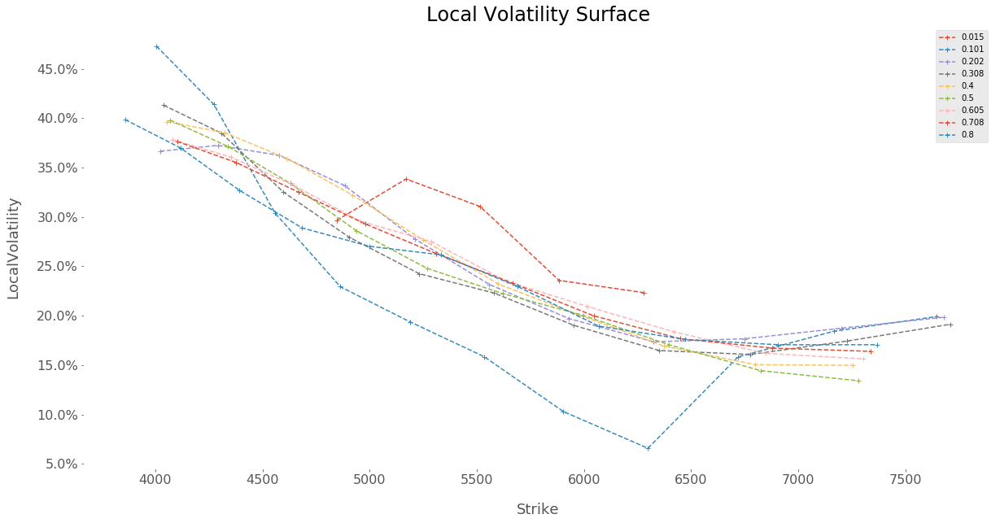

In [69]:
plotMultipleCurve(localVolatility["LocalVolatility"][localVolatility.index.get_level_values("Maturity")>0.01],
                  Title = 'Local Volatility Surface',
                  yMin=0.7*S0[0],
                  yMax=1.4*S0[0], 
                  zAsPercent=True)

In [70]:
#Plotting function for surface
#xTitle : title for x axis
#yTitle : title for y axis
#zTitle : title for z axis
#Title : plot title
#az : azimuth i.e. angle of view for surface
#yMin : minimum value for y axis
#yMax : maximum value for y axis
#zAsPercent : boolean, if true format zaxis as percentage 
def plot2GridCustom(coordinates, zValue,
                    coordinates2, zValue2,
                    xTitle = "Maturity",
                    yTitle = "Strike",
                    zTitle = "Price",
                    Title = 'True Price Surface', 
                    az=320, 
                    yMin = KMin,
                    yMax = KMax,
                    zAsPercent = False):
  y = coordinates[:,0]
  filteredValue = (y > yMin) & (y < yMax)
  x = coordinates[:,1][filteredValue]
  y = coordinates[:,0][filteredValue]
  z = zValue[filteredValue].flatten()
  
  y2 = coordinates2[:,0]
  filteredValue2 = (y2 > yMin) & (y2 < yMax)
  x2 = coordinates2[:,1][filteredValue2]
  y2 = coordinates2[:,0][filteredValue2]
  z2 = zValue2[filteredValue2].flatten()
  
  fig = plt.figure(figsize=(20,10))
  ax = fig.gca(projection='3d')
  
  ax.set_xlabel(xTitle, fontsize=18, labelpad=20)
  ax.set_ylabel(yTitle, fontsize=18, labelpad=20)
  ax.set_zlabel(zTitle, fontsize=18, labelpad=10)
  
  cmap=plt.get_cmap("inferno")
  colors=cmap(z * 100 if zAsPercent else z)[np.newaxis, :, :3]
  ax.scatter(x2, y2, z2, marker='o', color="r", alpha=1, s=40)
  ax.scatter(x, y, z, marker='o', color="b", alpha=1, s=40)
  #surf = ax.plot_trisurf(x, y,
  #                       z * 100 if zAsPercent else z ,
  #                       linewidth=1.0,
  #                       antialiased=True, 
  #                       cmap = cmap,
  #                       color=(0,0,0,0))
  #scaleEdgeValue = surf.to_rgba(surf.get_array())
  #surf.set_edgecolors(scaleEdgeValue) 
  #surf.set_alpha(0)


  if zAsPercent :
    ax.zaxis.set_major_formatter(mtick.PercentFormatter())
  ax.view_init(elev=10., azim=az)
  #ax.set_title(Title, fontsize=24)
  ax.set_facecolor('white')

  plt.tick_params(labelsize=16)

  
  plt.show()


  return

#Plotting function from a pandas series
def plot2Series(data, 
                data2,
                Title = 'True Price Surface',
                az=320,
                yMin = KMin,
                yMax = KMax, 
                zAsPercent = False):
  

  plot2GridCustom(data.index.to_frame().values, 
                  data.values,
                  data2.index.to_frame().values, 
                  data2.values,
                  xTitle = data.index.names[1],
                  yTitle = data.index.names[0],
                  zTitle = data.name,
                  Title = Title, 
                  az=az, 
                  yMin = yMin, 
                  yMax = yMax, 
                  zAsPercent = zAsPercent)
  return

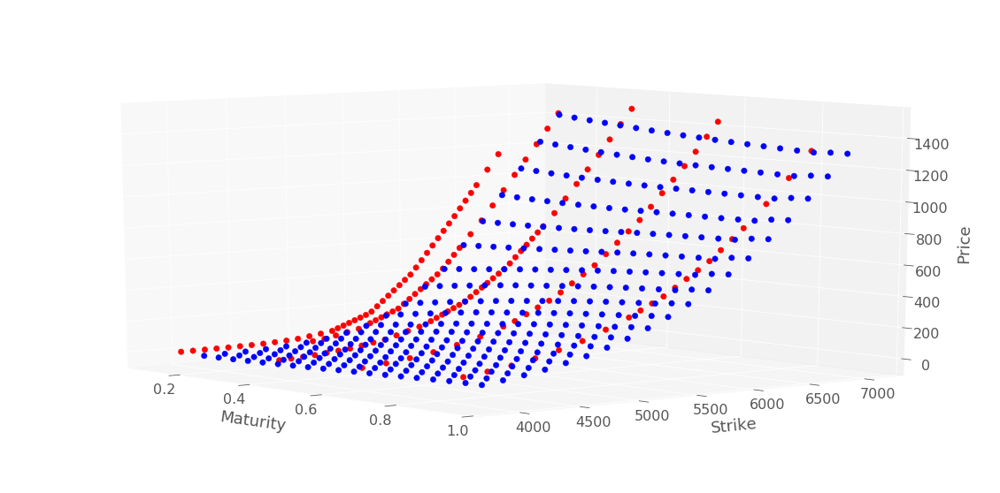

In [71]:
plot2Series(dataSetTest[dataSetTest.Maturity > 0]["Price"], 
            dataSet[dataSet.Maturity > 0]["Price"], 
            Title = 'True Price Surface')

In [72]:
def convertToLogMoneyness(formerSerie):
  maturity = formerSerie.index.get_level_values("Maturity")
  logMoneyness = np.log(S0[0] / formerSerie.index.get_level_values("Strike"))
  newIndex = pd.MultiIndex.from_arrays([np.array(logMoneyness.values), np.array(maturity.values)], names=('LogMoneyness', 'Maturity'))
  if type(formerSerie) == type(pd.Series()) :
    return pd.Series(formerSerie.values , index=newIndex)
  return pd.DataFrame(formerSerie.values, index = newIndex, columns= formerSerie.columns)

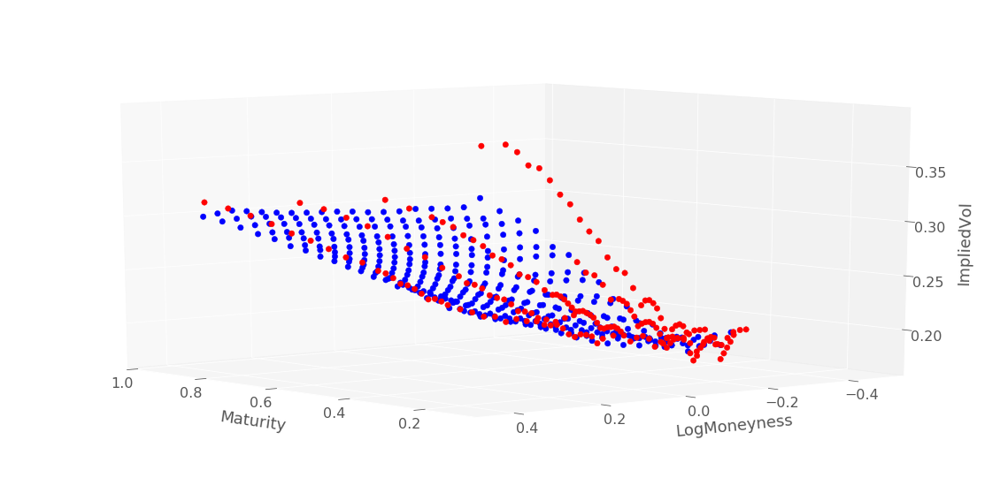

In [73]:
plot2Series(convertToLogMoneyness(dataSetTest[dataSetTest.Maturity > 0])["ImpliedVol"], 
            convertToLogMoneyness(dataSet[dataSet.Maturity > 0])["ImpliedVol"], 
            Title = 'True Implied vol Surfaces', yMin = -1000, az=140)

In [74]:
#Plotting function for surface
#xTitle : title for x axis
#yTitle : title for y axis
#zTitle : title for z axis
#Title : plot title
#az : azimuth i.e. angle of view for surface
#yMin : minimum value for y axis
#yMax : maximum value for y axis
#zAsPercent : boolean, if true format zaxis as percentage 
def plotGridCustom(coordinates, zValue,
                   xTitle = "Maturity",
                   yTitle = "Strike",
                   zTitle = "Price",
                   Title = 'True Price Surface', 
                   az=320, 
                   yMin = KMin,
                   yMax = KMax,
                   zAsPercent = False):
  y = coordinates[:,0]
  filteredValue = (y > yMin) & (y < yMax)
  x = coordinates[:,1][filteredValue]
  y = coordinates[:,0][filteredValue]
  z = zValue[filteredValue].flatten()
  
  fig = plt.figure(figsize=(20,10))
  ax = fig.gca(projection='3d')
  
  ax.set_xlabel(xTitle, fontsize=18, labelpad=20)
  ax.set_ylabel(yTitle, fontsize=18, labelpad=20)
  ax.set_zlabel(zTitle, fontsize=18, labelpad=10)
  
  cmap=plt.get_cmap("inferno")
  colors=cmap(z * 100 if zAsPercent else z)[np.newaxis, :, :3]
  surf = ax.plot_trisurf(x, y,
                         z * 100 if zAsPercent else z ,
                         linewidth=1.0,
                         antialiased=True, 
                         cmap = cmap,
                         color=(0,0,0,0))
  scaleEdgeValue = surf.to_rgba(surf.get_array())
  surf.set_edgecolors(scaleEdgeValue) 
  surf.set_alpha(0)

  if zAsPercent :
    ax.zaxis.set_major_formatter(mtick.PercentFormatter())
  ax.view_init(elev=10., azim=az)
  ax.set_title(Title, fontsize=24)
  ax.set_facecolor('white')

  plt.tick_params(labelsize=16)

  
  plt.show()


  return

In [75]:
#Plotting function from a dataframe
def plotSurface(data, 
                zName, 
                Title = 'True Price Surface', 
                az=320,
                yMin = KMin,
                yMax = KMax,
                zAsPercent = False):
  plotGridCustom(dataSet.index.to_frame().values, 
                 data[zName].values,
                 xTitle = dataSet.index.names[1],
                 yTitle = dataSet.index.names[0],
                 zTitle = zName,
                 Title = Title, 
                 az=az, 
                 yMin = yMin, 
                 yMax = yMax, 
                 zAsPercent=zAsPercent)
  return

#Plotting function from a pandas series
def plotSerie(data,
              Title = 'True Price Surface',
              az=320,
              yMin = KMin,
              yMax = KMax, 
              zAsPercent = False):
  

  plotGridCustom(data.index.to_frame().values, 
                 data.values,
                 xTitle = dataSet.index.names[1],
                 yTitle = dataSet.index.names[0],
                 zTitle = data.name,
                 Title = Title, 
                 az=az, 
                 yMin = yMin, 
                 yMax = yMax, 
                 zAsPercent = zAsPercent)
  return

In [76]:
plt.get_cmap("plasma")(0)

(0.050383, 0.029803, 0.527975, 1.0)

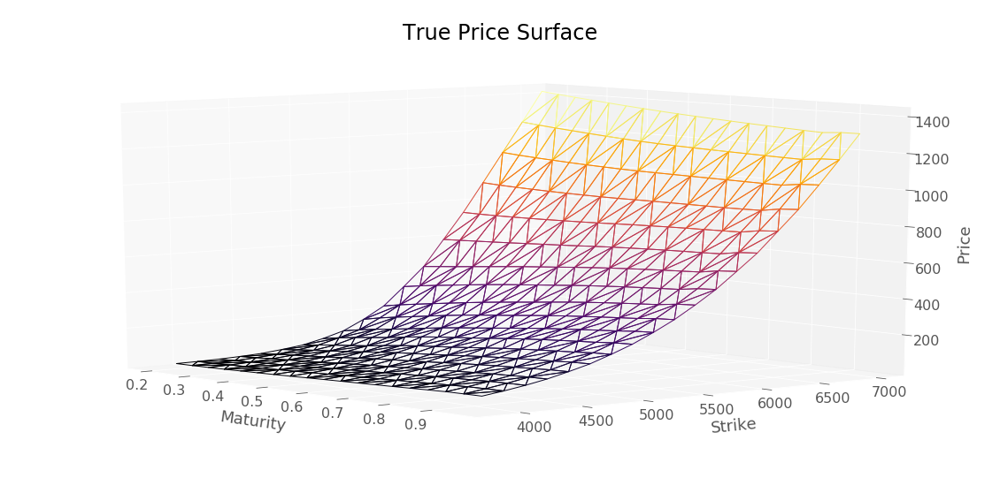

In [77]:
plotSerie(dataSetTest[dataSetTest.Maturity > 0]["Price"], Title = 'True Price Surface')

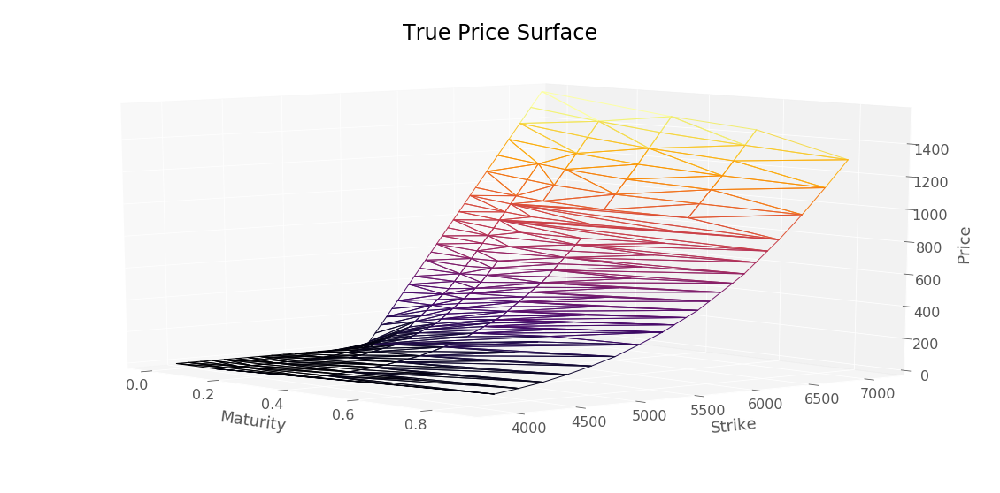

In [78]:
plotSerie(dataSet["Price"], Title = 'True Price Surface')

In [79]:
inverseTransform(scaledDataSet, scaler).head()

Price     Delta        Vega  Delta Strike  Gamma Strike  \
Strike Maturity                                                             
3600   0.000      0.000 -0.000000    0.000000      0.000000  0.000000e+00   
       0.118      0.127 -0.000483    3.261597      0.000968 -2.354589e-06   
       0.367      4.598 -0.011236   98.514055      0.024772 -1.301400e-05   
       0.597     15.777 -0.027223  267.303097      0.063405 -9.273793e-06   
       0.866     31.692 -0.042916  467.980902      0.104558  5.293411e-07   

                      Theta  ChangedStrike  DividendFactor  Strike  Maturity  \
Strike Maturity                                                                
3600   0.000       0.000000    3600.000000        1.000000  3600.0     0.000   
       0.118       4.842677    3582.378101        0.999581  3600.0     0.118   
       0.367      56.078839    3545.413828        0.999412  3600.0     0.367   
       0.597     100.196151    3514.295053        0.998833  3600.0     0.597   
       0.866     124.311979    3473.162627        1.000042  3600.0     0.866   

                 ImpliedVol     VegaRef  logMoneyness  impliedTotalVariance  \
Strike Maturity                                                               
3600   0.000          0.000    0.000000     -0.426044              0.000000   
       0.118          0.388    0.002070     -0.430951              0.150544   
       0.367          0.334   15.263747     -0.441323              0.111556   
       0.597          0.324   89.379652     -0.450139              0.104976   
       0.866          0.316  224.778094     -0.461913              0.099856   

                   locvol  
Strike Maturity            
3600   0.000     0.342450  
       0.118     0.396889  
       0.367     0.399936  
       0.597     0.392773  
       0.866     0.416986

In [80]:
#Plot predicted value, benchmark value, absoluate error and relative error
#It also compute RMSE between predValue and refValue
#predValue : approximated value 
#refValue : benchamrk value
#quantityName : name for approximated quantity
#az : azimuth i.e. angle of view for surface
#yMin : minimum value for y axis
#yMax : maximum value for y axis
def predictionDiagnosis(predValue, 
                        refValue, 
                        quantityName, 
                        az=320,
                        yMin = KMin,
                        yMax = KMax):
  
  predValueFiltered = predValue[predValue.index.get_level_values("Maturity") > 0.001]
  refValueFiltered = refValue[refValue.index.get_level_values("Maturity") > 0.001]
  title = "Predicted " + quantityName + " surface"
  plotSerie(predValueFiltered.rename(quantityName), 
            Title = title, 
            az=az,
            yMin = yMin,
            yMax = yMax)
  
  title = "True " + quantityName + " surface"
  plotSerie(refValueFiltered.rename(quantityName), 
            Title = title, 
            az=az,
            yMin = yMin,
            yMax = yMax)
  
  title = quantityName + " surface error"
  absoluteError = np.abs(predValueFiltered - refValueFiltered) 
  plotSerie(absoluteError.rename(quantityName + " Absolute Error"),
            Title = title,
            az=az,
            yMin = yMin,
            yMax = yMax)
  
  title = quantityName + " surface error"
  relativeError = np.abs(predValueFiltered - refValueFiltered) / refValueFiltered
  plotSerie(relativeError.rename(quantityName + " Relative Error (%)"),
            Title = title,
            az=az,
            yMin = yMin,
            yMax = yMax, 
            zAsPercent = True)
  
  print("RMSE : ", np.sqrt(np.mean(np.square(absoluteError))) )
  
  return

#Diagnose Price, theta, gamma and local volatility
def modelSummary(price, 
                 volLocale, 
                 delta_T, 
                 gamma_K, 
                 benchDataset,
                 sigma=0.3, 
                 az=40,
                 yMin = KMin,
                 yMax = KMax):
  priceRef = benchDataset["Price"]
  predictionDiagnosis(price, 
                      priceRef, 
                      "Price",
                      az=320,
                      yMin = yMin,
                      yMax = yMax)
  
  volLocaleRef = benchDataset["locvol"]
  predictionDiagnosis(volLocale, 
                      volLocaleRef, 
                      "Local volatility",
                      az=az,
                      yMin = yMin,
                      yMax = yMax)
  
  dTRef = benchDataset["Theta"]
  predictionDiagnosis(delta_T, 
                      dTRef, 
                      "Theta",
                      az=340,
                      yMin = yMin,
                      yMax = yMax)
  
  gKRef = benchDataset["Gamma Strike"]
  predictionDiagnosis(gamma_K, 
                      gKRef, 
                      "Gamma Strike",
                      az=340,
                      yMin = yMin,
                      yMax = yMax)
  return
  

### Implied volatility function calibration by bissection

In [81]:
def bs_price(cp, s, k, rf, t, v, div):
        """ Price an option using the Black-Scholes model.
        cp: +1/-1 for call/put
        s: initial stock price
        k: strike price
        t: expiration time
        v: volatility
        rf: risk-free rate
        div: dividend
        """
    
        d1 = (np.log(s/k)+(rf-div+0.5*v*v)*t)/(v*np.sqrt(t))
        d2 = d1 - v*np.sqrt(t)

        optprice = (cp*s*np.exp(-div*t)*st.norm.cdf(cp*d1)) - (cp*k*np.exp(-rf*t)*st.norm.cdf(cp*d2))
        
        return optprice

def bissectionMethod(S_0, r, q, implied_vol0, maturity, Strike, refPrice, epsilon):
    calibratedSigma = implied_vol0
    #Call black-scholes price function for initial value
    priceBS = bs_price(-1 ,S0, Strike, r, maturity, calibratedSigma, q)
    sigmaUp = 2.0
    sigmaInf = epsilon
    lossSerie = []
    
    priceMax = bs_price(-1 ,S0, Strike, r, maturity, sigmaUp, q)
    if priceMax < refPrice:
        return priceMax, sigmaUp, pd.Series(lossSerie)
    
    priceMin = bs_price(-1 ,S0, Strike, r, maturity, sigmaInf, q)
    if priceMin > refPrice:
        return priceMin, sigmaInf, pd.Series(lossSerie) 

    #Stop the optimization when the error is less than epsilon
    while(abs(priceBS - refPrice) > epsilon):
        #Update the upper bound or the lower bound 
        #by comparing calibrated price and the target price 
        if priceBS < refPrice : 
            sigmaInf = calibratedSigma
        else :
            sigmaUp = calibratedSigma
        #Update calibratedSigma
        calibratedSigma = (sigmaUp + sigmaInf) / 2
        #Update calibrated price
        priceBS = bs_price(-1 ,S0, Strike, r, maturity, calibratedSigma, q)
        #Record the calibration error for this step
        lossSerie.append(abs(priceBS - refPrice)) 
        
    return priceBS, calibratedSigma, pd.Series(lossSerie)

In [82]:
#Execute calibration of implied volatility from estimated price and benchmark price
#Then plot esitmated implied vol, absolute and relative error
def plotImpliedVol(priceSurface, 
                   refImpliedVol, 
                   rIntegralSpline = None, 
                   qIntegralSpline = None, 
                   az=40,
                   yMin = KMin,
                   yMax = KMax,
                   relativeErrorVolMax = 10):
    return plotImpliedVolConcrete(priceSurface[priceSurface.index.get_level_values("Maturity") > 0.001],
                                  refImpliedVol[refImpliedVol.index.get_level_values("Maturity") > 0.001],
                                  rIntegralSpline = rIntegralSpline,
                                  qIntegralSpline = qIntegralSpline,
                                  az=az,
                                  yMin = yMin,
                                  yMax = yMax,
                                  relativeErrorVolMax = relativeErrorVolMax)

def plotImpliedVolConcrete(priceSurface,
                           refImpliedVol,
                           rIntegralSpline = None,
                           qIntegralSpline = None,
                           az=40,
                           yMin = KMin,
                           yMax = KMax,
                           relativeErrorVolMax = 10):
    df = priceSurface.index.to_frame()
    df["Price"] = priceSurface

    epsilon = 1e-9
    calibrationFunction = lambda x : bissectionMethod(S0, 
                                                      rIntegralSpline(x["Maturity"])/x["Maturity"] if (rIntegralSpline is not None) else r, 
                                                      qIntegralSpline(x["Maturity"])/x["Maturity"] if (qIntegralSpline is not None) else q, 
                                                      0.2, 
                                                      x["Maturity"], 
                                                      x["Strike"], 
                                                      x["Price"], 
                                                      epsilon)[1]

    impliedVol = df.apply(calibrationFunction, axis = 1).rename("Implied Volatility")
    impliedVolError = np.abs(impliedVol-refImpliedVol).rename('Absolute Error')
    relativeImpliedVolError = (impliedVolError / refImpliedVol).rename("Relative error (%)")
    
    plotSerie(impliedVol, 
              Title = 'Implied volatility surface', 
              az=az,
              yMin = yMin,
              yMax = yMax)

    plotSerie(impliedVolError, 
              Title = 'Implied volatility error', 
              az=az,
              yMin = yMin,
              yMax = yMax)
    
    plotSerie(relativeImpliedVolError.clip(0,relativeErrorVolMax / 100.0), 
              Title = 'Implied volatility relative error', 
              az=az,
              yMin = yMin,
              yMax = yMax,
              zAsPercent = True)
  
    print("Implied volalitity RMSE : ", np.sqrt(np.mean(np.square(impliedVolError))) )

    return impliedVol

In [83]:
%matplotlib inline

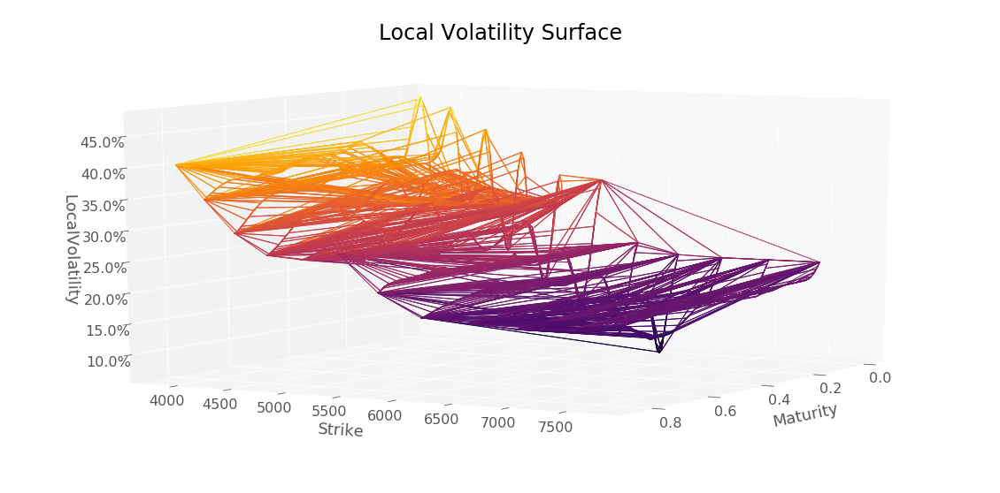

In [84]:
plotSerie(localVolatility["LocalVolatility"],
          Title = 'Local Volatility Surface',
          az=30,
          yMin=0.7*S0,
          yMax=1.4*S0, zAsPercent=True)

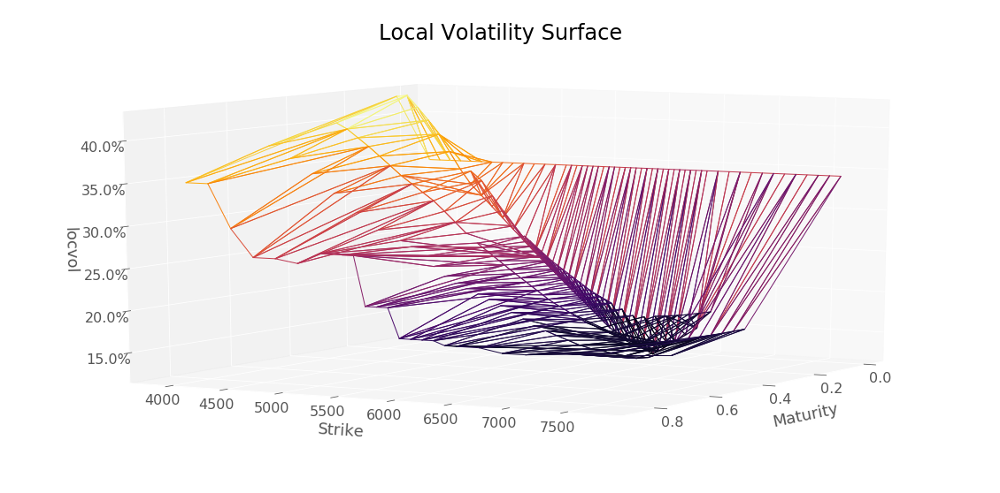

In [85]:
plotSerie(dataSet["locvol"],
          Title = 'Local Volatility Surface',
          az=30,
          yMin=0.7*S0,
          yMax=1.4*S0, zAsPercent=True)

In [86]:
dataSet["locvol"].head()

Strike  Maturity
3600    0.000       0.342450
        0.118       0.396889
        0.367       0.399936
        0.597       0.392773
        0.866       0.416986
Name: locvol, dtype: float64

# SSVI Model

In [87]:
import scipy

In [88]:
def blsprice(close, strike, interest_interp, tau_interp, implied_volatility) :
    return generalizedGreeks(-1, close, strike , 
                             riskCurvespline(tau_interp), 
                             tau_interp, 
                             implied_volatility, 
                             divSpline(tau_interp), 
                             riskFreeIntegral(tau_interp),
                             divSpreadIntegral(tau_interp))[0]

def blsimpv(close, K_t, interest_interp, tau_interp, call_price, l):
    epsilon = 1e-9
    dichotomy = lambda x : bissectionMethod(close, 
                                            riskFreeIntegral(tau_interp)/tau_interp, 
                                            divSpreadIntegral(tau_interp)/tau_interp, 
                                            0.2, tau_interp, x[0], 
                                            x[1], epsilon)[1]
    
    data = np.vstack([K_t, call_price]).T
    #data = pd.DataFrame(np.vstack([K_t, call_price]).T, 
    #                    columns = ["Strike","Price"])
    return np.apply_along_axis(dichotomy,1, data)

In [89]:
np.vstack(([0,1,3], [0,1,4])).T

array([[0, 0],
       [1, 1],
       [3, 4]])

In [90]:
def isempty(l):
    return ((l is None) or (numel(l)==0))

def norm(x):
    return np.sqrt(np.sum(np.square(x)))

def error(message):
    raise Exception(message)
    return 

def _assert(predicate, message):
    assert predicate, message
    return

def ismember(elt, l):
    return np.isin(elt, l)

def sqrt(x):
    return np.sqrt(x)

def sign(x):
    return np.sign(x)

def numel(l):
    if type(l)==np.float :
        return 1
    return len(l) if (type(l)==type([]) or type(l)==type(())) else l.size

def ones(shape):
    return np.ones(shape)

def size(array, dim = None):
    return numel(array) if (dim is None) else array.shape[dim] 
    
def isequal(*args):
    return (len(set(args)) <= 1)

def exp(x):
    return np.exp(x)

def unique(x):
    return np.unique(x)

def zeros(x):
    return np.zeros(x)

def idxmin(x):
    return np.unravel_index(np.argmin(x), x.shape)


def fit_ssvi(phifun=None, log_moneyness=None, theta_expanded=None, total_implied_variance=None):
    lb = np.array([-1, 0])
    ub = np.array([1, np.inf])
    c = lambda x: mycon(x, phifun)
    #options = optimset('fmincon')
    #options = optimset(options, 'algorithm', 'interior-point')
    #options = optimset(options, 'Display', 'off')
    targetfun = lambda x: fitfunctionSSVI(x, phifun, log_moneyness, theta_expanded, total_implied_variance)
    # perform optimization N times with random start values
    N = 100
    parameters = np.zeros((size(lb), N))
    funValue = np.zeros((N, 1))
    for n in np.arange(N):
        param0 = generateRandomStartValues(lb, ub)
        #parameters[:, n], funValue[n,1] = fmincon(targetfun, param0, 
        #                                          [], [], [], [], 
        #                                          lb, ub, c, options)
        constraints = (scipy.optimize.NonlinearConstraint(c, 
                                                          -np.inf, 0, 
                                                          keep_feasible=False))
        res = scipy.optimize.minimize(targetfun, param0, 
                                      method="L-BFGS-B", #"trust-constr",#"COBYLA",  
                                      bounds=list(zip(lb, ub)),#[lb, ub],
                                      constraints = constraints) 
        parameters[:, n] = res.x
        funValue[n,0] = res.fun
    
    idMin = idxmin(funValue) 
    parameters = parameters[:, idMin[0]]
    if phifun == 'power_law':
        parameters = np.concatenate((parameters, [0.5]))
    #print("parameters", parameters)
    #print("idMin", idMin)
    #print("res.x", res.x)
    #print("res.fun", res.fun)
    return parameters

def fitfunctionSSVI(x=None, phifun=None, log_moneyness=None, theta=None, total_implied_variance=None):
    # extract parameters from x
    rho = x[0]
    __switch_0__ = phifun
    if __switch_0__ == 'heston_like':
        phi_param = x[1]
    elif __switch_0__ == 'power_law':
        phi_param = [x[1], 0.5]
    else:
        raise Exception('Incorrect function for phi') 
    model_total_implied_variance, _ = svi_surface(log_moneyness, theta, rho, 
                                                  phifun, phi_param, 
                                                  np.ones_like(log_moneyness))
    value = norm(total_implied_variance - model_total_implied_variance)
    return value

def mycon(x=None, phifun=None):
    ceq = 0
    __switch_0__ = phifun
    if __switch_0__ == 'heston_like':
        c = 1 + abs(x[0]) - 4 * x[1]    #by construction, rho is the first parameter, lamda the second
    elif __switch_0__ == 'power_law':
        c = x[1] * (1 + abs(x[0])) - 2    #by construction, rho is the first parameter, lamda the second
    else:
        raise Exception('Incorrect function for phi') 
    return (c, ceq)


def generateRandomStartValues(lb=None, ub=None):
    # function to generate random intial values for the parameters
    lb[~ np.isfinite(lb)] = -1000
    ub[~ np.isfinite(ub)] = 1000
    param0 = lb + np.random.rand(size(lb)) * (ub - lb)
    return param0


In [91]:
list(zip([1,2,3], [4,5,6]))

[(1, 4), (2, 5), (3, 6)]

In [92]:
def fit_svi(x0=None, k=None, 
            total_implied_variance=None, 
            slice_before=None, slice_after=None, 
            tau=None,
            gridPenalization = None,
            param_slice_before = None,
            param_slice_after = None):
    # fit_svi fits a volatility slice to observed implied volatilities. 
    # get variable bounds
    large = 1e5
    small = 1e-6
    lb = [small, -large, small, small, small]
    ub = [large, large, large, large, large]
    targetfun = lambda x: fitfunctionSVI(x, k, 
                                         total_implied_variance, 
                                         slice_before, slice_after, 
                                         tau,
                                         gridPenalization,
                                         param_slice_before, 
                                         param_slice_after)
    # only optimize first three variables, final two are set by no-arbitrage condition
    x0 = x0[:3]
    lb = lb[:3]
    ub = ub[:3]
    # linear inequality: -p <= 2*psi
    A = np.array([0 , -2, -1])
    b = 0
    #print("slice_before",slice_before)
    parameters = None
    fval = np.inf
    constraints = (scipy.optimize.LinearConstraint(np.expand_dims(A, axis=0), 
                                                   b-small, b+small, 
                                                   keep_feasible=False))
    nbRestart = 50
    for i in np.arange(nbRestart):
        res = scipy.optimize.minimize(targetfun, x0, 
                                      method="L-BFGS-B", #"trust-constr",#"COBYLA", 
                                      bounds=list(zip(lb, ub)),#[lb, ub],
                                      constraints = constraints) 
        #res = fmincon(targetfun, x0, A, b, [], [], lb, ub, [], options)
        if (i==0) or (fval > res.fun) :
            fval =  res.fun
            parameters = res.x
    
    # use ga to find solution if optimizer gets stuck
    #if fval >= 1e6:
    #    res1 = scipy.optimize.differential_evolution(targetfun, 
    #                                                 list(zip(lb, ub)),#[lb, ub],
    #                                                 init = [x0])#, constraints = constraints)
    #    fval =  res1.fun
    #    parameters = res1.x
    #else:
    #    res1 = scipy.optimize.differential_evolution(targetfun, 
    #                                                 list(zip(lb, ub)),#[lb, ub],
    #                                                 init = [x0, parameters])#, constraints = constraints)
    #    fval =  res1.fun
    #    parameters = res1.x
    
    return parameters

def fitfunctionSVI(x=None, k=None, 
                   total_implied_variance=None, 
                   slice_before=None, slice_after=None, 
                   tau=None,
                   gridPenalization = None,
                   param_slice_before = None,
                   param_slice_after = None):
    # fitfunction is the objective function of the minimization of fit_svi. The objective is the 2-norm
    # of the error in total implied variance. If specified, the function tests whether the current total
    # variance slice lies between the prior and later slice. If the arbitrage bound is violated, the
    # function is penalized with a very large value.
    #
    # Input:
    # * x = (5x1) = parameters of SVI model
    # * k = (Nx1) = log moneyness at which total implied variance is calculated
    # * total_implied_variance = (Nx1) = market observed total implied variance
    # * slice_before = (Nx1) = total implied variance with smaller maturity than current slice
    # * slice_after = (Nx1) = total implied variance with larter maturity than current slice
    #
    # Output:
    # * value
    # check that input is consistent
    _assert(numel(k) == numel(total_implied_variance), 
            'moneyness and total implied variance need to have the same size')
    if not isempty(slice_before):
        _assert((numel(k) == numel(slice_before)), 
                'moneyness and slice_before need to have the same size')
    
    if not isempty(slice_after):
        _assert((numel(k) == numel(slice_after)), 
                'moneyness and slice_after need to have the same size')
    
    # expand x
    x3 = x[2] + 2 * x[1]
    x4 = x[0] * 4 * x[2] * x3 / (x[2] + x3) ** 2
    newX = np.concatenate((x, np.array([x3,x4]))) 
    # calculate model total implied variance given current parameter estimate
    model_total_implied_variance,_ = svi_jumpwing(k, newX, tau)
    # calculate value of objective function
    value = norm(total_implied_variance - model_total_implied_variance)
    # if the current model total implied variance crosses the earlier or later slice, set value to 1e6
    if not isempty(slice_before) and any(model_total_implied_variance < slice_before):
        value = 1e6
    
    if not isempty(slice_after) and any(model_total_implied_variance > slice_after):
        value = 1e6
    
    if np.isnan(value):
        value = 1e6
    
    if not isempty(gridPenalization) and ((not isempty(param_slice_before)) or 
                                          (not isempty(param_slice_after))):
        model_total_implied_variance,_ = svi_jumpwing(gridPenalization, newX, tau)
        
        if not isempty(param_slice_before):
            before_total_implied_variance,_ = svi_jumpwing(gridPenalization, param_slice_before, tau)
            if any(model_total_implied_variance < before_total_implied_variance) :
                value = 1e6    
                
        if not isempty(param_slice_after):
            after_total_implied_variance,_ = svi_jumpwing(gridPenalization, param_slice_after, tau)
            if any(model_total_implied_variance > after_total_implied_variance) :
                value = 1e6    
    
    return value


In [93]:
l = np.array([1,2,3,4,5,3,3,5,6])
l[l==5]

array([5, 5])

In [94]:
np.concatenate((l, np.array([11,12])))

array([ 1,  2,  3,  4,  5,  3,  3,  5,  6, 11, 12])

In [95]:
l = np.array([[1,2,3], [4,5,6], [7,8,9]])
l[:2,2] = 10
l

array([[ 1,  2, 10],
       [ 4,  5, 10],
       [ 7,  8,  9]])

In [96]:
def interp1(x, v, xq, method, extrapolationMethod):
    if method=="linear":
        funInter = scipy.interpolate.interp1d(x, v, 
                                              kind=method,
                                              fill_value="extrapolate")
    else :
        funInter = scipy.interpolate.PchipInterpolator(x, v, extrapolate=(extrapolationMethod == "extrapolate"))
    
    return funInter(xq)
    
def fit_svi_surface(implied_volatility=None, maturity=None, log_moneyness=None, phifun=None):
    #fit_svi_surface calibrates the SVI surface to market data. First, the entire Surface SVI is fitted
    #to all log-moneyness-theta observations. Second, each slice is fitted again using the SSVI fit as
    #initial guess.
    #
    # Input:
    # * impliedvolatility, maturity, moneyness, phi
    # Output:
    # * parameters = (2x1) = parameters of SSVI = [rho, lambda]
    # * theta      = (Tx1) = ATM total implied variance
    # * maturities = (Tx1) = corresponding time to maturity
    # step one: estimate total implied variance
    total_implied_variance = np.multiply(np.square(implied_volatility), maturity)
    # step two: use linear interpolation for ATM total implied variance
    maturities = np.sort(np.unique(maturity))
    T = size(maturities)
    theta = np.zeros(T)#np.zeros((T, 1))
    theta_expanded = np.zeros(size(maturity))
    for t in np.arange(T):
        pos = (maturity == maturities[t]) #position corresponding to a slice i.e. a smile
        tiv_t = total_implied_variance[pos]
        if np.isin(0, log_moneyness[pos]):
            theta[t] = tiv_t[log_moneyness[pos] == 0] #ATM total implied variance 
        else:#Interpolate ATM total implied variance from the smile
            theta[t] = interp1(log_moneyness[pos], tiv_t, 0, 'cubic', 'extrapolate') 
        
        theta_expanded[pos] = theta[t]
    

    # step three: fit SVI surface by estimating parameters = [rho, lambda] subject to parameter bounds:
    # -1 < rho < 1, 0 < lambda
    # and constraints: in heston_like: (1 + |rho|) <= 4 lambda, in power-law: eta(1+|rho|) <= 2
    parameters = fit_ssvi(phifun, 
                          log_moneyness, 
                          theta_expanded, 
                          total_implied_variance)
    parametersSSVI = parameters
    print("Parameters of SSVI model : ", parametersSSVI)
    
    rho = parameters[0]
    phi_param = parameters[1:]
    # step four: transform SSVI parameters to SVI-JW parameters
    __switch_0__ = phifun
    #print(phi_param)
    if __switch_0__ == 'heston_like':
        phi = heston_like(theta, phi_param)
    elif __switch_0__ == 'power_law':
        phi = power_law(theta, phi_param)
    else:
        raise Exception('Incorrect function for phi') 
    
    v = np.divide(theta, maturities)
    #print("v.shape", v.shape)
    #print("theta.shape", theta.shape)
    #print("maturities.shape", maturities.shape)
    psi = np.multiply(0.5 * rho * np.sqrt(theta),  phi)
    p = np.multiply(0.5 * np.sqrt(theta), phi * (1 - rho))
    c = p + 2 * psi
    vt = np.divide(np.multiply(v, (4 * np.multiply(p, c))), np.square((p + c)))
    gridPenalization = np.linspace(np.log(2000/S0[0]),
                                   np.log(9000/S0[0]), 
                                   num=200)
    
    #print()
    # step five: iterate through each maturity and fit c and vt for best fit
    parameters = np.zeros((5, T))
    for t in np.arange(T)[::-1]:
        pos = (maturity == maturities[t]) #position for the slice
        log_moneyness_t = log_moneyness[pos] 
        total_implied_variance_t = total_implied_variance[pos] #smile
        #
        if t == (T-1): 
            param_before = [v[t - 1], psi[t - 1], p[t - 1], c[t - 1], vt[t - 1]]
            slice_before,_ = svi_jumpwing(log_moneyness_t, param_before, maturities[t - 1])
            param_after = None
            slice_after = []
        elif t == 0:
            slice_before = []
            param_before = None
            param_after = [v[t + 1], psi[t + 1], p[t + 1], c[t + 1], vt[t + 1]]
            slice_after,_ = svi_jumpwing(log_moneyness_t, param_after, maturities[t + 1])
        else:
            param_before = [v[t - 1], psi[t - 1], p[t - 1], c[t - 1], vt[t - 1]]
            slice_before,_ = svi_jumpwing(log_moneyness_t, param_before, maturities[t - 1])
            param_after = [v[t + 1], psi[t + 1], p[t + 1], c[t + 1], vt[t + 1]]
            slice_after,_ = svi_jumpwing(log_moneyness_t, param_after, maturities[t + 1])
        
        print("time step",t)
        param0 = [v[t], psi[t], p[t], c[t], vt[t]]
        parameters[:3, t] = fit_svi(param0,
                                    log_moneyness_t,
                                    total_implied_variance_t, 
                                    slice_before, slice_after, 
                                    maturities[t], 
                                    gridPenalization,
                                    param_before,
                                    param_after)
        parameters[3, t] = parameters[2, t] + 2 * parameters[1, t]
        parameters[4, t] = np.divide(parameters[0, t] * 4 * parameters[2, t] * parameters[3, t] ,
                                     np.square(parameters[2, t] + parameters[3, t])) 

    return parameters, theta, maturities, parametersSSVI

In [97]:
def fit_svi_surface_nonlin(x=None):
    ceq = np.zeros((2, 1))
    c = np.zeros((5, 1))
    # c = p+2*psi
    ceq[0] = x[3] - x[2] - 2 * x[1]
    # vt = v*(4*p*c)/(p+c)^2
    ceq[1] = x[4] - (x[0] * 4 * x[2] * x[3]) / ((x[2] + x[3]) ** 2)
    # -p <= 2 psi
    c[0] = -x[2] - 2 * x[1]
    # 2 psi <= c
    c[1] = 2 * x[1] - x[3]
    # vt <= v
    c[2] = x[4] - x[0]
    # -p <= 2psi
    c[3] = -x[2] - 2 * x[1]
    # 2psi <= c
    c[4] = 2 * x[1] - c[3]
    return c, ceq 

def heston_like(theta=None, param=None):
    # Heston-like parameterization
    _lambda = param#[0]
    value = np.multiply(1. / (_lambda * theta), 
                        np.divide(1 - (1 - exp(-_lambda * theta)), (_lambda * theta)))
    return value

def power_law(theta=None, param=None):
    # Power-law parameterization
    eta = param[0]
    gamma = param[1]
    value = np.divide(eta, 
                      np.multiply(np.power(theta, (gamma)), 
                                  np.power((1 + theta), (1 - gamma))))
    return value 

def svi(parameterization=None, k=None, param=None, tau=None):
    #SVI - Stochastic Volatility Inspired parameterization of the implied
    #volatility smile.
    # Input:
    # * parameterization = string = one of: raw, natural, or jumpwing
    # * k = (Nx1) = log-moneyness at which to evaluate the total implied
    # variance
    # * param = (5x1) = parameters:
    #   * a = scalar = level of variance
    #   * b = scalar = slope of wings
    #   * m = scalar = translates smile to right
    #   * rho = scalar = counter-clockwise rotation of smile
    #   * sigma = scalar = reduces ATM curvature of the smile
    # Output:
    # * totalvariance = (Nx1) = estimated total variance at k
    # * impliedvolatility = (Nx1) = estimated implied volatility at (k,tau)
    __switch_0__ = parameterization
    if __switch_0__ == 'raw':
        [totalvariance, impliedvolatility] = svi_raw(k, param, tau)
    elif __switch_0__ == 'natural':
        [totalvariance, impliedvolatility] = svi_natural(k, param, tau)
    elif __switch_0__ == 'jumpwing':
        [totalvariance, impliedvolatility] = svi_jumpwing(k, param, tau)
    else:
        raise Exception('Unknown parameterization specified') 
        
    return totalvariance, impliedvolatility


In [98]:


def svi_convertparameters(param_old=None, _from=None, to=None, tau=None):
    #svi_convertparameters converts the parameter set of one type of SVI
    #formulation to another. The parameterizations are assumed to be:
    # * raw =(a,b,m,rho, sigma)
    # * natural = (delta, mu, rho, omega, zeta)
    # * jumpwing = (v, psi, p, c, vt)
    #
    # Input:
    # * param_old = (5x1) = original parameters
    # * from = string = formulation of original parameters (raw, natural,
    # jumpwing)
    # * to = string = formulation of new parameters (raw, natural, jumpwings)
    #
    # Output:
    # param_new = (5x1) = new parameters
    # test that input is correct
    _assert(numel(param_old) == 5, ('There have to be five original parameters'))
    if not ((_from == 'raw') or (_from == 'natural') or (_from == 'jumpwing')):
        error('from has to be one of: raw, natural, jumpwing')
    
    if not ((to == 'raw') or (to == 'natural') or (to == 'jumpwing')):
        error('from has to be one of: raw, natural, jumpwing')
    
    if ((to == 'jumpwing') or (_from == 'jumpwing')) and (tau is None):
        error('tau is required for tailwings formulation')
    
    __switch_0__ = _from
    if __switch_0__ == 'raw':
        a = param_old[0]
        b = param_old[1]
        m = param_old[2]
        rho = param_old[3]
        sigma = param_old[4]
        __switch_1__ = to
        if __switch_1__ == 'raw':
            param_new = param_old
        elif __switch_1__ == 'natural':
            omega = 2 * b * sigma / sqrt(1 - rho ** 2)
            delta = a - omega / 2 * (1 - rho ** 2)
            mu = m + rho * sigma / sqrt(1 - rho ** 2)
            zeta = sqrt(1 - rho ** 2) / sigma
            param_new = [delta, mu, rho, omega, zeta]
        elif __switch_1__ == 'jumpwing':
            w = a + b * (-rho * m + sqrt(m ** 2 + sigma ** 2))
            v = w / tau
            psi = 1 / np.sqrt(w) * b / 2 * (-m / sqrt(m ** 2 + sigma ** 2) + rho)
            p = 1 / np.sqrt(w) * b * (1 - rho)
            c = 1 / np.sqrt(w) * b * (1 + rho)
            vt = 1 / tau * (a + b * sigma * sqrt(1 - rho ** 2))
            param_new = [v, psi, p, c, vt]
        
    elif __switch_0__ == 'natural':

        __switch_1__ = to
        if __switch_1__ == 'raw':
            delta = param_old[0]
            mu = param_old[1]
            rho = param_old[2]
            omega = param_old[3]
            zeta = param_old[4]

            a = delta + omega / 2 * (1 - rho ** 2)
            b = omega * zeta / 2
            m = mu - rho / zeta
            sigma = np.sqrt(1 - rho ** 2) / zeta
            param_new = [a, b, m, rho, sigma]
        elif __switch_1__ == 'natural':
            param_new = param_old
        elif __switch_1__ == 'jumpwing':
            param_temp = svi_convertparameters(param_old, 'natural', 'raw', tau)
            param_new = svi_convertparameters(param_temp, 'raw', 'jumpwing', tau)
        
    elif __switch_0__ == 'jumpwing':

        __switch_1__ = to
        if __switch_1__ == 'raw':
            v = param_old[0]
            psi = param_old[1]
            p = param_old[2]
            c = param_old[3]
            vt = param_old[4]
            w = v * tau

            b = np.sqrt(w) / 2 * (c + p)
            rho = 1 - p * np.sqrt(w) / b
            beta = rho - 2 * psi * np.sqrt(w) / b
            alpha = np.sign(beta) * np.sqrt(1 / beta ** 2 - 1)
            m = ((v - vt) * tau / 
                 (b * (-rho + np.sign(alpha) * np.sqrt(1 + alpha ** 2) - alpha * np.sqrt(1 - rho ** 2))))
            #print("m",m)
            #print("tau",tau)
            #print("v",v)
            #print("vt",vt)
            #print("param_old", param_old)
            if m == 0:
                sigma = (vt * tau - w) / b / (sqrt(1 - rho ** 2) - 1)
            else:
                sigma = alpha * m
            
            a = vt * tau - b * sigma * np.sqrt(1 - rho ** 2)

            if sigma < 0:
                sigma = 0
            
            param_new = [a, b, m, rho, sigma]
        elif __switch_1__ == 'natural':
            param_temp = svi_convertparameters(param_old, 'jumpwing', 'raw', tau)
            param_new = svi_convertparameters(param_temp, 'raw', 'natural', tau)
        elif __switch_1__ == 'jumpwing':
            param_new = param_old
        
    return param_new


In [99]:
np.reshape([np.arange(5), np.arange(5) * 2, np.arange(5) * 3, np.arange(5) * 4],(4,5))[:, 3]

array([ 3,  6,  9, 12])

In [100]:
np.argwhere(np.array([1,2,3,4]) == 2)[0][0]

1

In [101]:
def svi_interpolation(log_moneyness=None, tau_interp=None, 
                      forward_interp=None, interest_interp=None, 
                      parameters=None, theta=None, maturities=None, 
                      forward_theta=None, interest_rate_theta=None):
    #svi_interpolation estimates inter/extrapolated SVI
    #
    #Input:
    # * log_moneyness = (Kx1) = log-moneyness at which to evalute volatility slices
    # * tau_interp = scalar = maturity at which to generate volatility slices
    # * forward_interp = scalar = forward prices corresponding to maturities
    # * interest_interp = scalar = interest rates corresponding to maturities
    # * parameters (5xL) = estimated parameters of SVI in jumpwing parameterization
    # * theta (Lx1) = ATM total variance time at which the parameters were estimated
    # * maturities (Lx1) = time to maturity corresponding to theta
    # * forward_theta = (Lx1) = forward prices corresponding to theta
    # * interest_rate_theta = (Lx1) = interest rates corresponding to theta (can be scalar)
    #
    #Output:
    # * total_implied_variance (Kx1) = total_implied_variances for each log_moneyness and tau_interp
    # * implied_volatility (Kx1) = implied volatilities corresponding to total_implied_variance
    # * call_price (Kx1) = call option prices correspongin to total_implied_variance
    #ensure column vectors
    log_moneyness = log_moneyness.flatten()
    theta = theta.flatten()
    maturities = maturities.flatten()
    forward_theta = forward_theta.flatten()
    interest_rate_theta = interest_rate_theta.flatten()
    #ensure scalar input
    _assert(type(tau_interp)==np.float, ('tau_interp has to be scalar'))
    _assert(type(forward_interp)==np.float, ('forward_interp has to be scalar'))
    _assert(type(interest_interp)==np.float, ('interest_interp has to be scalar'))
    #expand scalar input
    if numel(interest_rate_theta) == 1:
        interest_rate_theta = interest_rate_theta * ones(size(theta))
    
    # ensure correct size of input
    _assert(size(parameters, 1) == size(theta, 0), ('parameter set for each theta required'))
    _assert(isequal(size(theta), size(forward_theta), size(interest_rate_theta)), 
            ('theta, forward_theta, and interestrate_theta have to have the same size'))
    # estimate theta for interpolated maturity
    theta_interp = interp1(maturities, theta, tau_interp, 'cubic', 'extrapolate')
    close = S0[0]#np.multiply(forward_interp, exp(-interest_interp * tau_interp))
    if ismember(tau_interp, maturities):
        indexMaturity = np.argwhere(maturities == tau_interp)[0][0]
        total_implied_variance,_ = svi_jumpwing(log_moneyness, parameters[:, indexMaturity], tau_interp)
        implied_volatility = sqrt(total_implied_variance / tau_interp)
        strike = forward_interp * exp(log_moneyness)
        put_price = np.array(blsprice(close, strike, 
                                      interest_interp, 
                                      tau_interp, 
                                      implied_volatility))
    else:
        if min(maturities) < tau_interp and tau_interp < max(maturities):
            # interpolation
            idx = idxmin(abs(tau_interp - maturities))[0]
            # if closest maturity is smaller than tau_interp, make idx one unit larger --> idx is index of
            # smallest maturity larger than tau_interp
            if maturities[idx] < tau_interp:
                idx = idx + 1
            

            alpha_t = (sqrt(theta[idx]) - sqrt(theta_interp)) / (sqrt(theta[idx]) - sqrt(theta[idx - 1]))
            param_interp = alpha_t * parameters[:, idx - 1] + (1 - alpha_t) * parameters[:, idx]
            total_implied_variance,_ = svi_jumpwing(log_moneyness, param_interp, tau_interp)
            implied_volatility = sqrt(total_implied_variance / tau_interp)
            strike = forward_interp * exp(log_moneyness)
            put_price = np.array(blsprice(close, strike, 
                                          interest_interp, 
                                          tau_interp, 
                                          implied_volatility))
            put_price[put_price < 0] = 0
        elif tau_interp < min(maturities):
            # extrapolation for small maturities
            forward_0 = interp1(theta, forward_theta, 0, 'cubic', 'extrapolate')
            strike_1 = forward_0 * exp(log_moneyness)
            put_price_1 = np.maximum(strike_1 - close, 0)

            idx = 0
            total_implied_variance_2,_ = svi_jumpwing(log_moneyness, parameters[:, idx], maturities[idx])
            implied_volatility_2 = sqrt(total_implied_variance_2 / maturities[idx])
            strike_2 = forward_theta[idx] * exp(log_moneyness)
            put_price_2 = np.array(blsprice(close, strike_2, 
                                            interest_rate_theta[idx], 
                                            maturities[idx], 
                                            implied_volatility_2))
            put_price_2[put_price_2 < 0] = 0

            alpha_t = (sqrt(theta[idx]) - sqrt(theta_interp)) / sqrt(theta[idx])
            K_t = forward_interp * exp(log_moneyness)

            put_price = np.multiply(K_t, 
                                    (np.divide(alpha_t * put_price_1, strike_1) + 
                                     np.divide((1 - alpha_t) * put_price_2, strike_2)))
            implied_volatility = blsimpv(close, K_t, interest_interp, tau_interp, put_price, [])
            total_implied_variance = np.power(implied_volatility, 2) * tau_interp
        else:
            # extrapolation for large maturities
            total_implied_variance,_ = svi_jumpwing(log_moneyness, parameters[:, -1], maturities[-1])
            total_implied_variance = total_implied_variance + theta_interp - theta[-1]
            implied_volatility = sqrt(total_implied_variance / tau_interp)
            strike = forward_interp * exp(log_moneyness)
            put_price = np.array(blsprice(close, strike, 
                                          interest_interp, 
                                          tau_interp, 
                                          implied_volatility))
        
    return put_price, implied_volatility, total_implied_variance


In [102]:
def svi_jumpwing(k=None, param=None, tau=None):
    #SVI - Stochastic Volatility Inspired parameterization of the implied
    #volatility smile. This function implements the jump-wings formulation.
    # Input:
    # * k = (Nx1) = log-moneyness at which to evaluate the total implied
    # variance
    # * param = (5x1) = parameters:
    #   * v = scalar = ATM variance
    #   * psi = scalar = ATM skew
    #   * p = scalar = slope of left/put wing
    #   * c = scalar = slope of right/call wing
    #   * vt = scalar = minimum implied variance
    # Output:
    # * totalvariance = (Nx1) = estimated total variance at k
    # * impliedvolatility = (Nx1) = estimated implied volatility at (k,tau)
    # make sure that input is in column vector format
    k = k.flatten()
    # check that input is consistent
    _assert(numel(param) == 5, 'There have to be five parameters: v, psi, p, c, vt')
    if tau is None:
        error('tau needs to be specified for jump-wings formulation')
    
    v = param[0]
    p = param[2]
    c = param[3]
    vt = param[4]

    # make sure that parameter restrictions are satisfied
    # assert(v >= 0, 'v has to be non-negative');
    # assert(p >= 0, 'p has to be non-negative');
    # assert(c >= 0, 'c has to be non-negative');
    # assert(vt >= 0, 'vt has to be non-negative');
    # convert parameters to raw formulation
    param_raw = svi_convertparameters(param, 'jumpwing', 'raw', tau)
    # calculate total variance
    totalvariance, impliedvolatility = svi_raw(k, param_raw, tau)
    return totalvariance, impliedvolatility


def svi_natural(k=None, param=None, tau=None):
    #SVI - Stochastic Volatility Inspired parameterization of the implied
    #volatility smile. This function implements the natural formulation.
    # Input:
    # * k = (Nx1) = log-moneyness at which to evaluate the total implied
    # variance
    # * param = (5x1) = parameters:
    #   * delta = scalar = level of variance
    #   * mu = scalar = slope of wings
    #   * rho = scalar = translates smile to right,
    #   * omega = scalar = counter-clockwise rotation of smile
    #   * zeta = scalar = reduces ATM curvature of the smile
    # Output:
    # * totalvariance = (Nx1) = estimated total variance at k
    # * impliedvolatility = (Nx1) = estimated implied volatility at (k,tau)
    # make sure that input is in column vector format
    k = k.flatten()
    # check that input is consistent
    _assert(numel(param) == 5, 'There have to be five parameters: a, b, m, rho, sigma')
    if tau is None:
        error('tau needs to be specified in order to return implied volatilities')
    
    delta = param[0]
    mu = param[1]
    rho = param[2]
    omega = param[3]
    zeta = param[4]
    # make sure that parameter restrictions are satisfied
    _assert(omega >= 0, 'omega has to be non-negative')
    _assert(abs(rho) < 1, '|rho| has to be smaller than 1')
    _assert(zeta > 0, 'zeta has to be positive')
    _assert(delta + omega * (1 - rho ** 2) >= 0, 'delta + omega (1-rho^2) has to be non-negative')
    # calculate total variance
    totalvariance = delta + omega / 2 * (1 + zeta * rho * (k - mu) + 
                                         sqrt(np.square(zeta * (k - mu) + rho) + (1 - rho ** 2)))
    # if requested, calculate implied volatility
    impliedvolatility = sqrt(totalvariance / tau)
    return totalvariance, impliedvolatility


def svi_parameter_bounds(parameterization=None):
    # svi_parameter_bounds returns the parameter bounds of an SVI parameterization. The parameters are
    # assumed to be in the following order:
    # raw = [a b m rho sigma]
    # natural = [delta mu rho omega zeta]
    # jumpwing = [v psi p c vt]
    large = 1e5
    __switch_0__ = parameterization
    if 0:
        pass
    elif __switch_0__ == ('raw'):
        lb = [-large, 0 - large - 1, 0]
        ub = [large, large, large, 1, large]
    elif __switch_0__ == ('natural'):
        lb = [-large - large - 1, 0, 0]
        ub = [large, large, 1, large, large]
    elif __switch_0__ == ('jumpwing'):
        lb = [0 - large, 0, 0, 0]
        ub = [large, large, large, large, large]
    else:
        error('Unknown parameterization')
    return lb, ub

In [103]:
def svi_raw(k=None, param=None, tau=None):
    #SVI - Stochastic Volatility Inspired parameterization of the implied
    #volatility smile. This function implements the raw formulation.
    # Input:
    # * k = (Nx1) = log-moneyness at which to evaluate the total implied
    # variance
    # * param = (5x1) = parameters:
    #   * a = scalar = level of variance
    #   * b = scalar = slope of wings
    #   * m = scalar = translates smile to right
    #   * rho = scalar = counter-clockwise rotation of smile
    #   * sigma = scalar = reduces ATM curvature of the smile
    # Output:
    # * totalvariance = (Nx1) = estimated total variance at k
    # * impliedvolatility = (Nx1) = estimated implied volatility at (k,tau)
    # make sure that input is in column vector format
    k = k.flatten()
    # check that input is consistent
    _assert(numel(param) == 5, ('There have to be five parameters: a, b, m, rho, sigma'))
    if tau is None:
        error('tau needs to be specified in order to return implied volatilities')
    
    a = param[0]
    b = param[1]
    m = param[2]
    rho = param[3]
    sigma = param[4]

    # make sure that parameter restrictions are satisfied
    # assert(b >= 0, 'b has to be non-negative');
    # assert(abs(rho) <= 1, '|rho| has to be smaller than 1');
    # assert(sigma >= 0, 'sigma has to be positive');
    # assert(a + b*sigma*sqrt(1-rho^2)>=0, 'a + b sigma (1-rho^2)^0.5 has to be non-negative');
    # calculate total variance
    totalvariance = a + b * (rho * (k - m) + sqrt(np.square(k - m) + sigma ** 2))
    # if requested, calculate implied volatility
    impliedvolatility = sqrt(totalvariance / tau)
    return totalvariance, impliedvolatility



In [104]:
def svi_surface(k=None, theta=None, rho=None, phifun=None, phi_param=None, tau=None):
    #svi_surface calcualtes the surface SVI free of statis arbitrage.
    #
    # Input:
    # * k = (Kx1) = moneyness at which to evaluate the surface
    # * theta = (Tx1) = ATM variance time at which to evaluate the surface.
    # If theta and k have the same dimensions, then the surface is evaluated 
    # for each given (k,theta) pair. If the dimensions are different, the 
    # function evaluates the surface on the grid given by k and theta
    # * param = (Xx1) = parameters of the surface
    #
    # Output:
    # * totalvariance = (KxT) or (Kx1) = estimated total variance
    # * impliedvolatility = (KxT) or (Kx1) = estimated implied volatility
    # ensure correct input
    k = k.flatten()
    theta = theta.flatten()
    _assert(numel(rho) == 1, 'rho has to be a scalar')
    if tau is None:
        error(('Implied volatility calculation requires tau'))
    
    #evaluate phi
    __switch_0__ = phifun
    if __switch_0__ == 'heston_like':
        phi = heston_like(theta, phi_param)
    elif __switch_0__ == 'power_law':
        phi = power_law(theta, phi_param)
    else:
        error('Incorrect function for phi')
    

    if isequal(size(k), size(theta)):
        totalvariance = np.multiply(theta / 2,
                                    (1 + rho * np.multiply(phi, k) + 
                                     sqrt( np.square(np.multiply(phi, k) + rho) + (1 - rho ** 2))) )
    else:
        T = size(theta)
        K = size(k)
        totalvariance = zeros((K, T))
        for t in np.arange(T):
            totalvariance[:, t] = np.multiply(theta[t] / 2,
                                              (1 + rho * phi[t] * k + 
                                               sqrt(np.square(np.multiply(phi[t], k) + rho) + (1 - rho ** 2))))
        
    
    if isequal(size(k), size(theta), size(tau)):
        impliedvolatility = sqrt(np.divide(totalvariance, tau))
    else:
        # expand tau
        tau_expanded = zeros(totalvariance.shape)
        maturities = unique(tau)
        T = size(maturities)
        for t in np.arange(T):
            tau_expanded[:, t] = maturities[t]
            
        impliedvolatility = sqrt(np.divide(totalvariance, tau_expanded))
        
    return totalvariance, impliedvolatility

def heston_like(theta=None, param=None):
    # Heston-like parameterization
    _lambda = param#[0]
    value = np.multiply(1. / (_lambda * theta), 
                        (1 - np.divide((1 - exp(-_lambda * theta)), 
                                       (_lambda * theta))))
    return value

def power_law(theta=None, param=None):
    # Power-law parameterization
    eta = param[0]
    gamma = param[1]
    value = np.divide(eta, np.multiply(np.power(theta, gamma), 
                                       np.power(1 + theta , 1 - gamma) ) )
    return value



In [105]:
dataSet = dataSet[dataSet["Maturity"] > 0]
dataSetTest = dataSetTest[dataSetTest["Maturity"] > 0]


In [106]:
parameters, theta, maturities, pSSVI = fit_svi_surface(dataSet["ImpliedVol"].values, 
                                                       dataSet["Maturity"].values, 
                                                       dataSet["logMoneyness"].values, 
                                                       'power_law')

/home/chataigner/anaconda3/lib/python3.7/site-packages/scipy/optimize/_minimize.py:520: RuntimeWarning: Method L-BFGS-B cannot handle constraints.
  RuntimeWarning)
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in sqrt


Parameters of SSVI model :  [-0.59350968  0.63144773  0.5       ]
time step 4


/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:89: RuntimeWarning: invalid value encountered in sqrt
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:91: RuntimeWarning: invalid value encountered in sqrt
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: invalid value encountered in sqrt
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:102: RuntimeWarning: invalid value encountered in less
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:117: RuntimeWarning: invalid value encountered in less


time step 3


/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: invalid value encountered in greater
/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:122: RuntimeWarning: invalid value encountered in greater


time step 2
time step 1
time step 0


In [107]:
dataSet["Forward"] = np.exp(-dataSet["logMoneyness"]) * dataSet["Strike"]
#round for float comparaison
forward_theta = (dataSet["Forward"][dataSet["Maturity"].isin(maturities)]
                 .round(decimals=9)
                 .droplevel("Strike")
                 .drop_duplicates()
                 .loc[maturities].values)
interestrate_theta = riskFreeIntegral(maturities)/maturities

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [108]:
tau_interp = 30/365.25

forward_interp = interp1(maturities, 
                         forward_theta, 
                         tau_interp, 
                         'cubic',
                         "extrapolate")
interest_interp = riskCurvespline(tau_interp)

In [109]:
interestrate_theta

array([0.04513418, 0.04474   , 0.04323402, 0.04231612, 0.04136923])

In [110]:
def interpolateGrid(df):
    impliedVolInterpolated = pd.Series()
    #print(df.head())
    for smile in df.rename({"Maturity" : "MaturityColumn"}, axis=1).groupby("MaturityColumn"):
        maturity = smile[0]
        tau_interp = maturity
        k = smile[1]["logMoneyness"].values
        forward_interp = interp1(maturities, 
                                 forward_theta, 
                                 tau_interp, 
                                 'cubic',
                                 "extrapolate")
        interest_interp = riskCurvespline(tau_interp)
        call_price, implied_volatility, total_implied_variance = svi_interpolation(k,
                                                                                   tau_interp, 
                                                                                   float(forward_interp), 
                                                                                   float(interest_interp), 
                                                                                   parameters, 
                                                                                   theta, 
                                                                                   maturities, 
                                                                                   forward_theta, 
                                                                                   interestrate_theta)
        impliedVolInterpolated = impliedVolInterpolated.append(pd.Series(implied_volatility, index=smile[1].index))

    index = pd.MultiIndex.from_tuples(impliedVolInterpolated.index.tolist(), 
                                      names=["Strike", "Maturity"])
    
    return pd.Series(impliedVolInterpolated.values, index=index).sort_index()
    

In [111]:
serie = interpolateGrid(dataSetTest[dataSetTest["Maturity"] > 0])

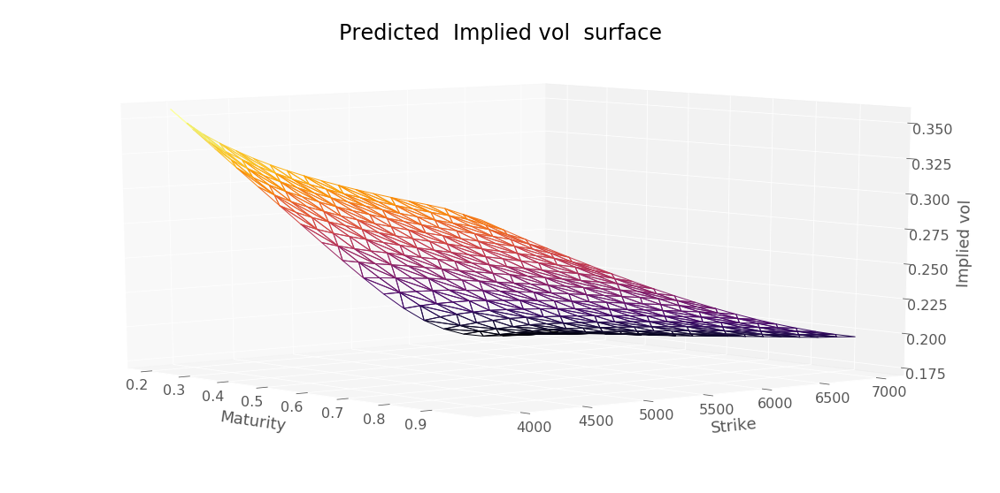

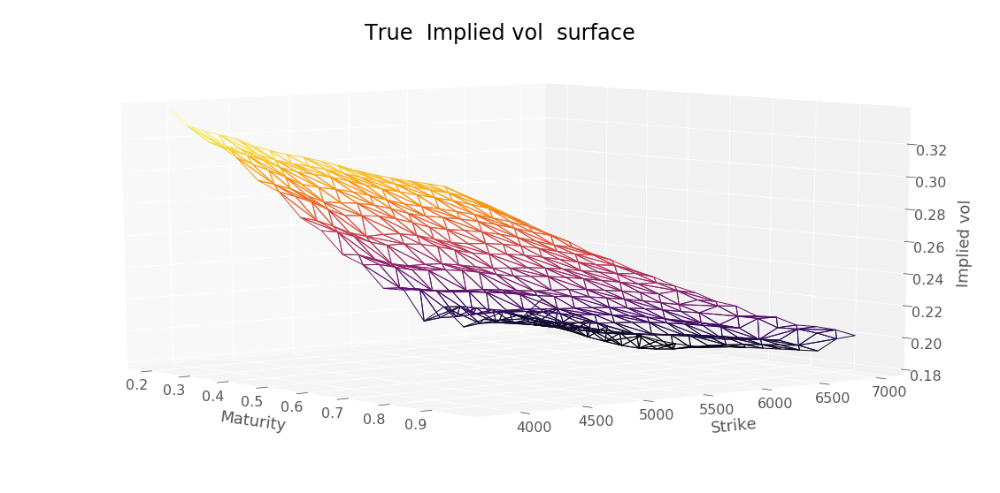

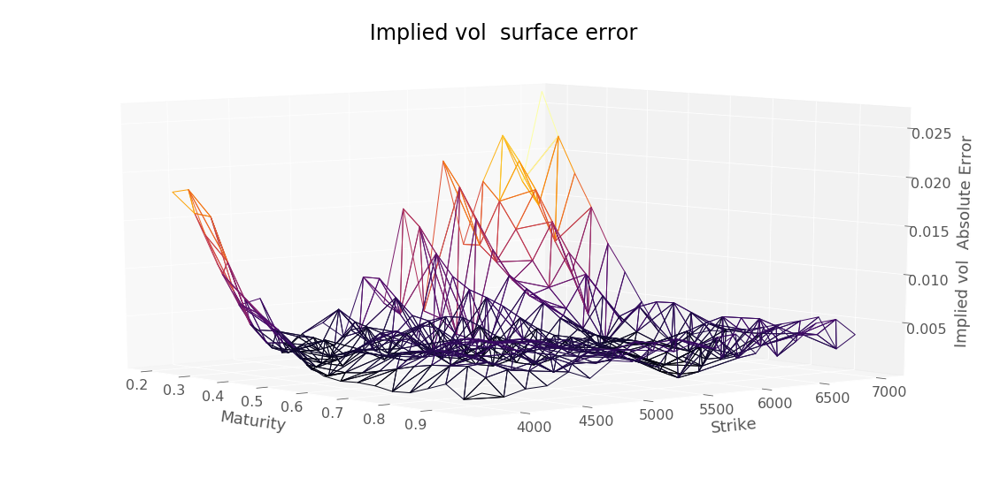

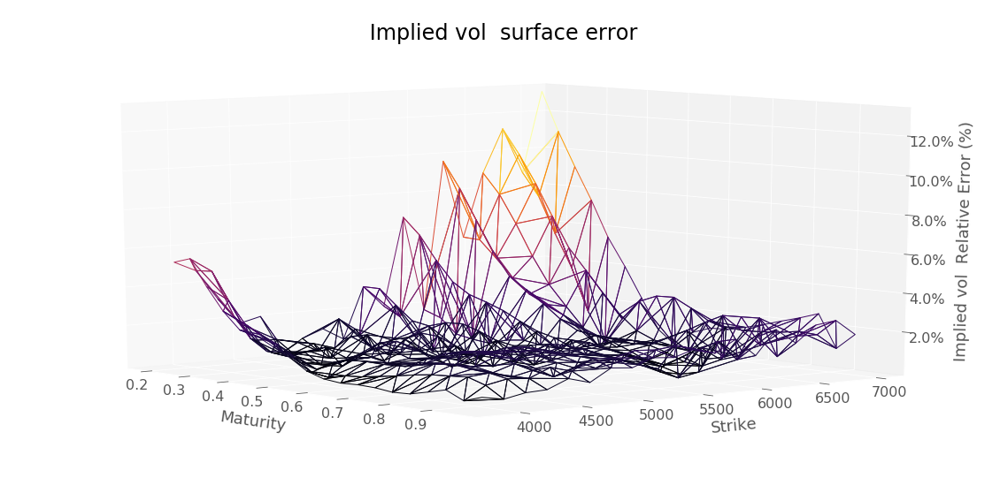

RMSE :  0.005670522504385141


In [112]:
predictionDiagnosis(serie, 
                    dataSetTest[dataSetTest["Maturity"] > 0]["ImpliedVol"], 
                    " Implied vol ", 
                    yMin=-1000)

In [113]:
def interpolateWithSSVI(df):
    logMoneyness = df[df["Maturity"] > 0]["logMoneyness"].values
    tau = df[df["Maturity"] > 0]["Maturity"].values
    impliedATMTotalVar = interp1(maturities, theta, tau, 'cubic', "extrapolate")
    impliedTotalVar, impliedVol =  svi_surface(k=logMoneyness, 
                                               theta=impliedATMTotalVar, 
                                               rho=pSSVI[0], 
                                               phifun="power_law", 
                                               phi_param=pSSVI[1:], 
                                               tau=tau)
    return pd.Series(impliedVol,index = df[df["Maturity"] > 0].index)

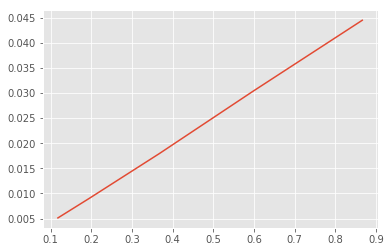

In [114]:
plt.plot(maturities, theta)#np.sqrt(theta/maturities))#theta)

In [115]:
dataSet[abs(dataSet.logMoneyness)<=0.01].ImpliedVol

Strike  Maturity
5500    0.118       0.216
5550    0.118       0.208
        0.195       0.215
        0.367       0.225
5600    0.195       0.217
        0.367       0.221
        0.597       0.227
5650    0.367       0.221
5700    0.597       0.224
        0.866       0.227
Name: ImpliedVol, dtype: float64

In [116]:
#serieDf = interpolateWithSSVI(dataSetTest)
serieDf = interpolateGrid(dataSetTest)

In [117]:
def impliedVariance(impVol, mat=None):
    Ts = impVol.index.get_level_values("Maturity") if mat is None else mat
    return np.square(impVol) * Ts

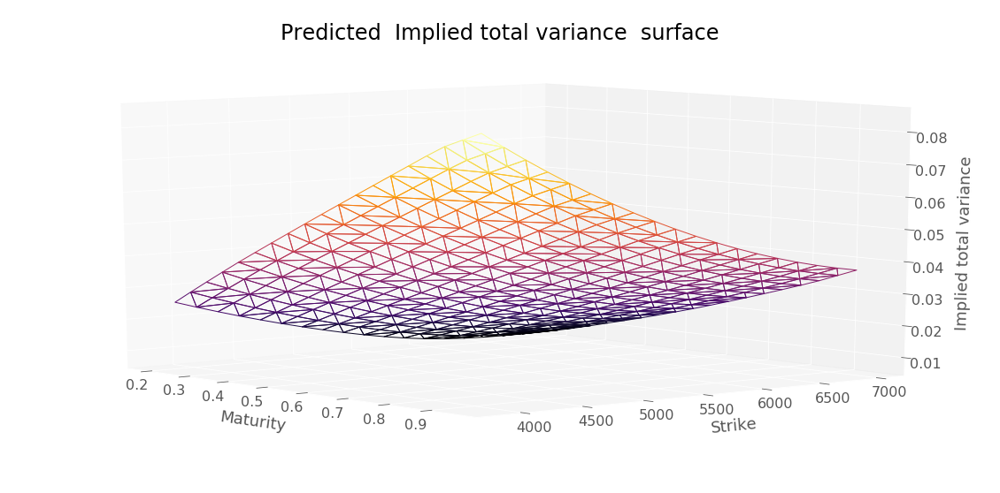

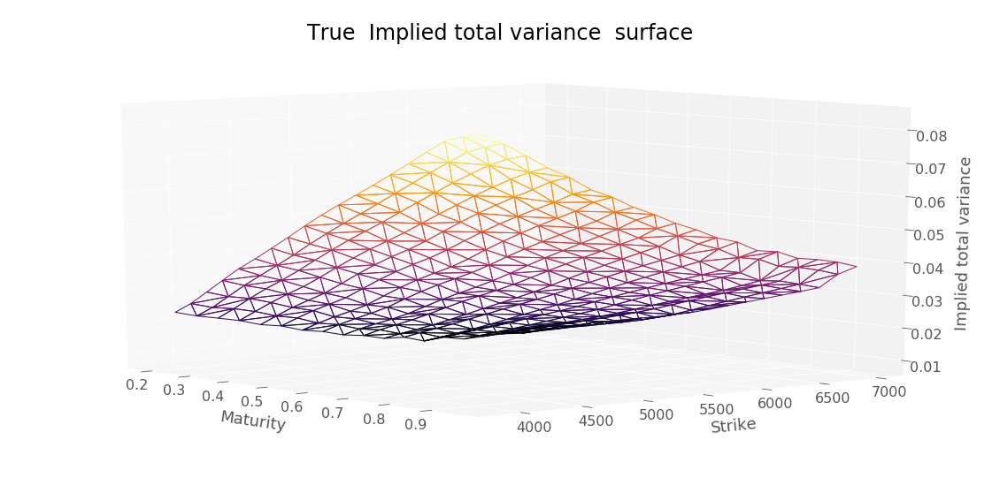

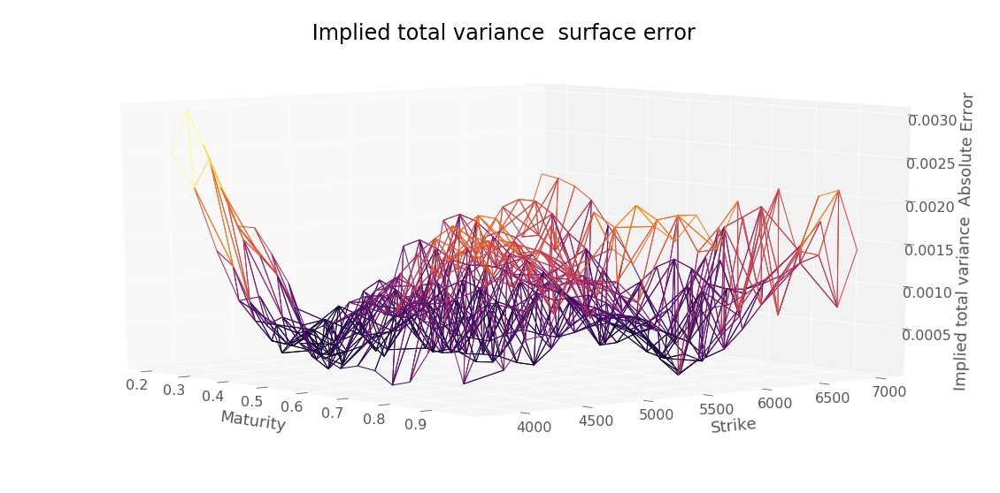

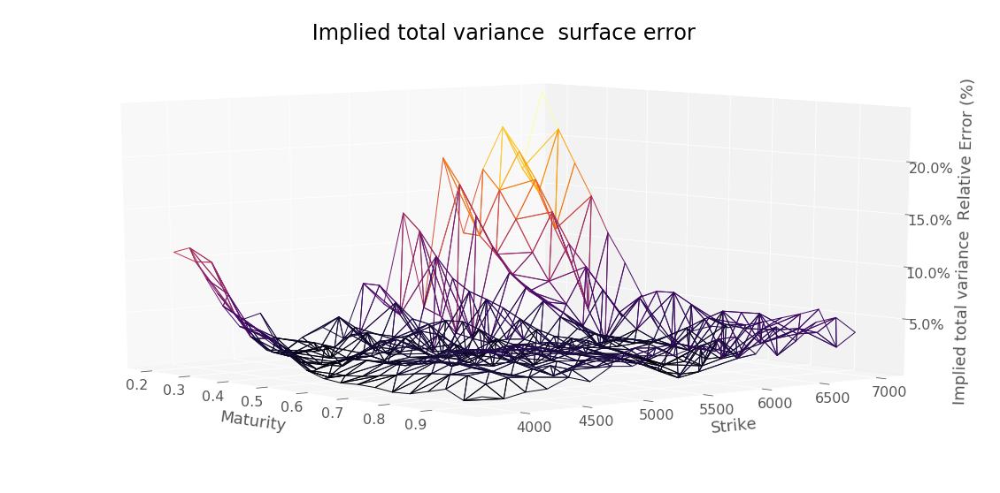

RMSE :  0.0010692357399862404


In [118]:
predictionDiagnosis(impliedVariance(serieDf), 
                    impliedVariance(dataSetTest[dataSetTest["Maturity"] > 0]["ImpliedVol"]), 
                    " Implied total variance ", 
                    yMin=-1000)

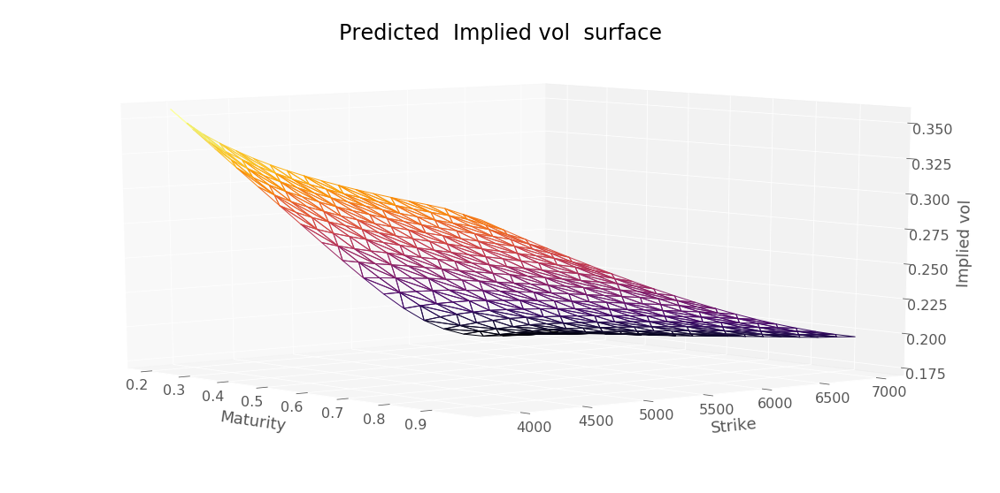

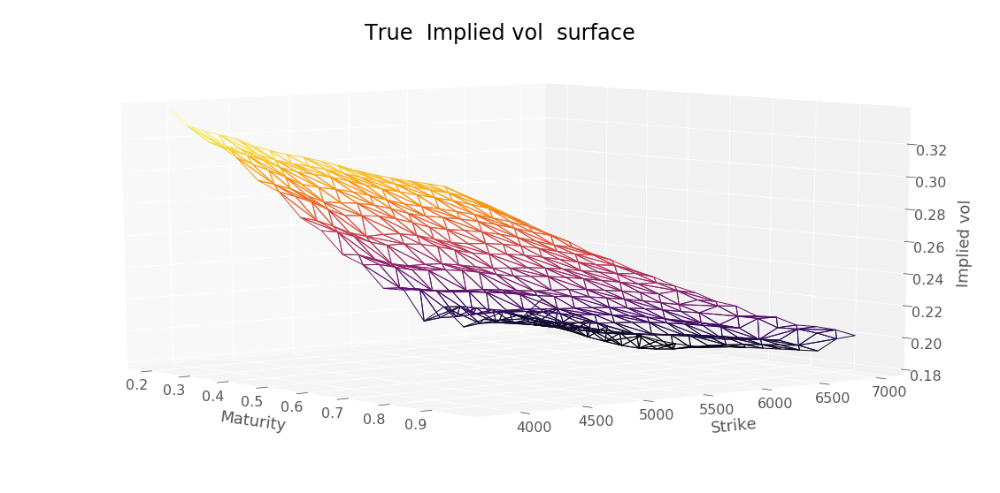

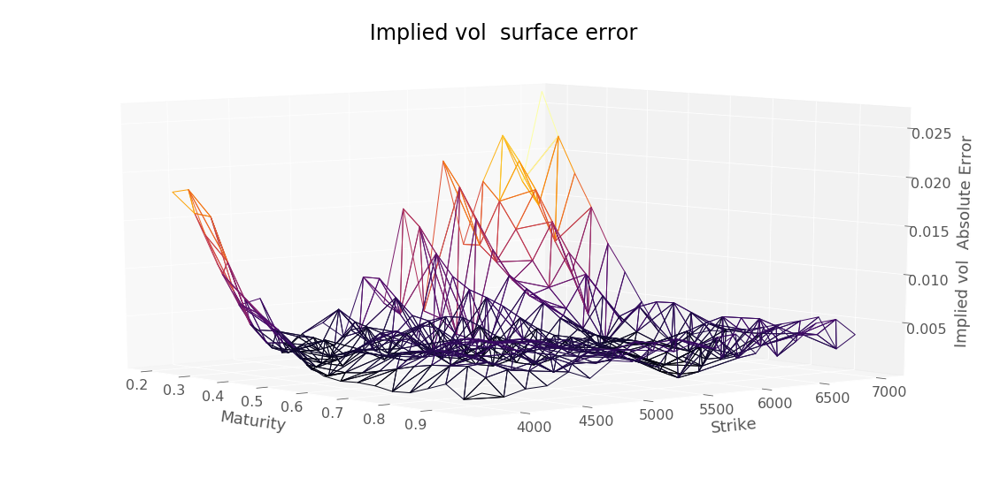

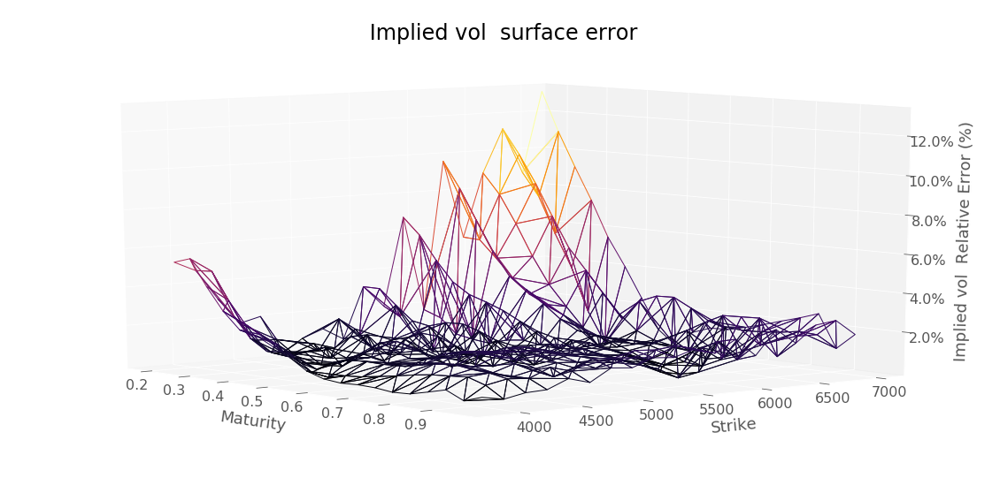

RMSE :  0.005670522504385141


In [119]:
predictionDiagnosis(serieDf, 
                    dataSetTest[dataSetTest["Maturity"] > 0]["ImpliedVol"], 
                    " Implied vol ", 
                    yMin=-1000)

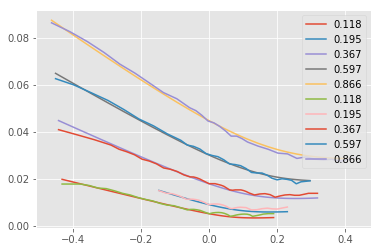

In [120]:
def plotEachSmile(df):
    for smile in df.rename({"Maturity" : "MaturityColumn"}, axis=1).groupby("MaturityColumn"):
        impliedTotVariance = np.square(smile[1]["ImpliedVol"]) * smile[1]["MaturityColumn"]
        plt.plot(smile[1]["logMoneyness"].values, impliedTotVariance.values, label = str(smile[0]))
    plt.legend()
    return

def plotEachSmilePred(df, interpMethod):
    pred = interpMethod(df)
    for smile in pred.groupby("Maturity"):
        maturities = smile[1].index.get_level_values("Maturity")
        impliedTotVariance = np.multiply(np.square(smile[1].values), maturities)
        plt.plot(df.loc[smile[1].index]["logMoneyness"], impliedTotVariance, label = str(smile[0]))
    plt.legend()
    return
    

plotEachSmilePred(dataSet, interpolateGrid)
plotEachSmile(dataSet)
plt.show()

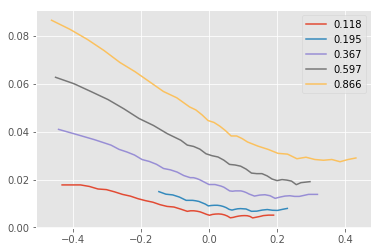

In [121]:
plotEachSmile(dataSet)
plt.show()

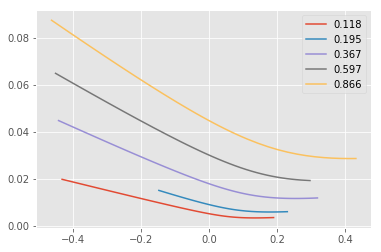

In [122]:
plotEachSmilePred(dataSet, interpolateGrid)
plt.show()

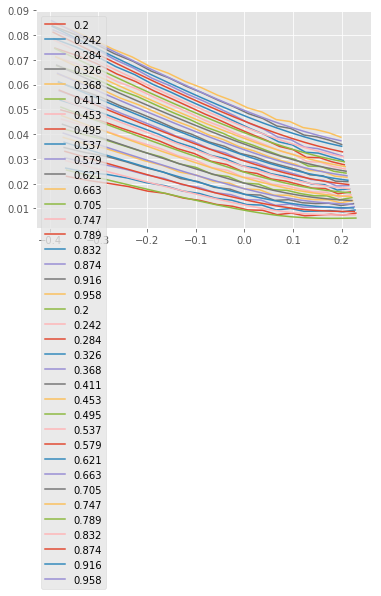

In [123]:
plotEachSmile(dataSetTest)
plotEachSmilePred(dataSetTest, interpolateGrid)
plt.show()

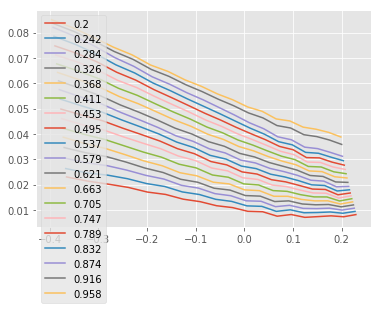

In [124]:
plotEachSmile(dataSetTest)
plt.show()

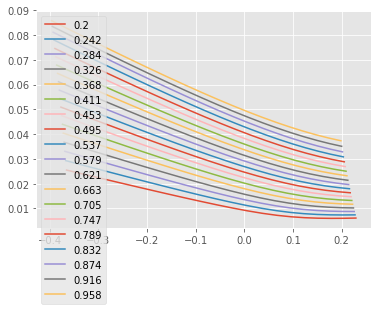

In [125]:
plotEachSmilePred(dataSetTest, interpolateGrid)
plt.show()

In [126]:
def finiteDifferenceSVI(xSet, sviEvalModel):
    strikeStep = 0.0001
    maturityStep = 0.0001
    
    moneynesses = np.exp(xSet.logMoneyness) 
    x = moneynesses = xSet.logMoneyness
    maturities = xSet.Maturity
    
    xSetShifted = xSet.copy(deep=True)
    xSetShifted["logMoneyness"] = xSetShifted["logMoneyness"]  + strikeStep  
    gridStrikeUp = impliedVariance(sviEvalModel(xSetShifted))
    
    xSetShifted["logMoneyness"] = xSetShifted["logMoneyness"] - 2 * strikeStep  
    gridStrikeLow = impliedVariance(sviEvalModel(xSetShifted)) 
    
    gridStrikeMid = impliedVariance(sviEvalModel(xSet)) 
    
    hk = pd.Series((gridStrikeUp + gridStrikeLow - 2 * gridStrikeMid) / (strikeStep**2), 
                   index = xSet.index)
    dK = pd.Series((gridStrikeUp - gridStrikeLow ) / (2 * strikeStep), 
                   index = xSet.index)
    
    xSetShifted["logMoneyness"] = xSetShifted["logMoneyness"]  + strikeStep  
    xSetShifted["Maturity"] = xSetShifted["Maturity"]  + maturityStep  
    gridMaturityUp = impliedVariance(sviEvalModel(xSetShifted), mat = xSetShifted["Maturity"].values)
    
    xSetShifted["Maturity"] = xSetShifted["Maturity"] - 2 * maturityStep  
    gridMaturityLow = impliedVariance(sviEvalModel(xSetShifted), mat = xSetShifted["Maturity"].values)
    dT = pd.Series((gridMaturityUp - gridMaturityLow) / (2 * maturityStep), 
                   index = xSet.index)
    
    numerator = (1 - np.divide(x, gridStrikeMid) * dK + 
                 0.25 * ( -0.25 - np.divide(1, gridStrikeMid) + 
                         np.square(np.divide(x, gridStrikeMid.values)) ) * np.square(dK) + 
                 0.5 * hk )
    locVolGatheral = np.sqrt(dT / numerator)
    
    return dT, hk, dK, locVolGatheral, numerator

In [127]:
#dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSet, interpolateWithSSVI)
dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(dataSetTest, interpolateGrid)

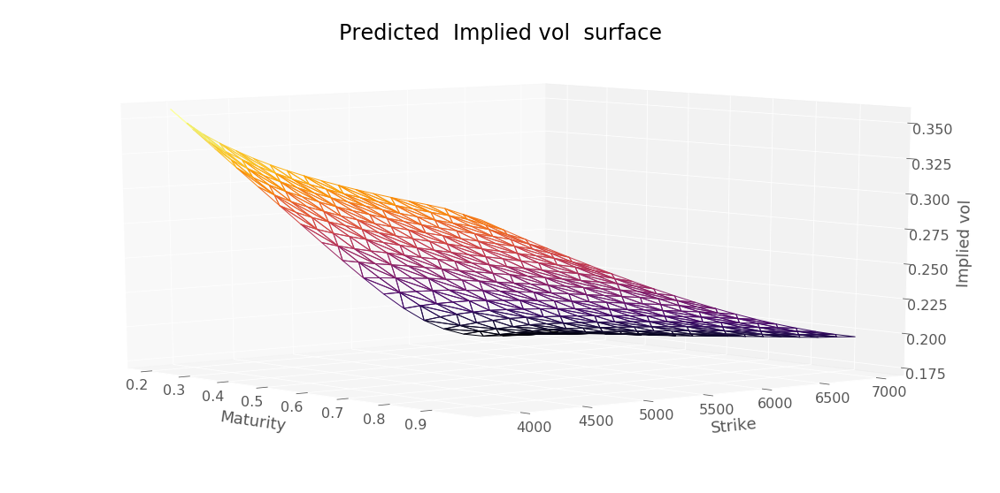

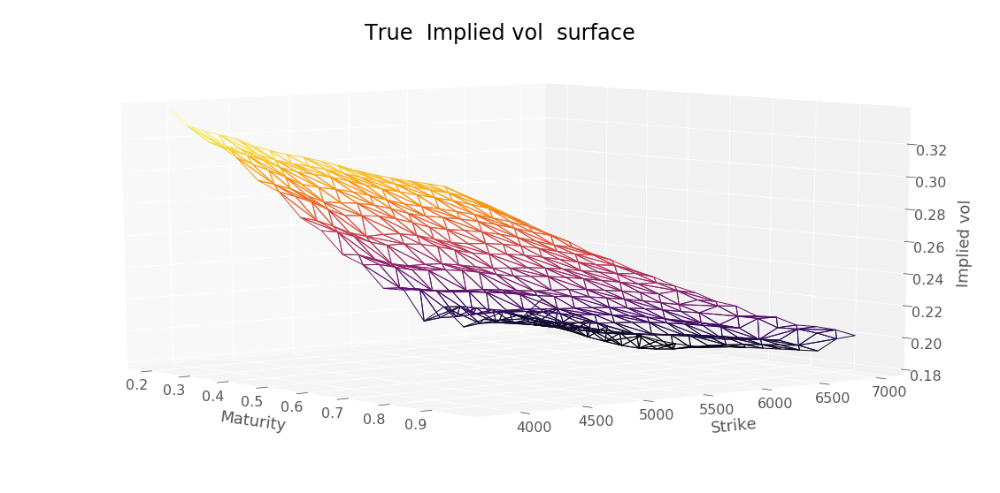

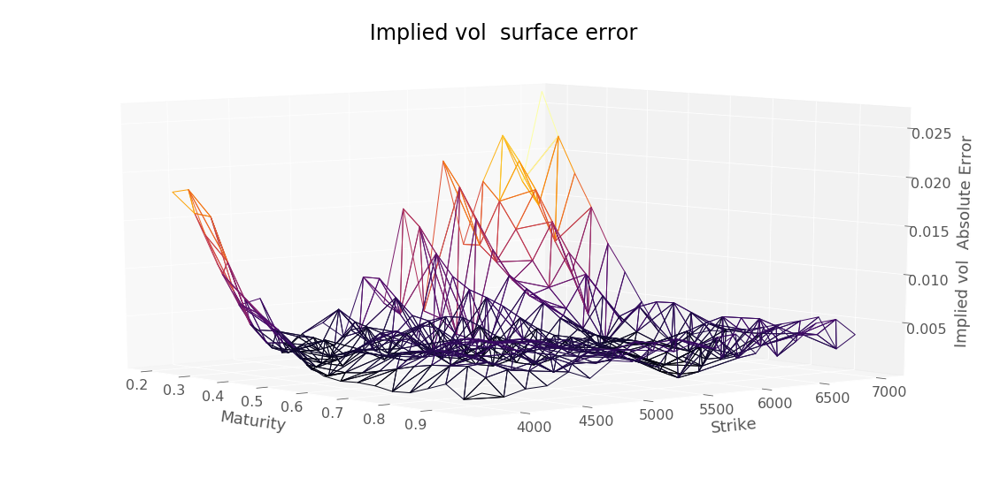

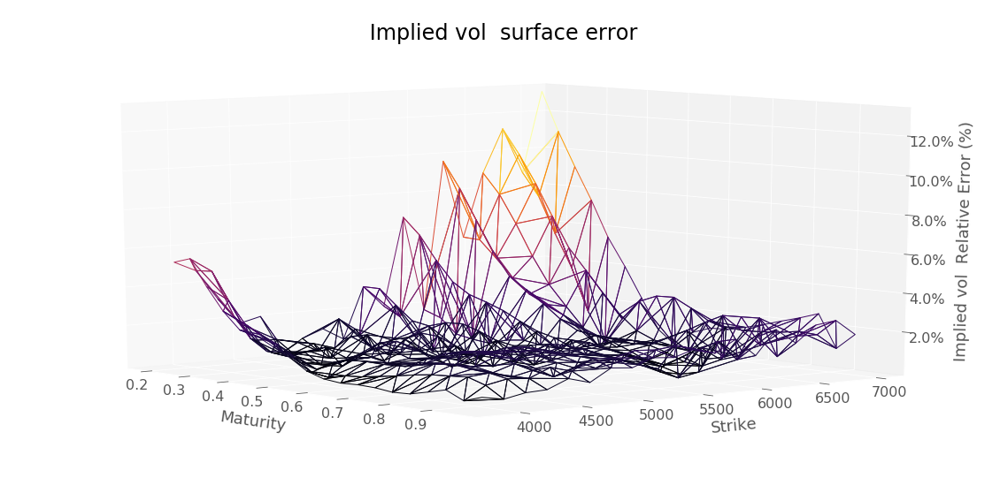

RMSE :  0.005670522504385141


In [128]:
predictionDiagnosis(serie, dataSetTest["ImpliedVol"], " Implied vol ", yMin=-1000)

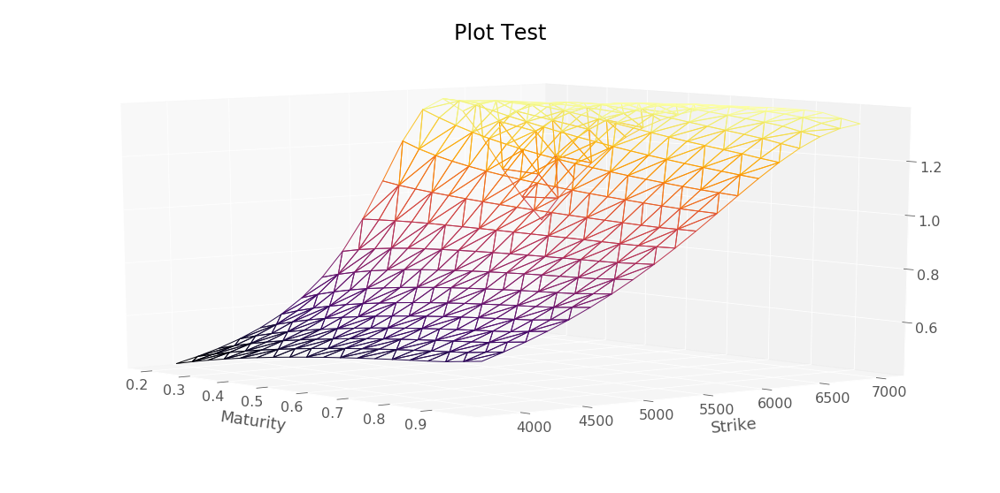

In [129]:
plotSerie(density,
          Title = 'Plot Test',
          az=320,
          yMin=0,
          yMax=10000)

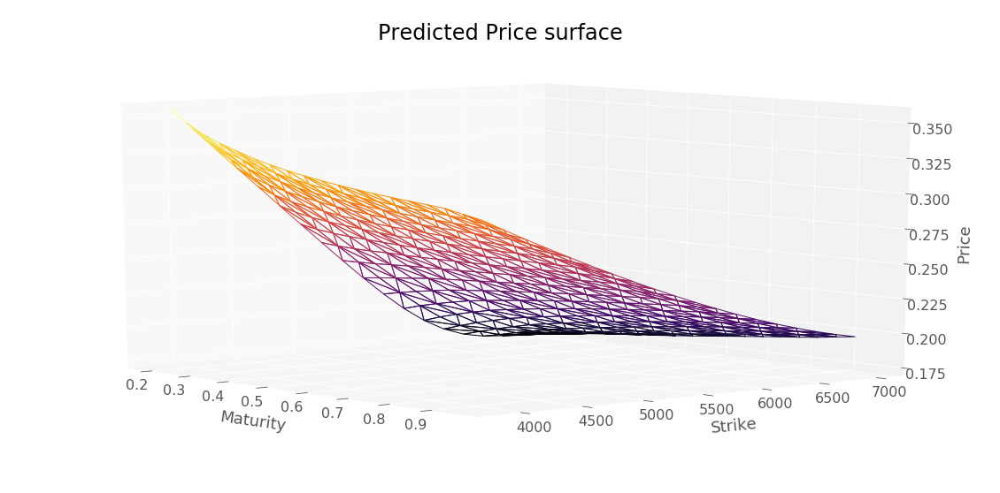

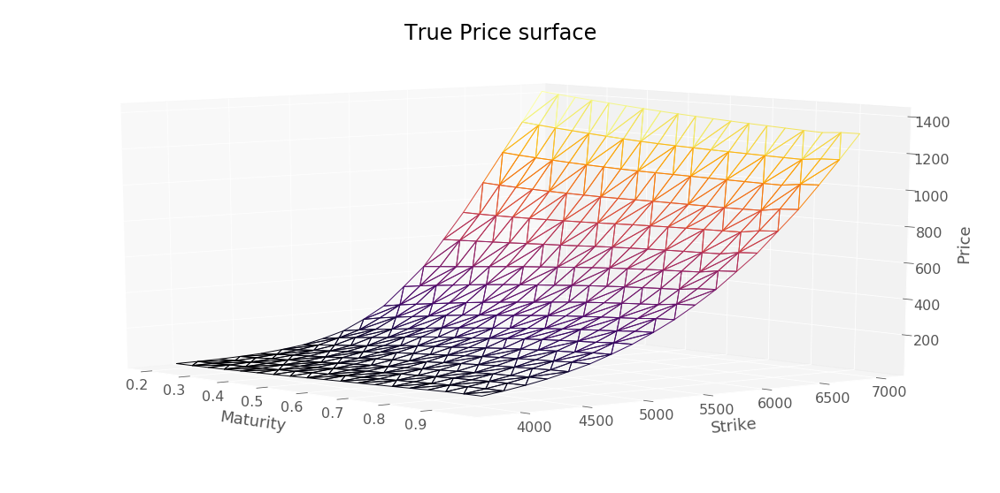

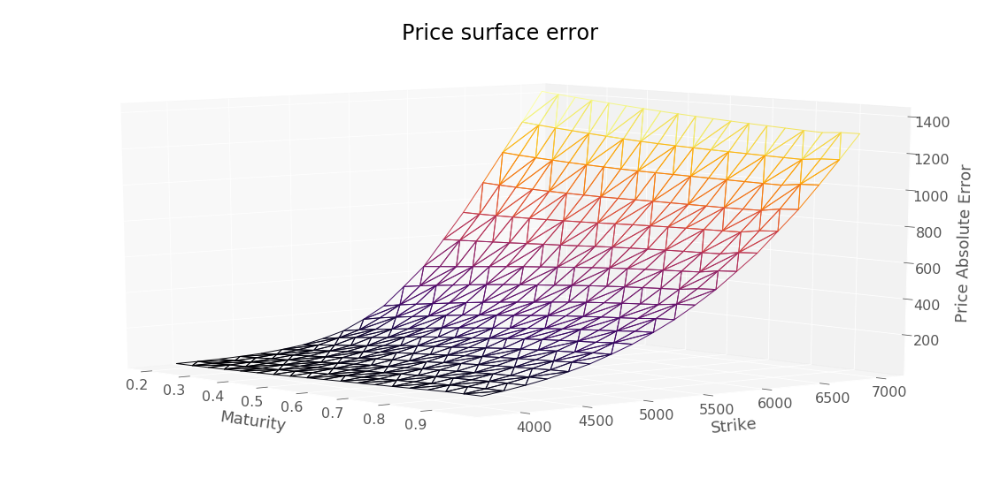

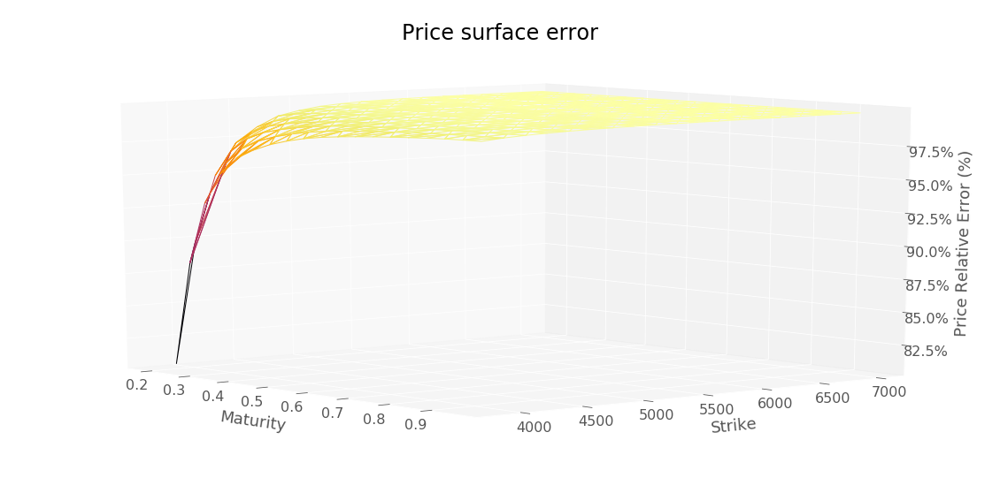

RMSE :  604.2131416640152


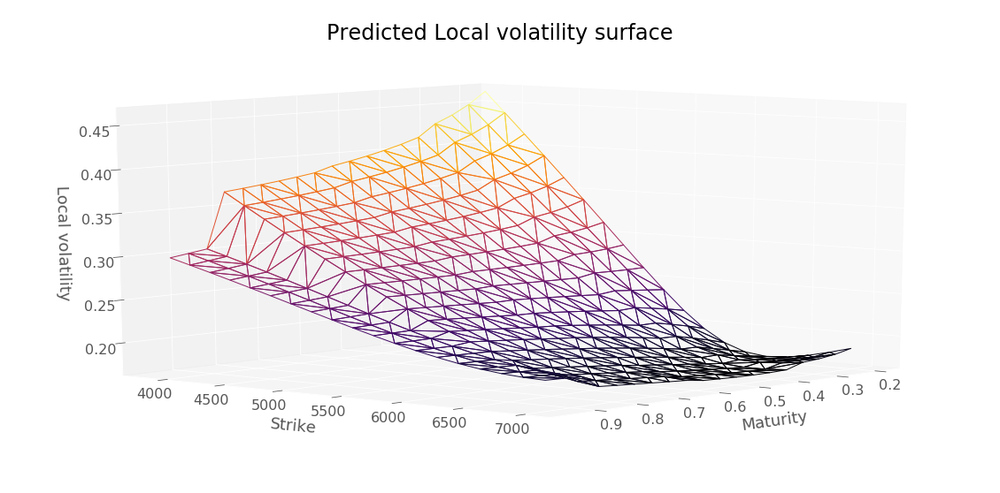

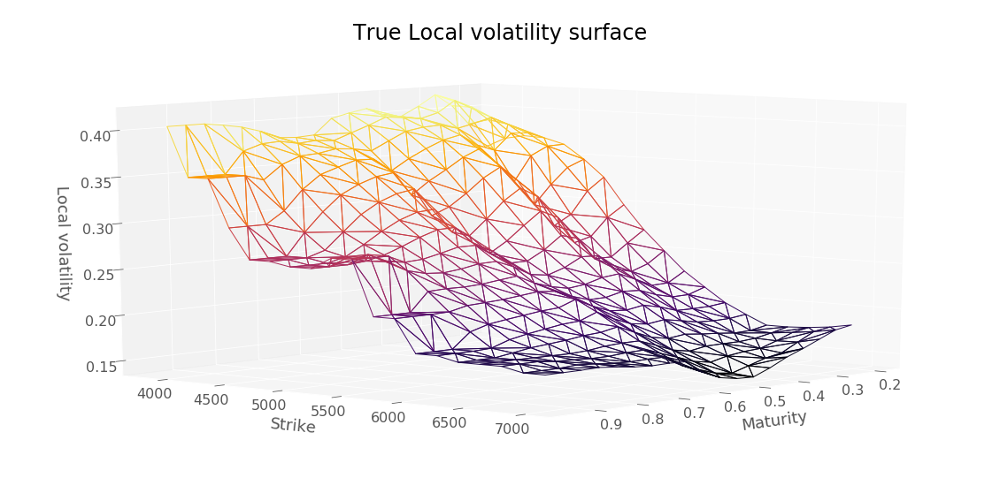

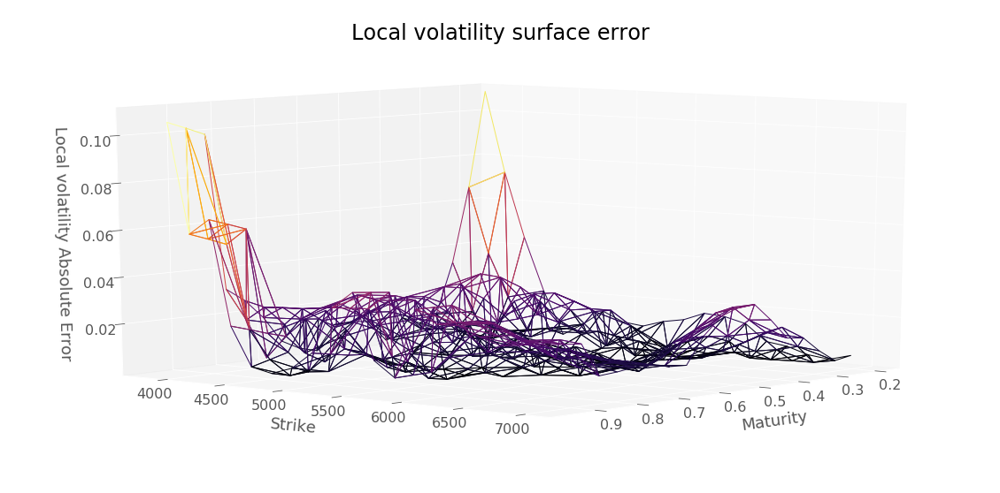

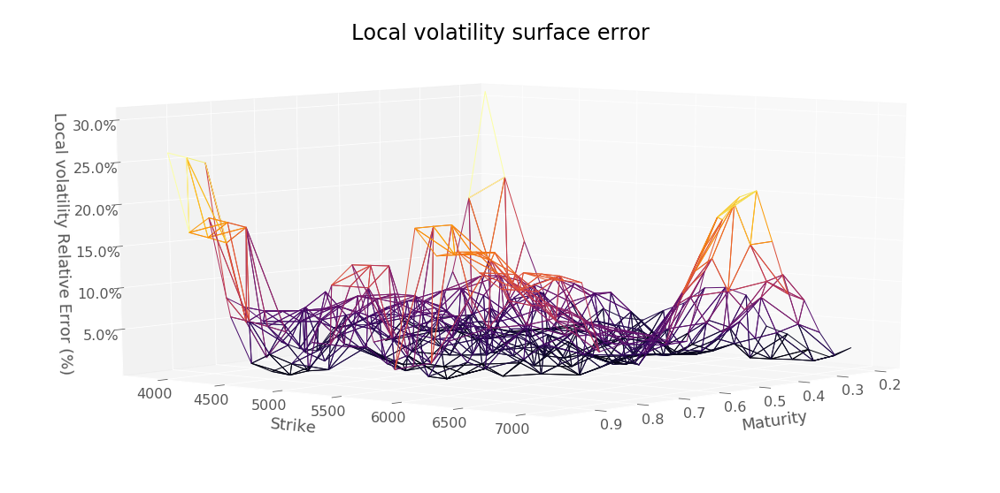

RMSE :  0.0211554362608667


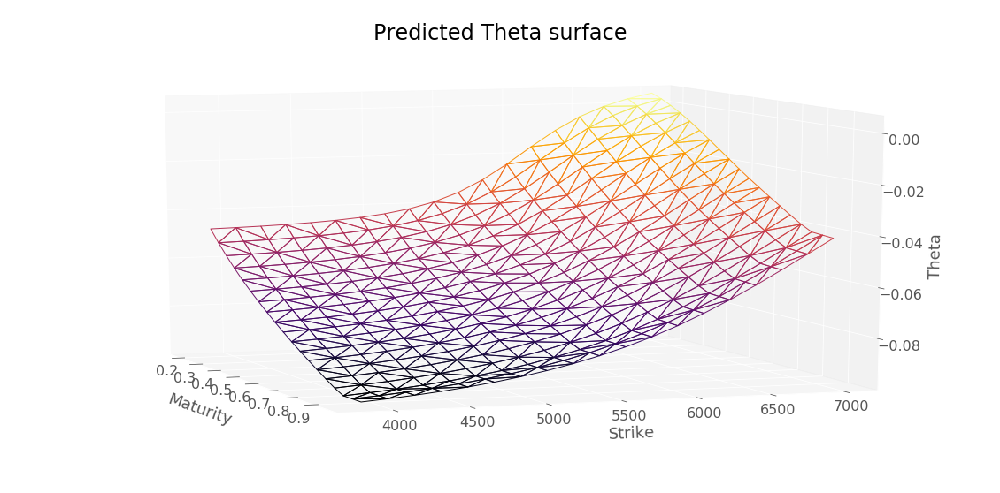

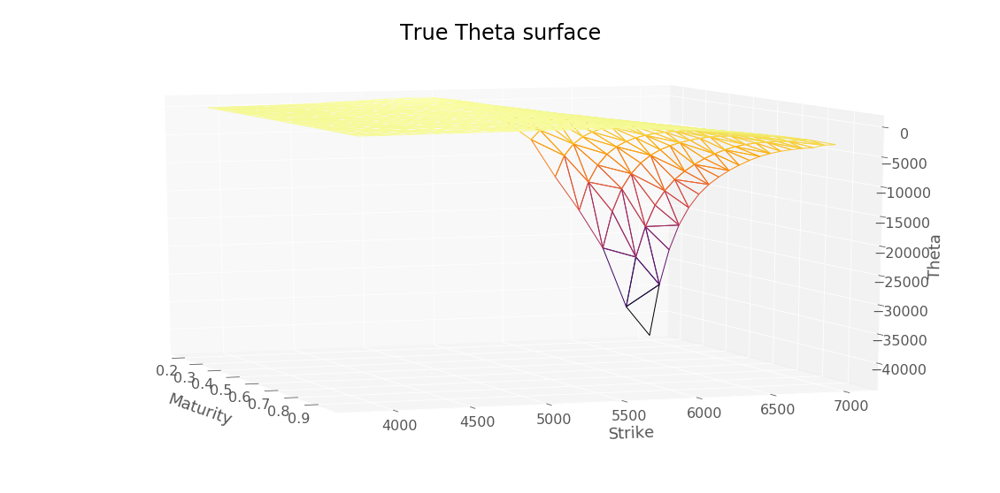

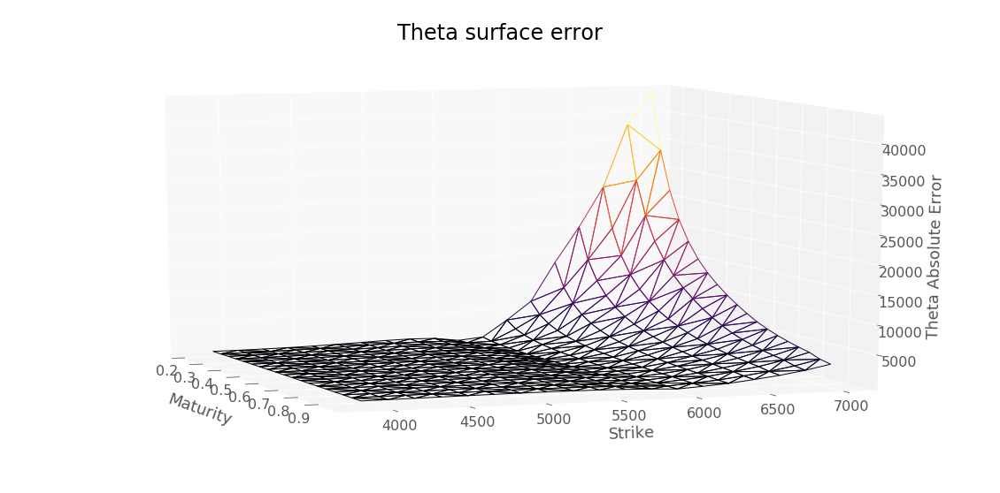

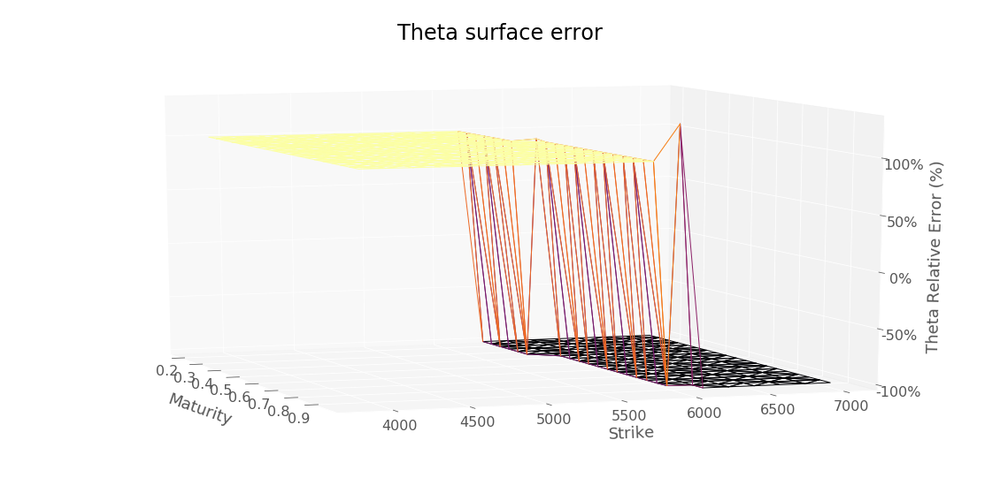

RMSE :  6076.053250146749


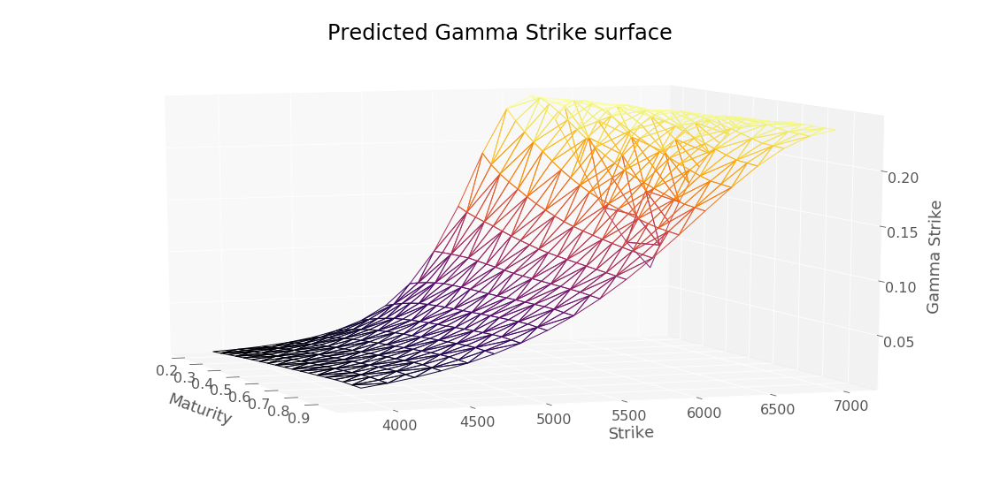

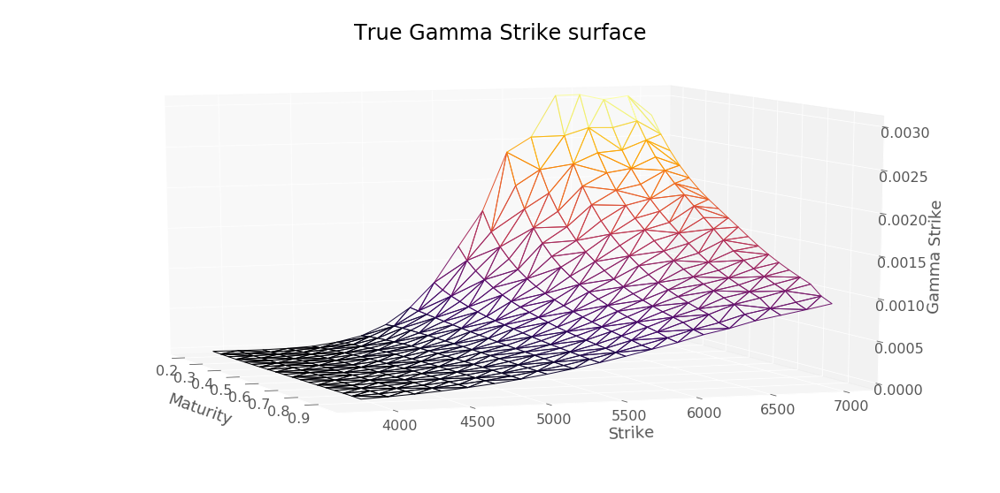

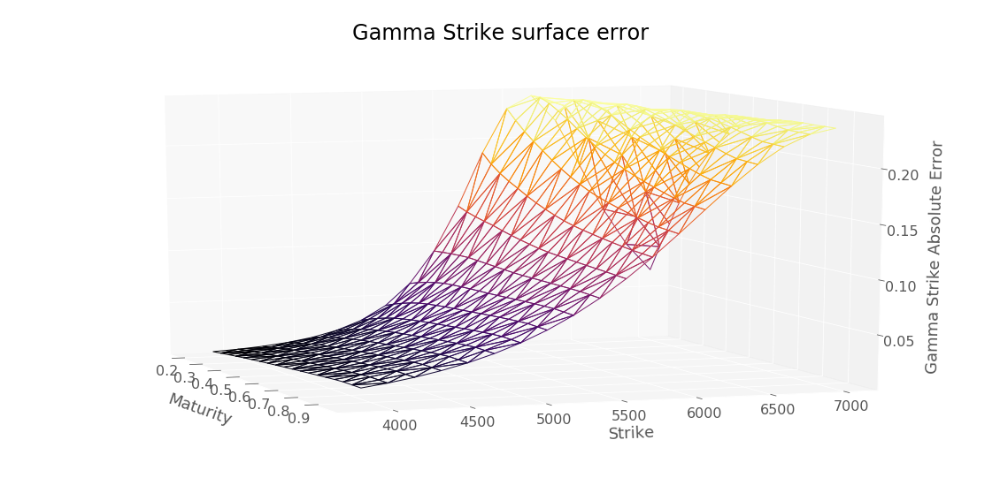

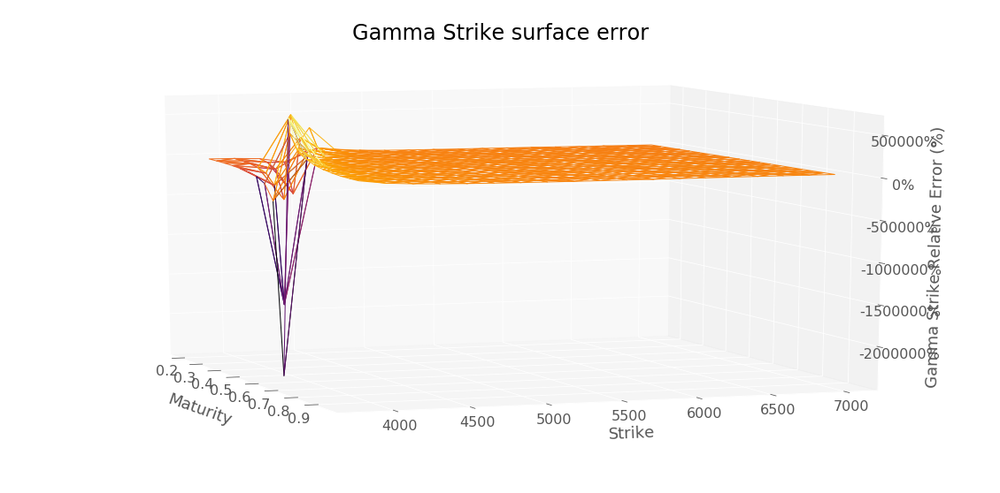

RMSE :  0.1373053607731458


In [130]:
modelSummary(serie, 
             locVolSSVI, 
             dK, 
             hk, 
             dataSetTest, 
             yMin = -1000)

#### Evaluate local volatility on gp local volatility grid

In [131]:
#Gaussian kernel
pathGP = workingFolder + "local_vol_gaussian.csv"
#Matern Kernel
pathGP = workingFolder + "local_vol_matern_5_2.csv"

locVolAresky = pd.read_csv(pathGP, decimal=".").apply(pd.to_numeric)

In [132]:
locVolAresky = locVolAresky.dropna()
locVolAresky["Strike"] = locVolAresky["K"].values
locVolAresky["Maturity"] = locVolAresky["T"].round(decimals=3)
renameDict = {"loc_vol" : "LocalVolatility"}
locVolAreskyFormatted = locVolAresky.rename(columns=renameDict).set_index(["Strike", "Maturity"])
locVolAreskyFormatted.head()

K         T  LocalVolatility
Strike   Maturity                                     
4171.929 0.20      4171.929  0.200000         0.387651
         0.24      4171.929  0.239895         0.405029
         0.28      4171.929  0.279789         0.421496
         0.32      4171.929  0.319684         0.432692
         0.36      4171.929  0.359579         0.438045

In [133]:
locVolAreskyFormatted.shape

(171, 3)

In [134]:
changedVarAresky = changeOfVariable(locVolAreskyFormatted["K"],locVolAreskyFormatted["T"])
locVolAreskyFormatted["Maturity"] = locVolAreskyFormatted["T"]
locVolAreskyFormatted["Strike"] = locVolAreskyFormatted["K"]
locVolAreskyFormatted["ChangedStrike"] = pd.Series(changedVarAresky[0], index = locVolAreskyFormatted.index)
locVolAreskyFormatted["logMoneyness"] = np.log(locVolAreskyFormatted["ChangedStrike"] / S0[0])

In [135]:
locVolAreskyFormatted = locVolAreskyFormatted[~locVolAreskyFormatted.index.duplicated(keep='first')]

In [136]:
locVolAreskyFormatted.head()

K         T  LocalVolatility  Maturity    Strike  \
Strike   Maturity                                                            
4171.929 0.20      4171.929  0.200000         0.387651  0.200000  4171.929   
         0.24      4171.929  0.239895         0.405029  0.239895  4171.929   
         0.28      4171.929  0.279789         0.421496  0.279789  4171.929   
         0.32      4171.929  0.319684         0.432692  0.319684  4171.929   
         0.36      4171.929  0.359579         0.438045  0.359579  4171.929   

                   ChangedStrike  logMoneyness  
Strike   Maturity                               
4171.929 0.20        4136.204101     -0.287200  
         0.24        4129.317535     -0.288866  
         0.28        4122.814661     -0.290442  
         0.32        4116.447808     -0.291988  
         0.36        4109.904651     -0.293579

In [137]:
locVolAreskyFormatted.drop_duplicates().shape

(171, 7)

In [138]:
locVolAreskyFormatted.index.unique().shape

(171,)

In [139]:
dT, hk, dK, locVolSSVI, density = finiteDifferenceSVI(locVolAreskyFormatted, interpolateGrid)

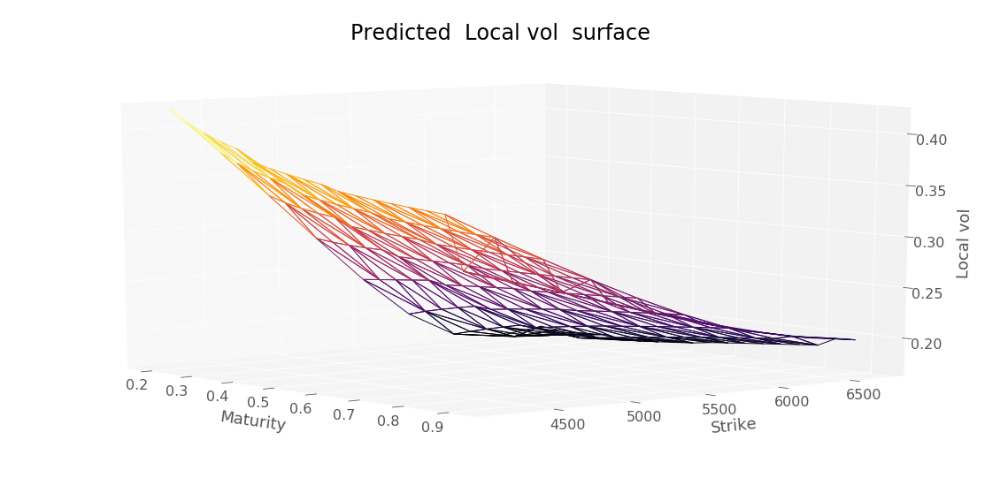

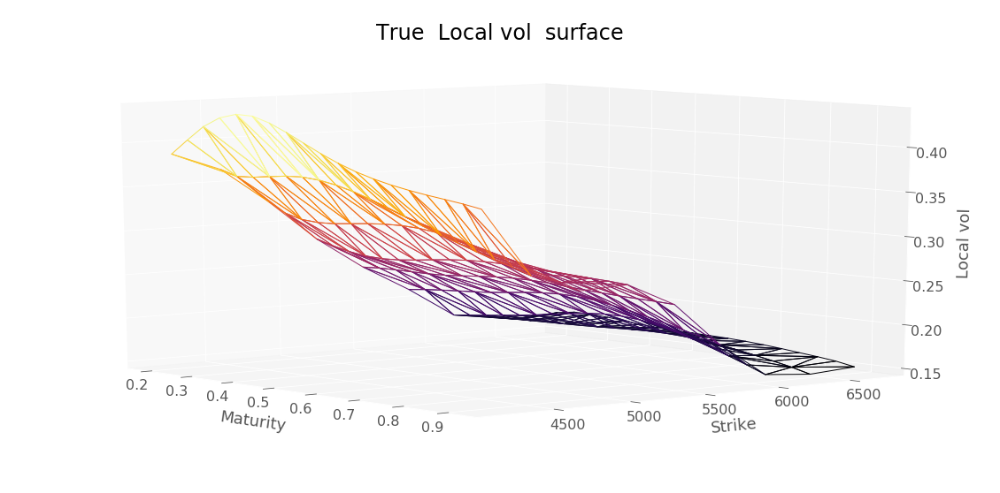

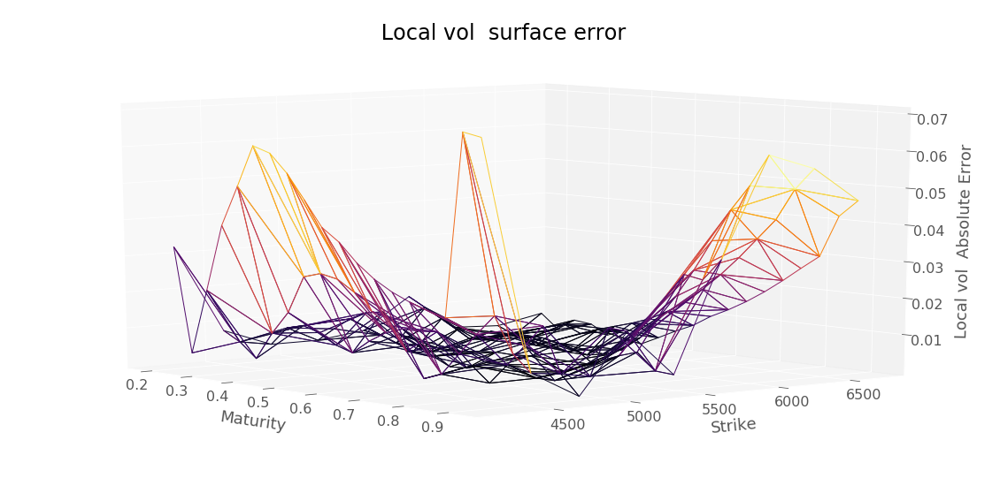

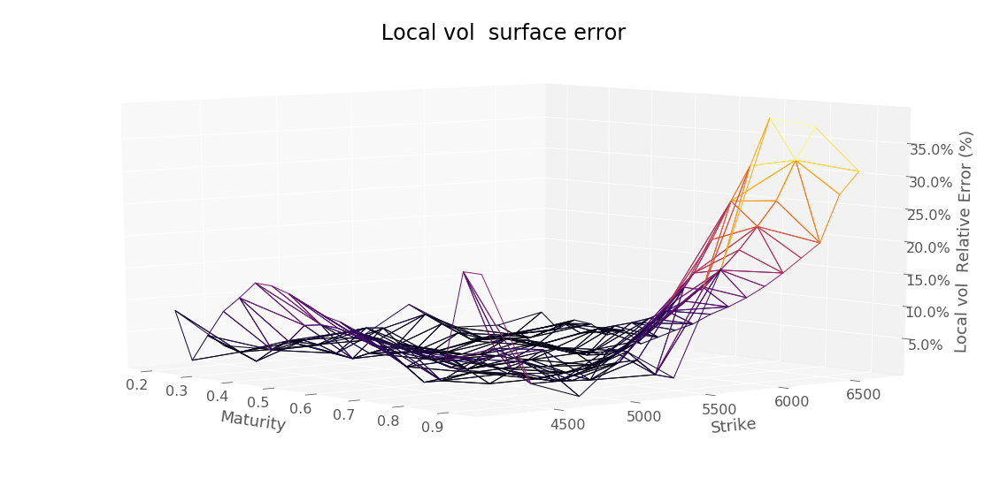

RMSE :  0.021313521716302932


In [140]:
predictionDiagnosis(locVolSSVI, locVolAreskyFormatted["LocalVolatility"], " Local vol ", yMin=-1000)

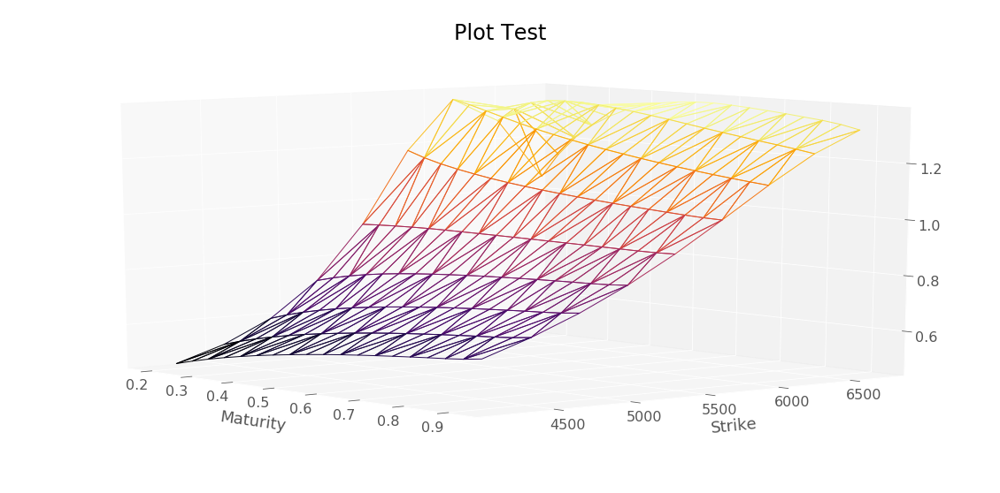

In [141]:
plotSerie(density,
          Title = 'Plot Test',
          az=320,
          yMin=0,
          yMax=10000)

In [142]:
locVolSSVIDf = locVolAreskyFormatted.copy(deep=True)
locVolSSVIDf["LocalVolatility"] = locVolSSVI

In [143]:
locVolSSVIDf.tail()

K         T  LocalVolatility  Maturity    Strike  \
Strike   Maturity                                                            
6678.561 0.759     6678.561  0.758526         0.185215  0.758526  6678.561   
         0.798     6678.561  0.798421         0.186859  0.798421  6678.561   
         0.838     6678.561  0.838316         0.188459  0.838316  6678.561   
         0.878     6678.561  0.878211         0.197372  0.878211  6678.561   
         0.918     6678.561  0.918105         0.198057  0.918105  6678.561   

                   ChangedStrike  logMoneyness  
Strike   Maturity                               
6678.561 0.759       6473.817196      0.160788  
         0.798       6462.421553      0.159026  
         0.838       6451.059348      0.157266  
         0.878       6440.171646      0.155577  
         0.918       6430.102383      0.154012

In [144]:
dT[dT<0]

Series([], dtype: float64)

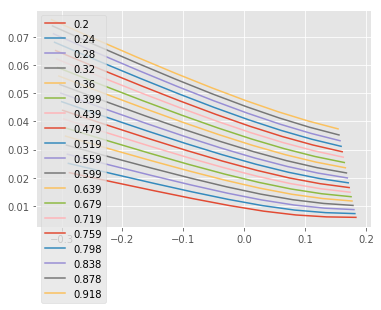

In [145]:
plotEachSmilePred(locVolAreskyFormatted, interpolateGrid)
plt.show()

# MC backtest 

In [146]:
def interpolatedMCLocalVolatility(localVol, strikes, maturities):
    coordinates =  np.array( customInterpolator(localVol, strikes, maturities) ).flatten()  
    return pd.Series(coordinates, index = pd.MultiIndex.from_arrays([strikes, maturities], names=('Strike', 'Maturity')))

In [147]:
nbTimeStep = 100
nbPaths = 100000
def MonteCarloPricer(S, 
                     Strike, 
                     Maturity, 
                     rSpline, 
                     divSpline, 
                     nbPaths, 
                     nbTimeStep, 
                     volLocaleFunction):
  time_grid = np.linspace(0, Maturity, int(nbTimeStep + 1))
  timeStep = Maturity / nbTimeStep
  gaussianNoise = np.random.normal(scale = np.sqrt(timeStep), size=(nbTimeStep, nbPaths))

  logReturn = np.zeros((nbTimeStep + 1, nbPaths))
  logReturn[0,:] = 0

  for i in range(nbTimeStep) :
      t = time_grid[i]

      St = S0 * np.exp(logReturn[i,:])
      volLocale = volLocaleFunction(St, np.ones(nbPaths) * t)

      mu = rSpline(t) - divSpline(t)
      drift = np.ones(nbPaths) * (mu - np.square(volLocale) / 2.0) 
      logReturn[i + 1, :] = logReturn[i,:] + drift * timeStep + gaussianNoise[i,:] * volLocale
  SFinal = S0 * np.exp(logReturn[-1, :])
  return np.mean(np.maximum(Strike - SFinal, 0))

def MonteCarloPricerVectorized(S, 
                               dataSet,
                               rSpline, 
                               divSpline, 
                               nbPaths, 
                               nbTimeStep, 
                               volLocaleFunction):
  func = lambda x : MonteCarloPricer(S, x["Strike"], x["Maturity"], 
                                     riskCurvespline, divSpline, 
                                     nbPaths, nbTimeStep, 
                                     volLocaleFunction)
  return dataSet.apply(func, axis=1) * np.exp(-riskFreeIntegral(dataSet.index.get_level_values("Maturity")))

#### GP Local Volatility

In [148]:
testingDataSetAresky = interpolatedLocalVolatility(locVolAreskyFormatted, testingDataSet["Price"])

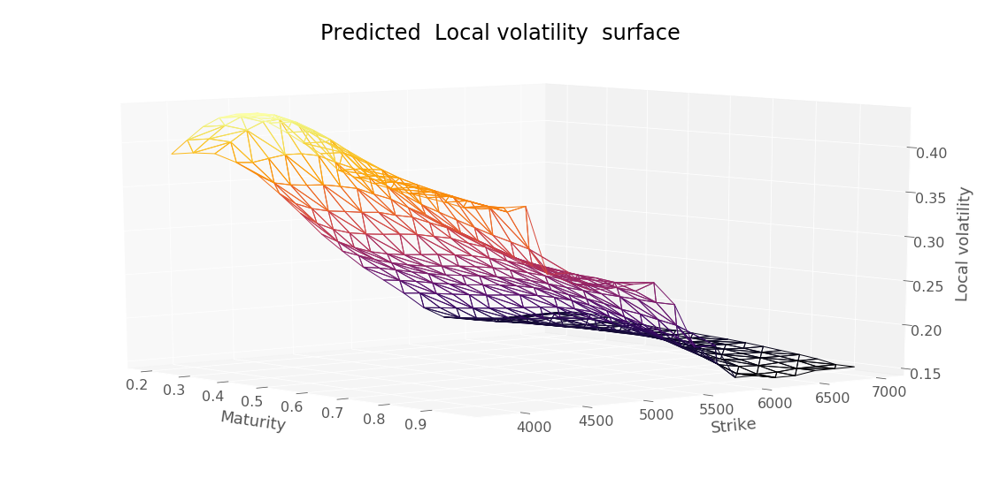

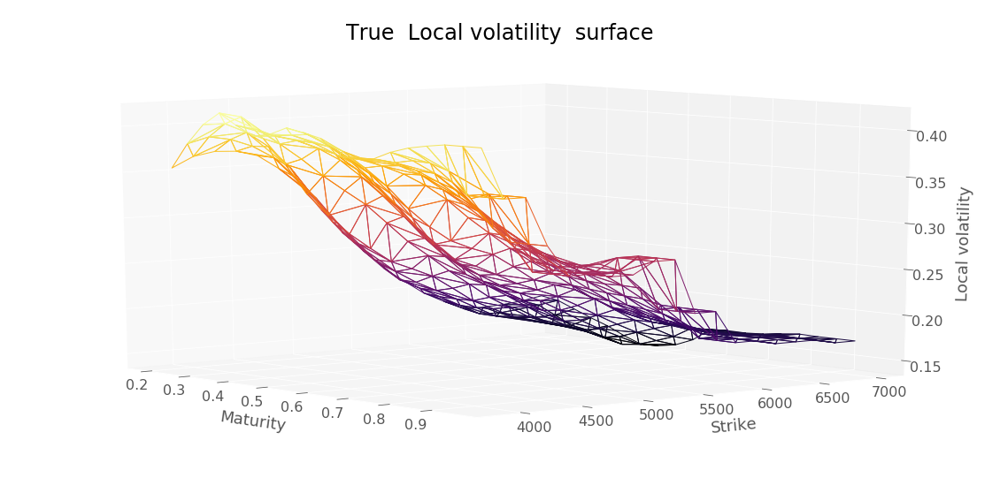

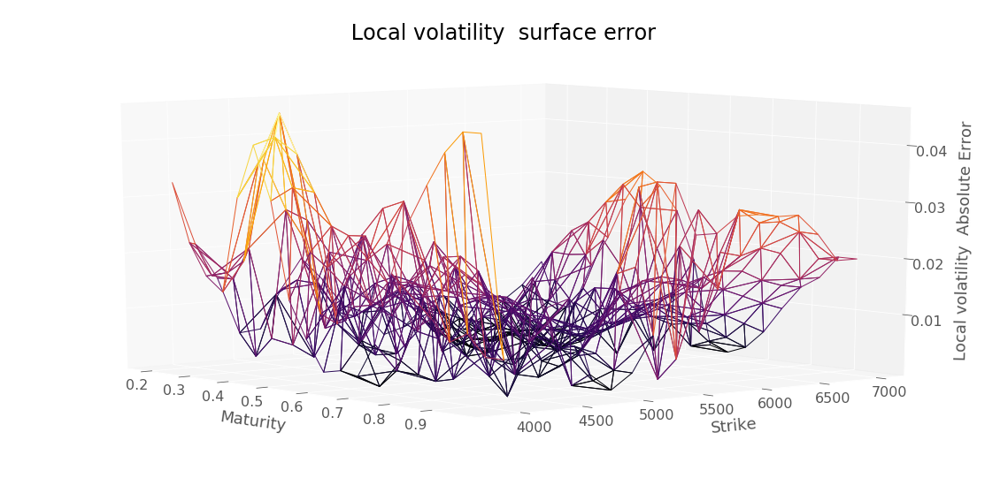

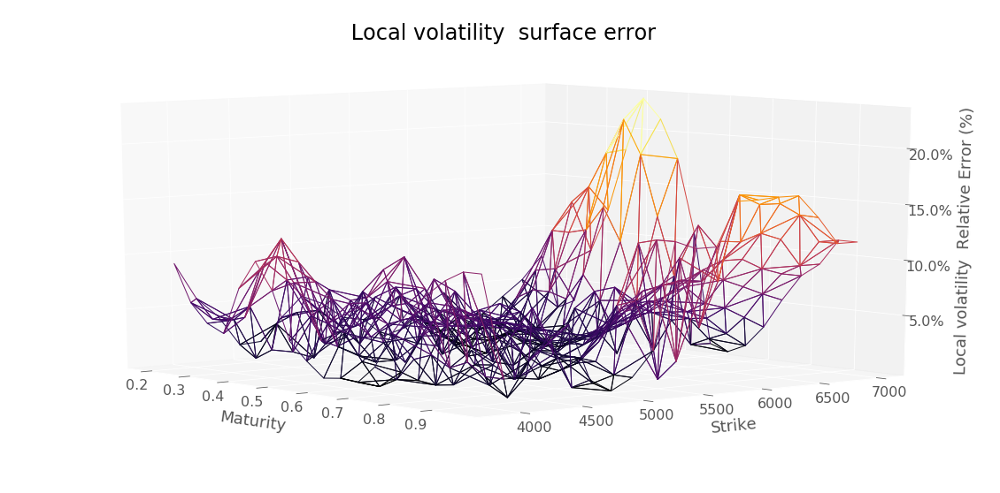

RMSE :  0.01568875310470875


In [149]:
predictionDiagnosis(testingDataSetAresky, dataSetTest["locvol"], " Local volatility ")

In [150]:
nnAresky = lambda x,y : interpolatedMCLocalVolatility(locVolAreskyFormatted["LocalVolatility"], x, y)

In [151]:
mcResSigmaAreskyTest = MonteCarloPricerVectorized(S0[0],
                                                  dataSetTest,
                                                  riskCurvespline,
                                                  divSpline,
                                                  nbPaths,
                                                  nbTimeStep,
                                                  nnAresky)
mcResSigmaAreskyTest.head()

Strike  Maturity
3858.6  0.200        1.155964
        0.242        2.576667
        0.284        4.597893
        0.326        7.457578
        0.368       10.510682
dtype: float64

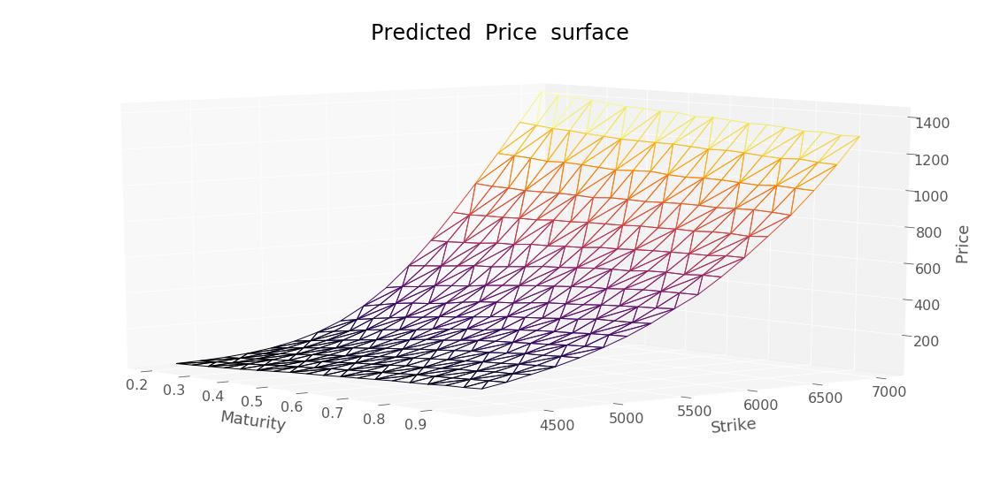

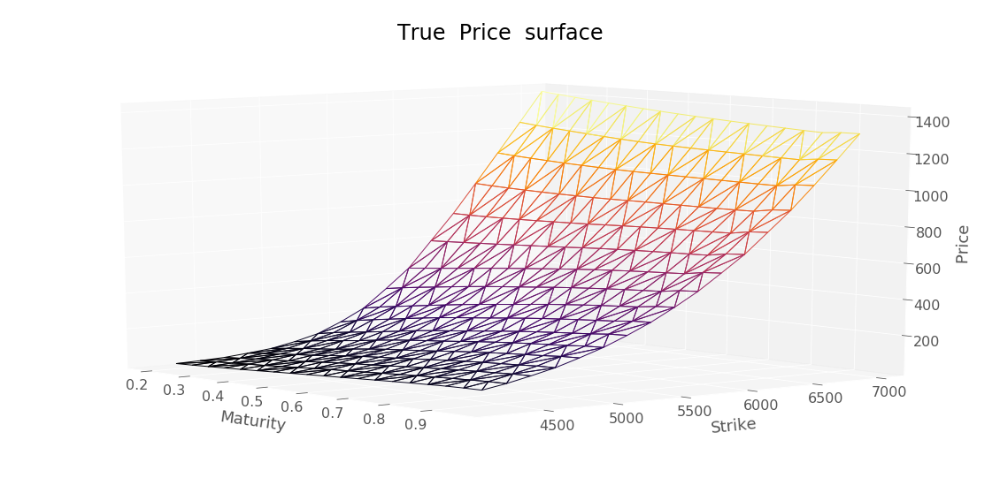

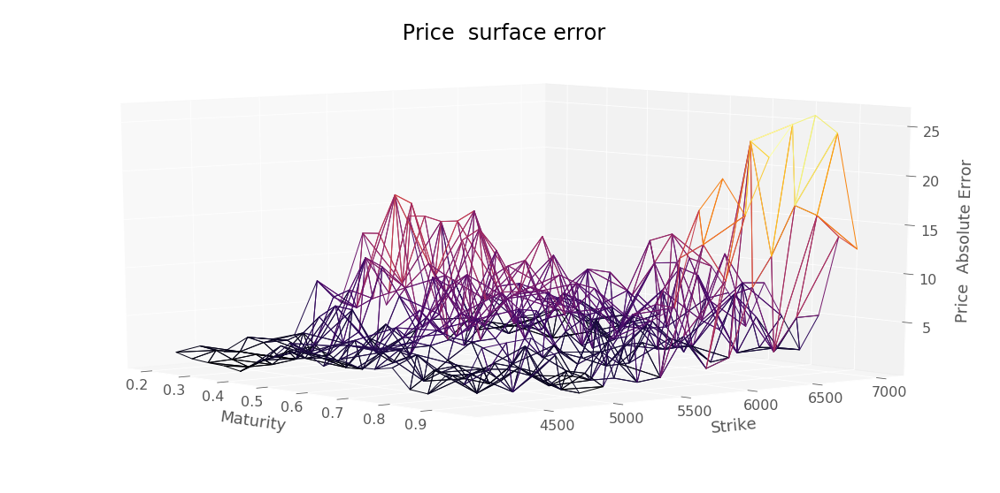

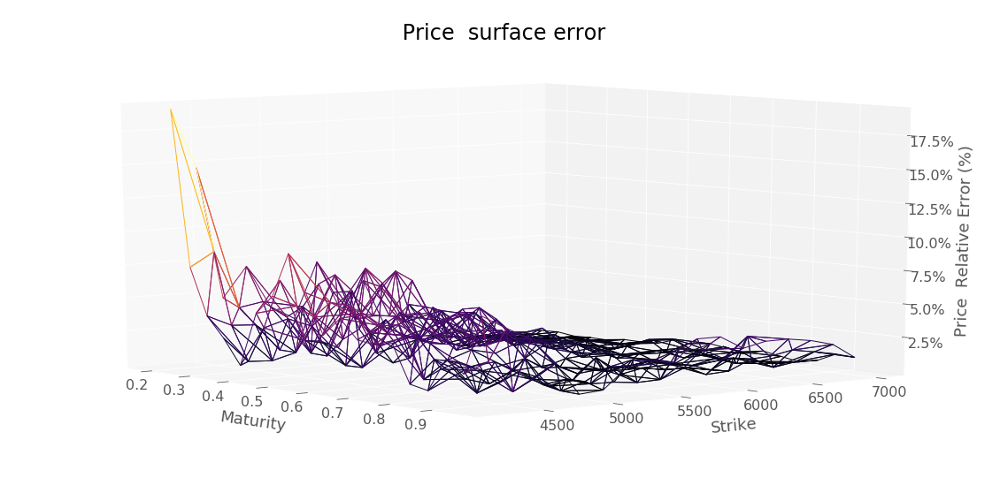

RMSE :  6.4604137044511045


In [152]:
predictionDiagnosis(mcResSigmaAreskyTest, dataSetTest["Price"], " Price ", yMin=4100)

In [153]:
mcResSigmaAreskyTest.to_csv(workingFolder + "mcResSigmaAreskyTest.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


In [154]:
mcResSigmaAreskyTrain = MonteCarloPricerVectorized(S0[0],
                                                   dataSet,
                                                   riskCurvespline,
                                                   divSpline,
                                                   nbPaths,
                                                   nbTimeStep,
                                                   nnAresky)
mcResSigmaAreskyTrain.head()

Strike  Maturity
3600    0.118        0.007650
        0.367        4.635284
        0.597       17.752130
        0.866       32.615065
3800    0.118        0.044776
dtype: float64

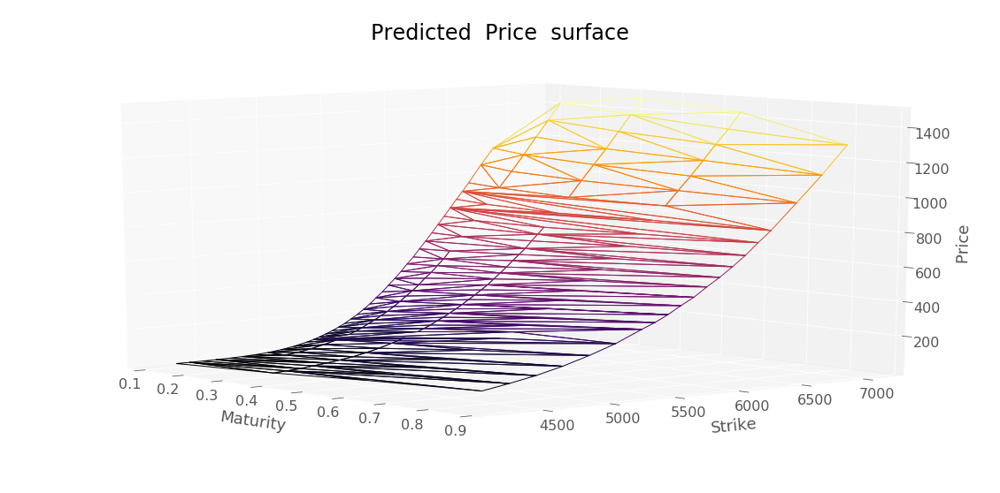

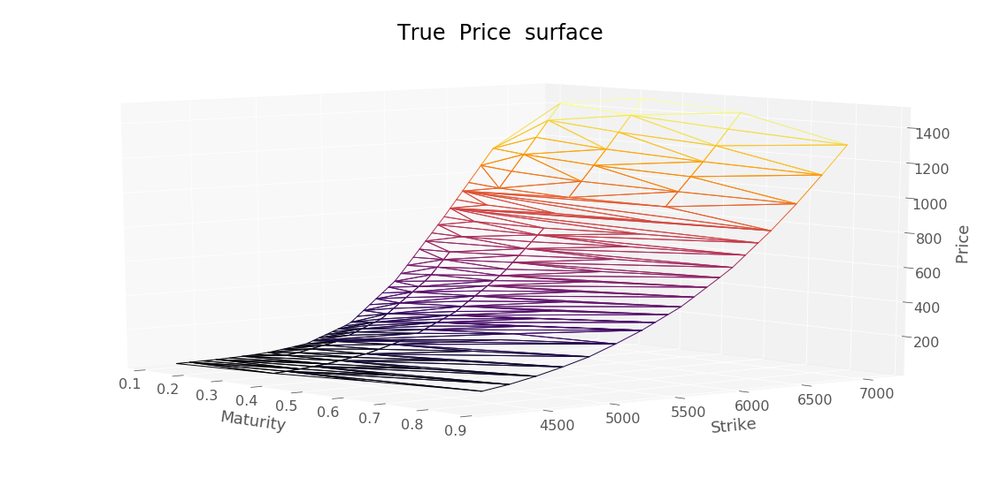

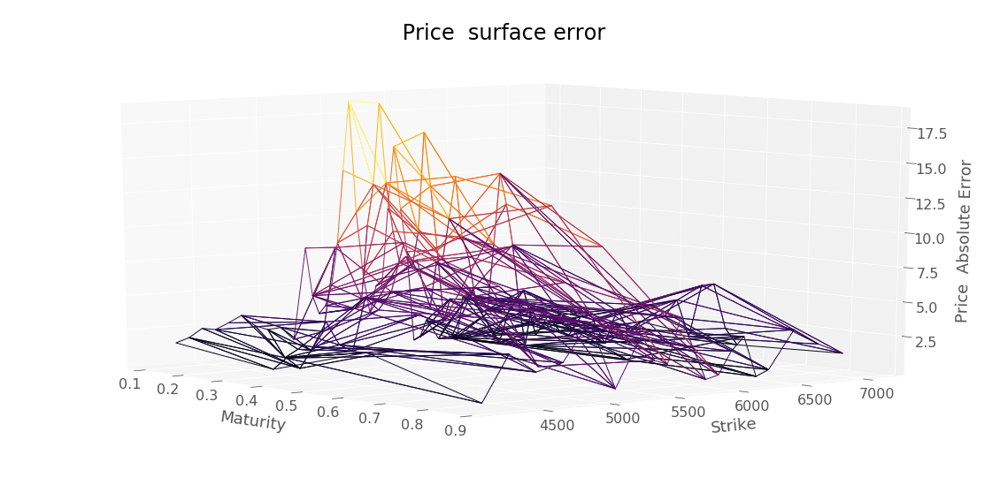

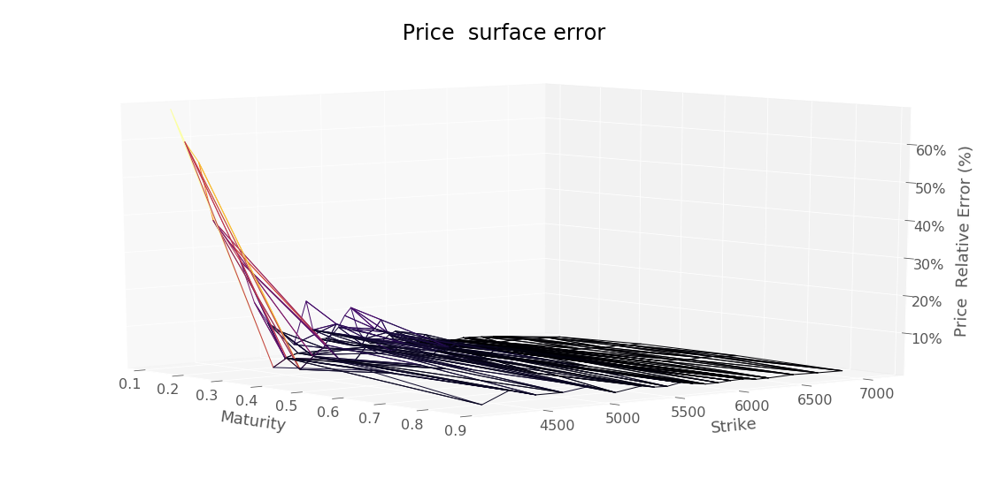

RMSE :  5.405643579569737


In [155]:
predictionDiagnosis(mcResSigmaAreskyTrain, dataSet["Price"], " Price ", yMin=4100)

In [156]:
mcResSigmaAreskyTest.to_csv(workingFolder + "mcResSigmaAreskyTrain.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


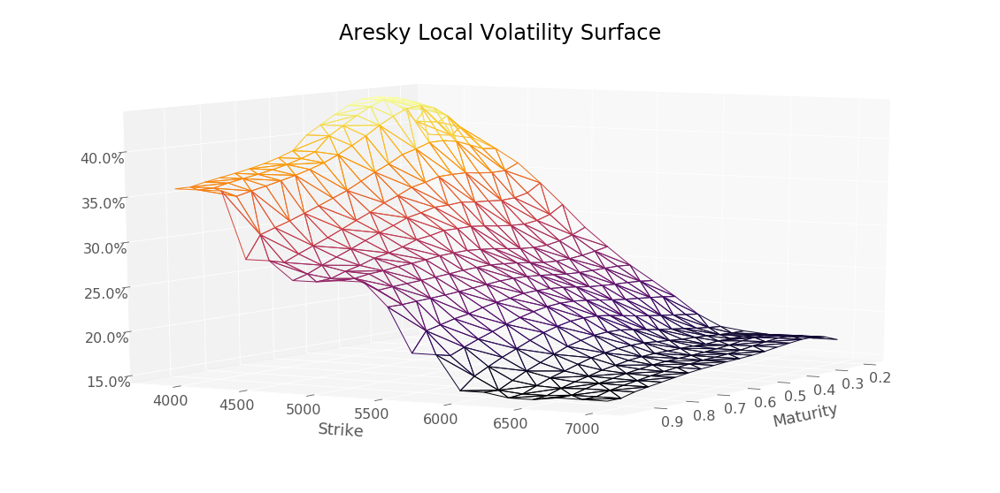

In [157]:
plotSerie(testingDataSetAresky[testingDataSetAresky.index.get_level_values("Maturity") > 0.01],
          Title = 'Aresky Local Volatility Surface',
          az=30,
          yMin=0.0*S0,
          yMax=2.0*S0, 
          zAsPercent=True)

#### Tikhonov calibration

In [158]:
nnVolLocaleTykhonov = lambda x,y : interpolatedMCLocalVolatility(localVolatility["LocalVolatility"], x, y)


In [159]:
s = testingDataSetAresky.index.get_level_values("Strike").values
t = testingDataSetAresky.index.get_level_values("Maturity").values

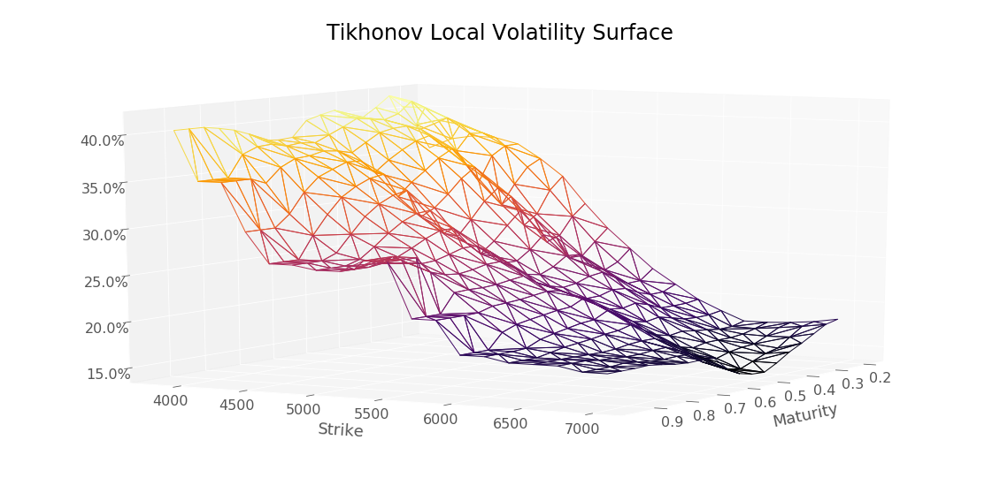

In [160]:
tikhonovLocVol = nnVolLocaleTykhonov(s, t)
plotSerie(tikhonovLocVol[tikhonovLocVol.index.get_level_values("Maturity") > 0.01],
          Title = 'Tikhonov Local Volatility Surface',
          az=30,
          yMin=0.0*S0,
          yMax=2.0*S0, 
          zAsPercent=True)

In [161]:
mcResTikhonovTest = MonteCarloPricerVectorized(S0[0],
                                               dataSetTest,
                                               riskCurvespline,
                                               divSpline,
                                               nbPaths,
                                               nbTimeStep,
                                               nnVolLocaleTykhonov)
mcResTikhonovTest.head()

Strike  Maturity
3858.6  0.200        1.482515
        0.242        2.682045
        0.284        4.683692
        0.326        7.118223
        0.368       10.023744
dtype: float64

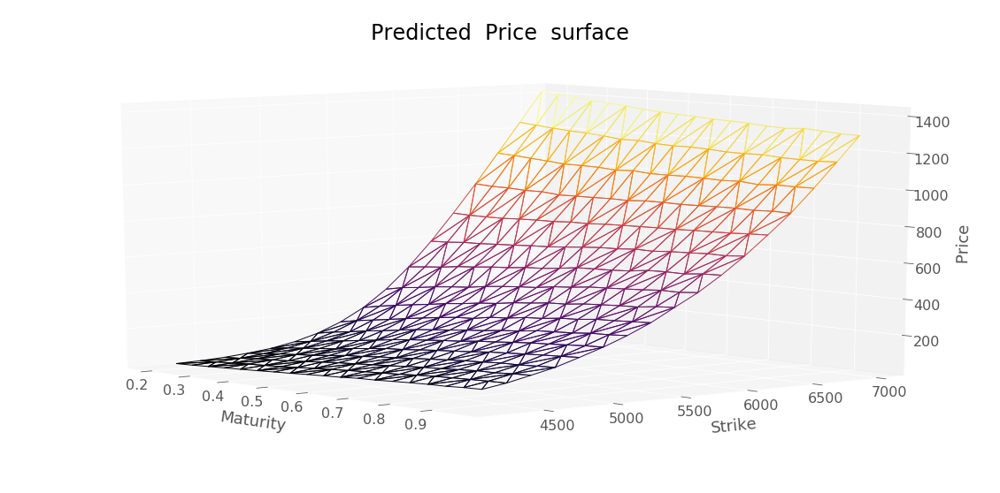

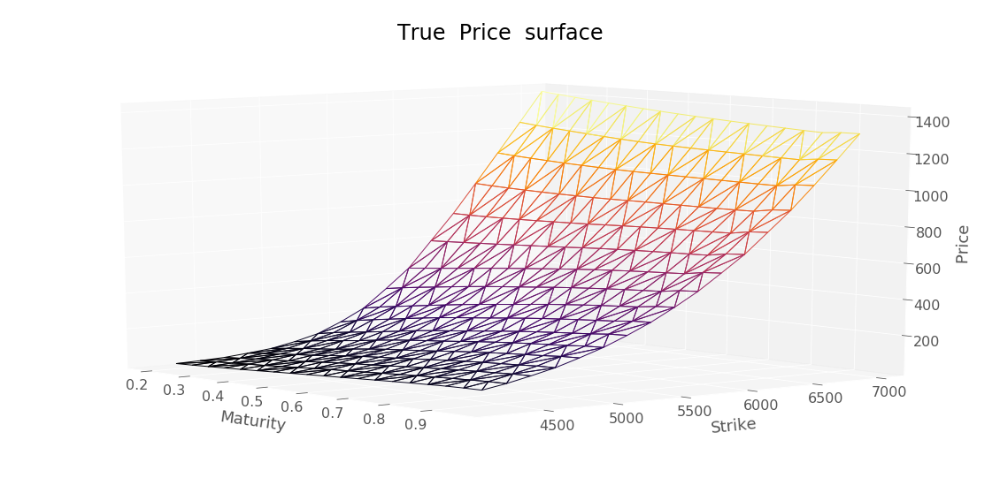

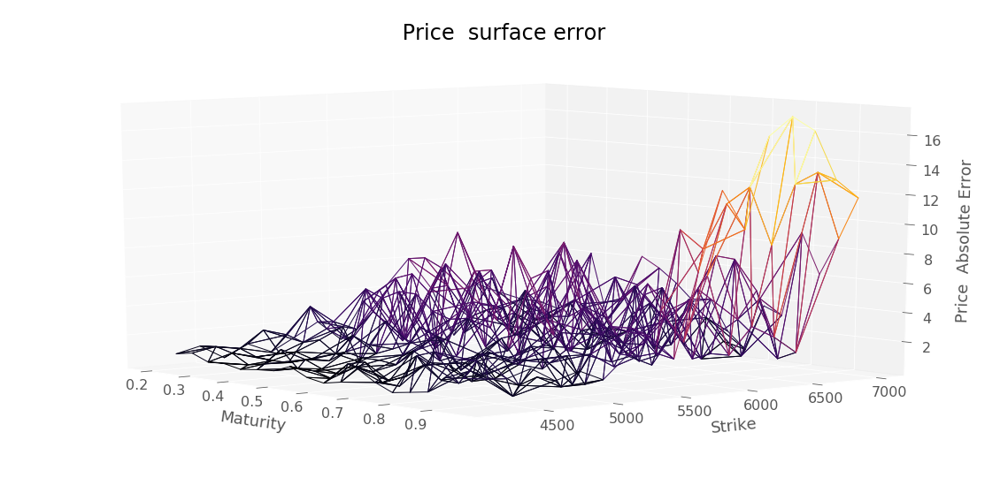

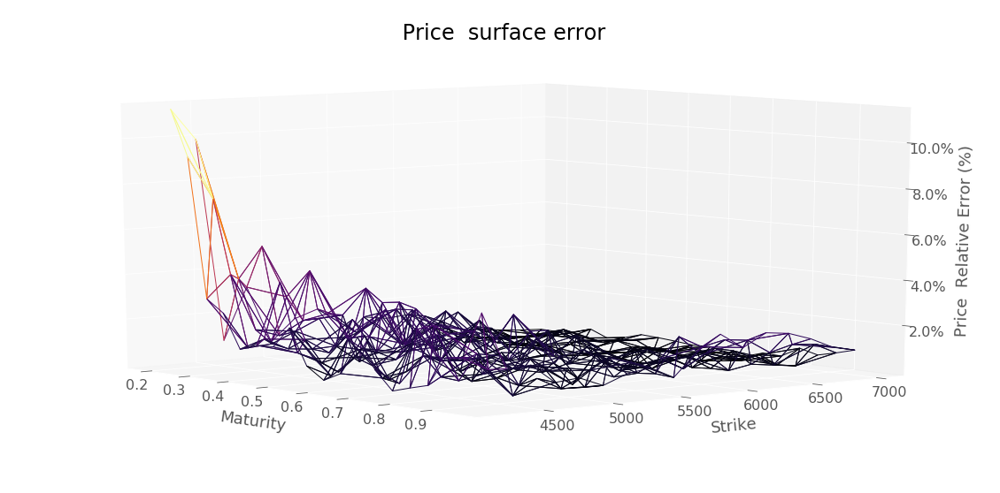

RMSE :  3.8324321900622547


In [162]:
predictionDiagnosis(mcResTikhonovTest, dataSetTest["Price"], " Price ", yMin=4100)

In [163]:
mcResTikhonovTest.to_csv(workingFolder + "mcResTikhonovTest.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


In [164]:
mcResTikhonovTrain = MonteCarloPricerVectorized(S0[0],
                                                dataSet,
                                                riskCurvespline,
                                                divSpline,
                                                nbPaths,
                                                nbTimeStep,
                                                nnVolLocaleTykhonov)
mcResTikhonovTrain.head()

Strike  Maturity
3600    0.118        0.082917
        0.367        4.409346
        0.597       15.692240
        0.866       31.837894
3800    0.118        0.379482
dtype: float64

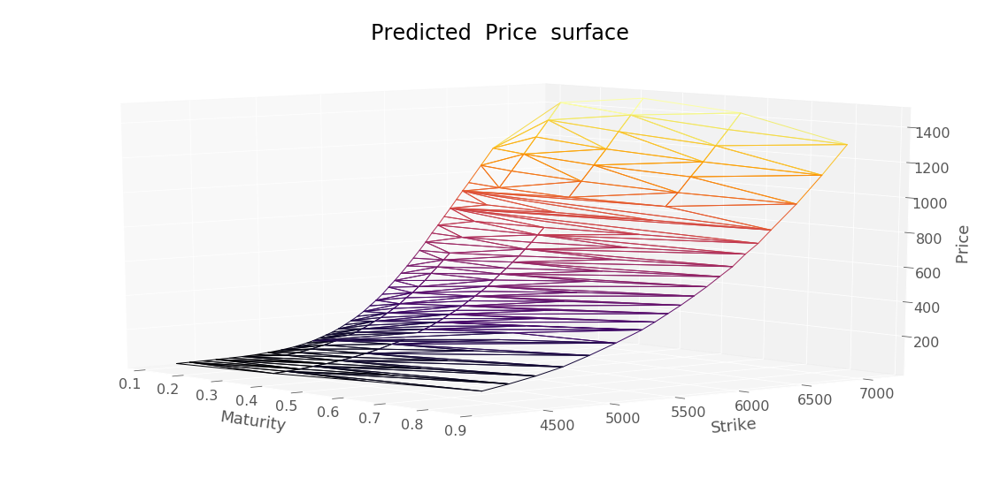

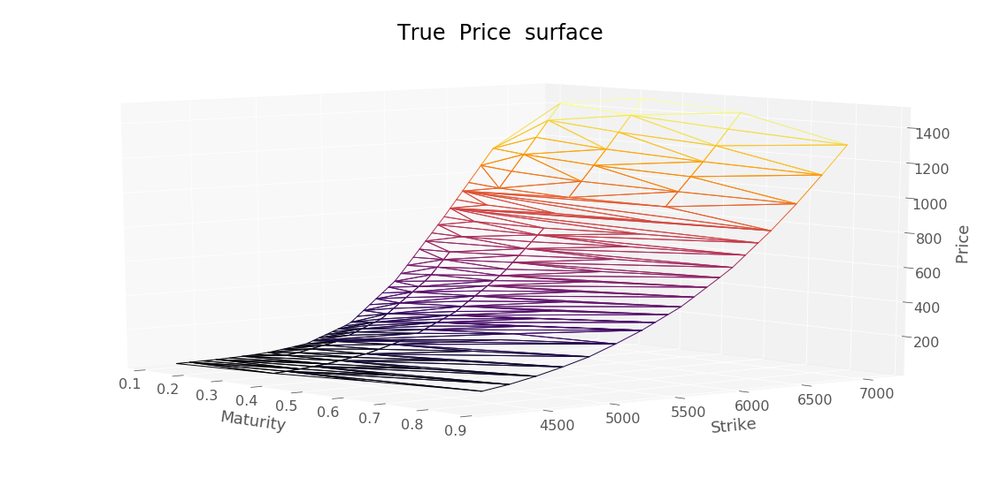

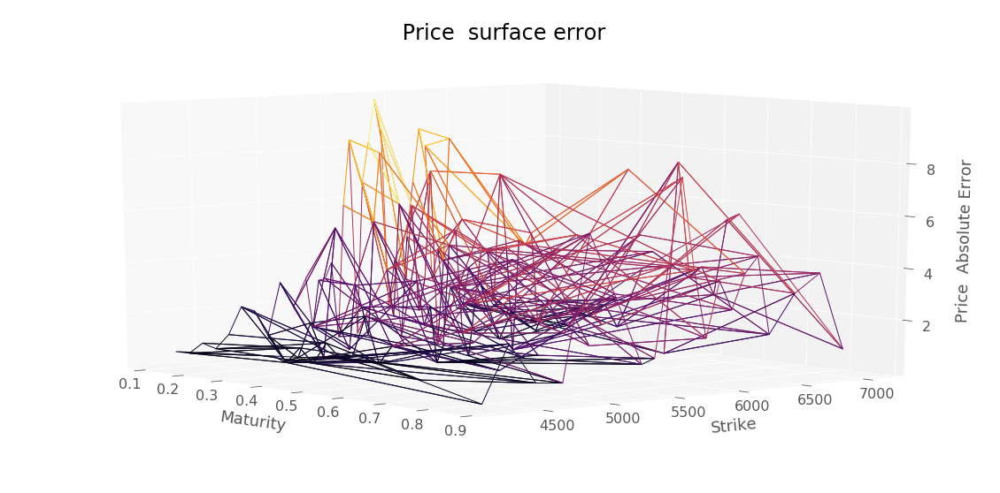

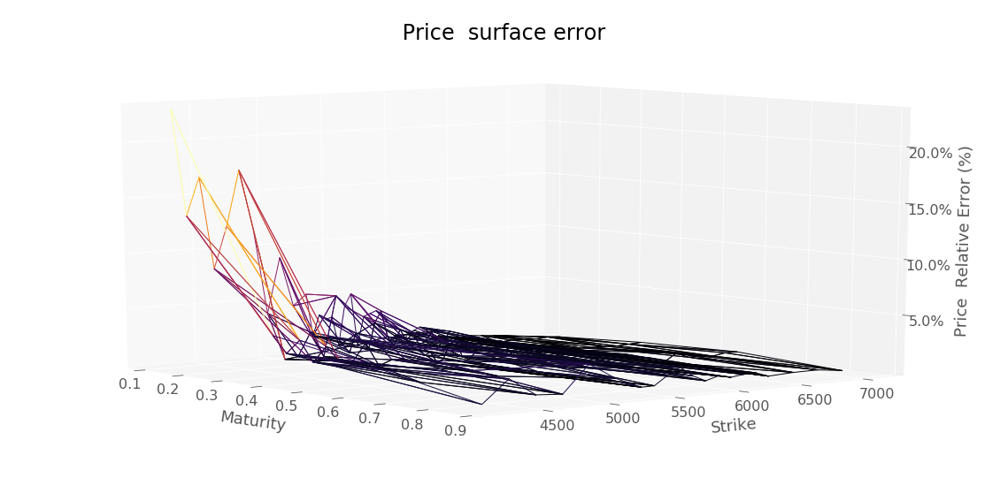

RMSE :  3.453829289537717


In [165]:
predictionDiagnosis(mcResTikhonovTrain, dataSet["Price"], " Price ", yMin=4100)

In [166]:
mcResTikhonovTrain.to_csv(workingFolder + "mcResTikhonovTrain.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


#### Backtest Local volatility SSVI 

In [167]:
nnSSVI = lambda x,y : interpolatedMCLocalVolatility(locVolSSVIDf["LocalVolatility"], x, y)

In [168]:
mcResSSVITest = MonteCarloPricerVectorized(S0[0],
                                           dataSetTest,
                                           riskCurvespline,
                                           divSpline,
                                           nbPaths,
                                           nbTimeStep,
                                           nnSSVI)
mcResSSVITest.head()

Strike  Maturity
3858.6  0.200       1.432815
        0.242       3.088774
        0.284       4.874297
        0.326       7.060682
        0.368       9.520613
dtype: float64

In [169]:
mcResSSVITest.to_csv(workingFolder + "mcResSSVITest.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


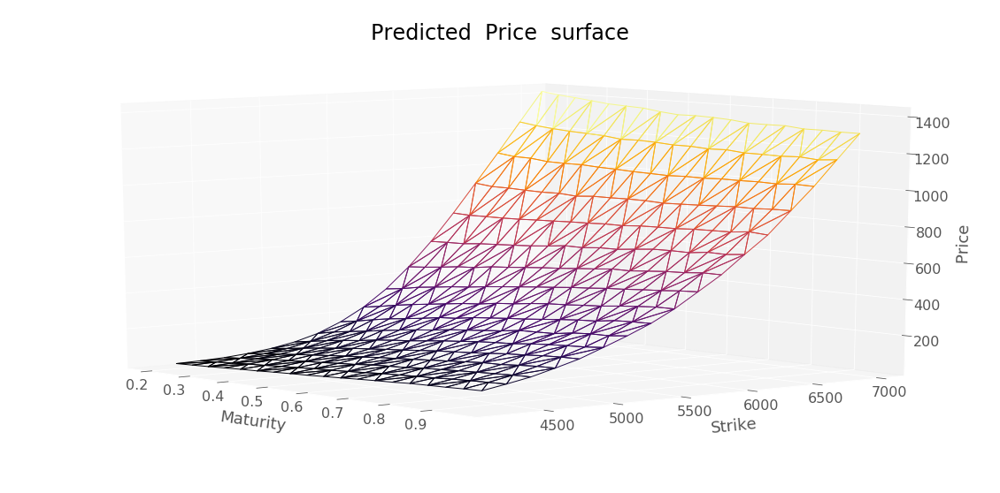

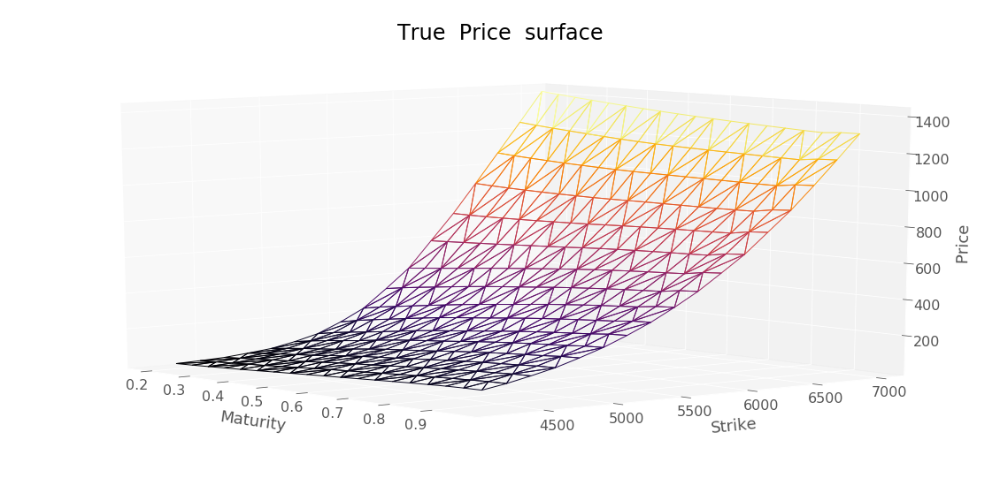

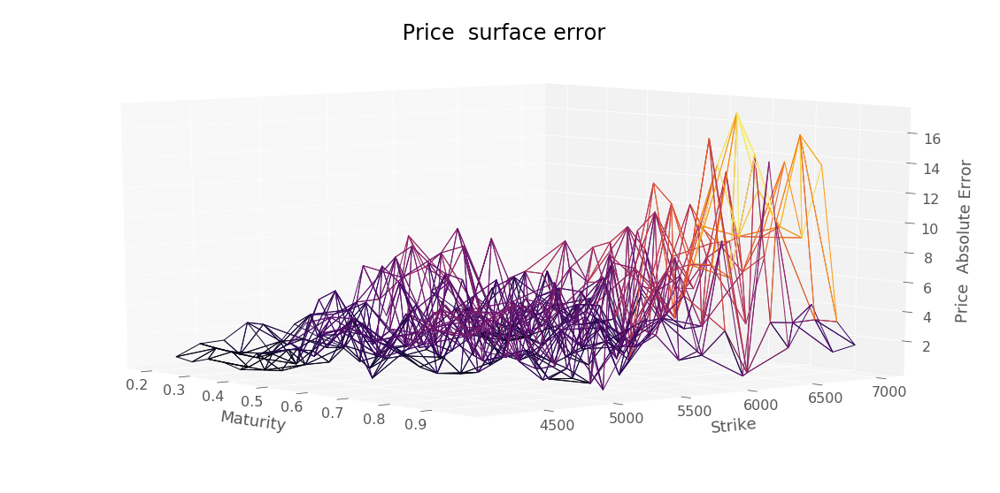

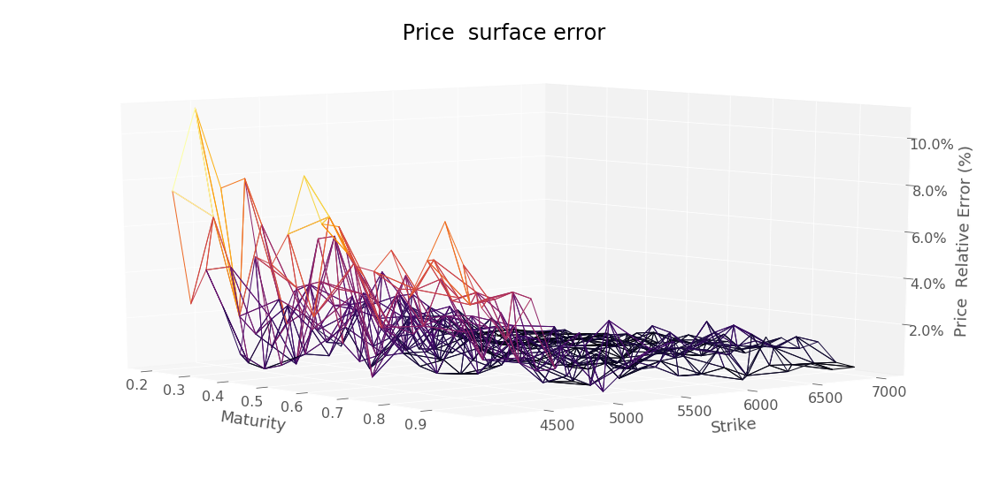

RMSE :  4.6979472395486646


In [170]:
predictionDiagnosis(mcResSSVITest, dataSetTest["Price"], " Price ", yMin=4100)

In [171]:
mcResSSVITrain = MonteCarloPricerVectorized(S0[0],
                                            dataSet,
                                            riskCurvespline,
                                            divSpline,
                                            nbPaths,
                                            nbTimeStep,
                                            nnSSVI)
mcResSSVITrain.head()

Strike  Maturity
3600    0.118        0.012602
        0.367        4.162408
        0.597       13.618083
        0.866       27.709671
3800    0.118        0.072215
dtype: float64

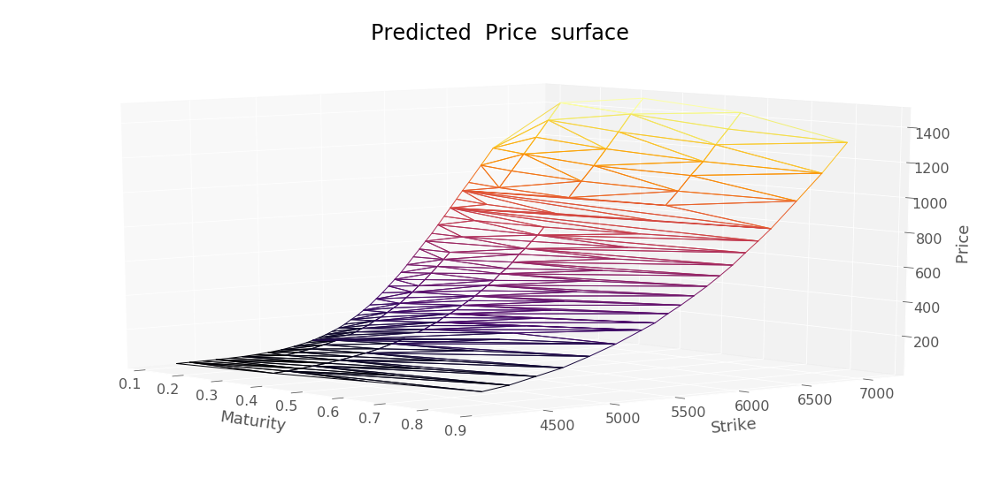

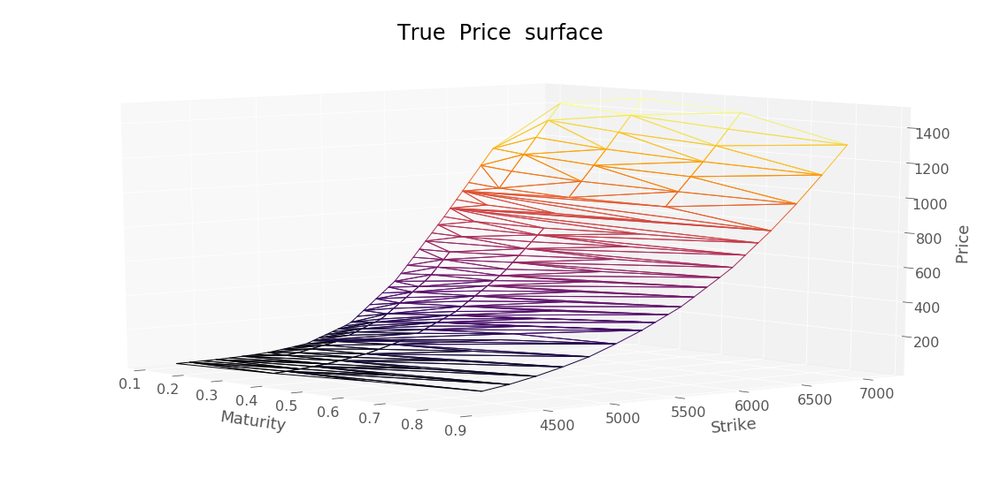

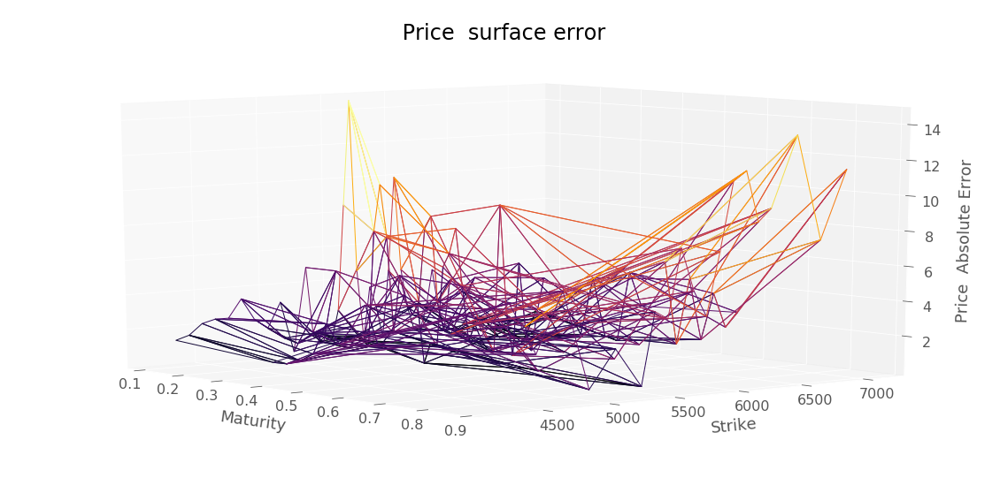

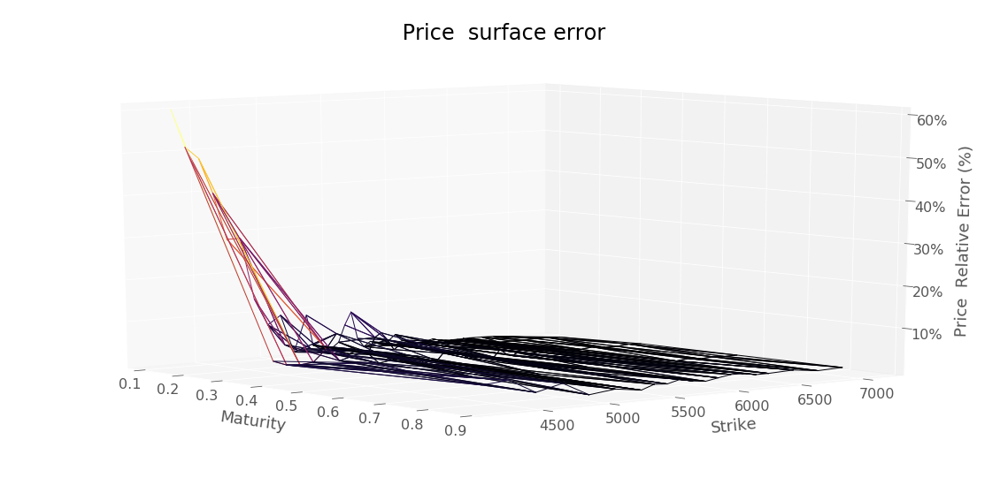

RMSE :  4.167889673178091


In [172]:
predictionDiagnosis(mcResSSVITrain, dataSet["Price"], " Price ", yMin=4100)

In [173]:
mcResSSVITrain.to_csv(workingFolder + "mcResSSVITrain.csv")

/home/chataigner/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  """Entry point for launching an IPython kernel.


In [174]:
testingDataSetSSVI = interpolatedLocalVolatility(locVolSSVIDf, testingDataSet["Price"])

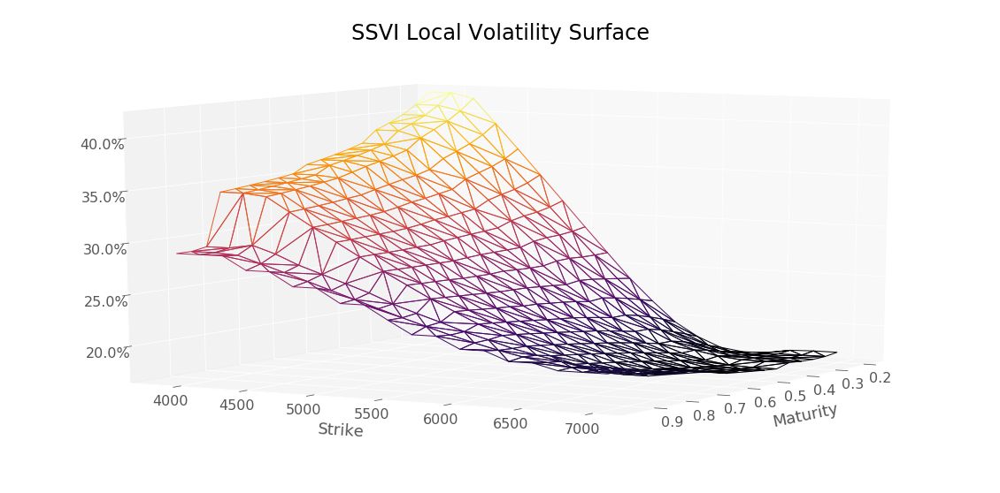

In [175]:
plotSerie(testingDataSetSSVI[testingDataSetSSVI.index.get_level_values("Maturity") > 0.01],
          Title = 'SSVI Local Volatility Surface',
          az=30,
          yMin=0.0*S0,
          yMax=2.0*S0, 
          zAsPercent=True)